# ML - Это база)

# Часть 1: Концептуальное понимание

## ML в широком контексте


#### История ML: от "если бы перфокарты умели мечтать" до ChatGPT


#### Краткая история ML: эволюция обучающихся машин

1950-е: Первые нейронные сети. Фрэнк Розенблатт создает перцептрон. Компьютеры размером с комнату учатся распознавать простейшие образы. Примерно как если бы ваш холодильник научился отличать яблоко от банана, заняв при этом всю вашу квартиру.

1960-1970-е: Первая "зима ИИ". Выяснилось, что перцептроны не могут решить XOR-задачу. Мировое сообщество: "Похоже, эти ваши нейросети - пустая трата времени". Спойлер: они ошибались.

1980-е: Возрождение интереса. Алгоритм обратного распространения ошибки. Системы, основанные на правилах (экспертные системы). Эпоха "А что, если мы запрограммируем ВСЕ правила вручную?"

1990-2000-е: Статистические методы. Вторая "зима ИИ". SVM, случайные леса, бустинг. Машинное обучение становится инструментом в руках статистиков, а не только энтузиастов ИИ.

2010-е: Глубокое обучение. AlexNet (2012), DeepMind, GANs. Внезапно нейросети заработали... и как! Примерно как если бы ваш старый автомобиль внезапно научился летать.

2020+: Большие языковые модели, трансформеры. GPT, BERT, DALL-E. Модели, которые, кажется, понимают человеческий язык и могут генерировать осмысленный контент. "Может, они и правда понимают, о чем говорят? Или просто очень хорошо притворяются?" 

-пссс парень, текст выше написан GPT

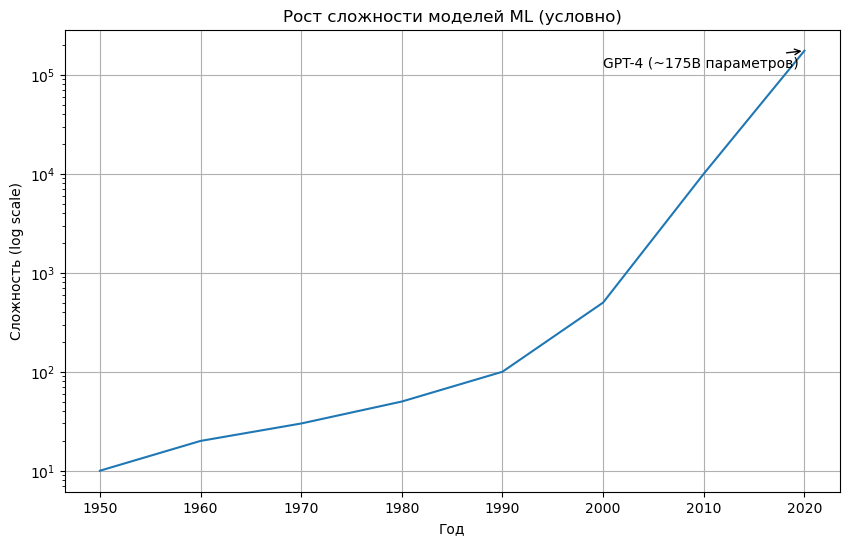

In [3]:
# Визуализация роста сложности моделей
years = [1950, 1960, 1970, 1980, 1990, 2000, 2010, 2020]
model_complexity = [10, 20, 30, 50, 100, 500, 10000, 175000]

plt.figure(figsize=(10, 6))
plt.plot(years, model_complexity)
plt.yscale('log')
plt.title('Рост сложности моделей ML (условно)')
plt.xlabel('Год')
plt.ylabel('Сложность (log scale)')
plt.grid(True)
plt.annotate('GPT-4 (~175B параметров)', 
             xy=(2020, 175000), 
             xytext=(2000, 120000),
             arrowprops=dict(arrowstyle='->'))
plt.show()

#### Традиционное программирование vs ML


Традиционное программирование:

    Вы пишете правила, компьютер следует им
    "Если клиент потратил больше 10,000₽, дайте ему скидку 5%"
    Вы — эксперт, вы знаете все правила заранее
    Проблема: мир слишком сложен, правил слишком много
Машинное обучение: 

    Вы показываете примеры, компьютер выводит правила сам
    "Вот 10,000 клиентов, некоторые вернулись для повторных покупок, некоторые — нет. Найди закономерность."
    Вы — скорее тренер, чем программист
    Новая проблема: правила работают, но вы не всегда понимаете, почему

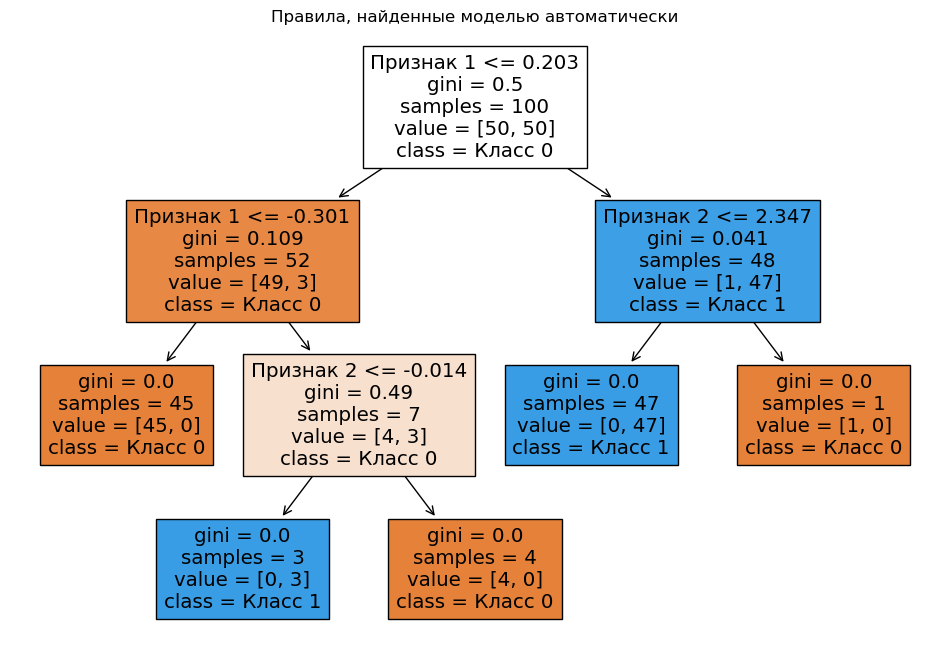

Традиционное программирование: ВЫ пишете все эти правила
Машинное обучение: Компьютер находит правила сам, на основе данных


In [142]:
# Простая иллюстрация разницы
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.datasets import make_classification

# Создаем синтетические данные
X, y = make_classification(n_samples=100, n_features=2, n_informative=2, 
                          n_redundant=0, random_state=42)

# Обучаем простое дерево решений
clf = DecisionTreeClassifier(max_depth=3, random_state=42)
clf.fit(X, y)

# Визуализируем дерево решений (правила, которые нашла модель)
plt.figure(figsize=(12, 8))
plot_tree(clf, filled=True, feature_names=['Признак 1', 'Признак 2'], 
          class_names=['Класс 0', 'Класс 1'])
plt.title('Правила, найденные моделью автоматически')
plt.show()

print("Традиционное программирование: ВЫ пишете все эти правила")
print("Машинное обучение: Компьютер находит правила сам, на основе данных")

### Виды ML с аналогиями "на пальцах"

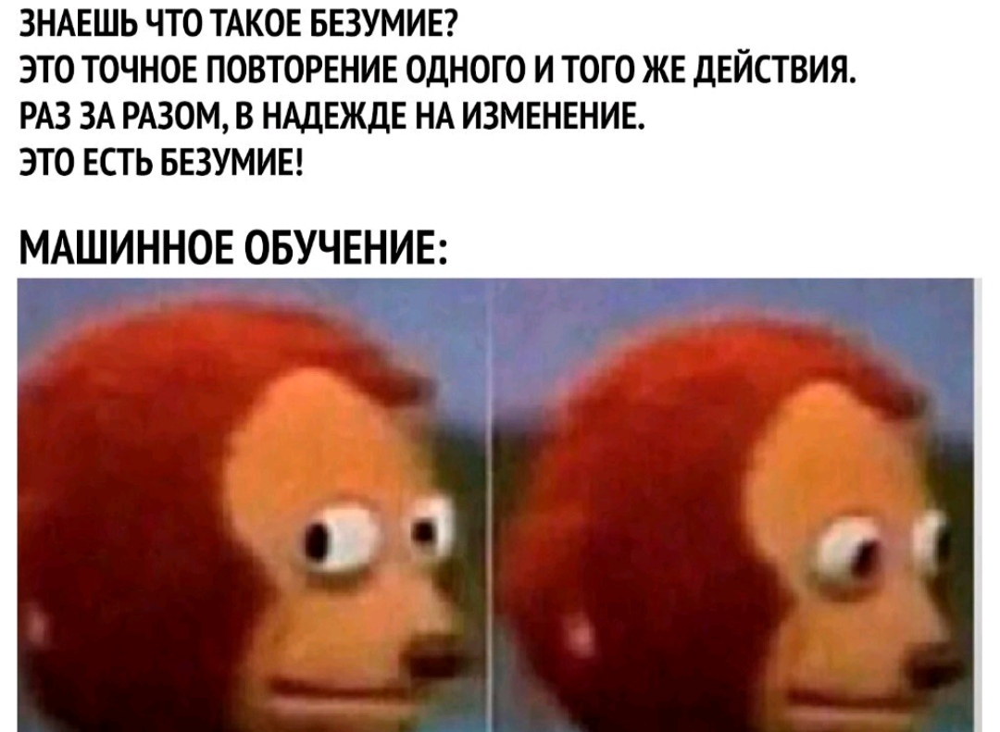

Цель машинного обучения — предсказать результат по входным данным. Чем разнообразнее входные данные, тем проще машине найти закономерности и тем точнее результат.


Итак, если мы хотим обучить машину, нам нужны три вещи:


###### Данные 
Хотим определять спам — нужны примеры спам-писем, предсказывать курс акций — нужна история цен, узнать интересы пользователя — нужны его лайки или посты. Данных нужно как можно больше. Десятки тысяч примеров — это самый злой минимум для отчаянных.

###### Признаки
Мы называем их фичами (features), так что ненавистникам англицизмов придётся страдать. Фичи, свойства, характеристики, признаки — ими могут быть пробег автомобиля, пол пользователя, цена акций, даже счетчик частоты появления слова в тексте может быть фичей.



Машина должна знать, на что ей конкретно смотреть. Хорошо, когда данные просто лежат в табличках — названия их колонок и есть фичи. А если у нас сто гигабайт картинок с котами? Когда признаков много, модель работает медленно и неэффективно. Зачастую отбор правильных фич занимает больше времени, чем всё остальное обучение. Но бывают и обратные ситуации, когда кожаный мешок сам решает отобрать только «правильные» на его взгляд признаки и вносит в модель субъективность — она начинает дико врать.



###### Алгоритм
Одну задачу можно решить разными методами примерно всегда. От выбора метода зависит точность, скорость работы и размер готовой модели. Но есть один нюанс: если данные ###### , даже самый лучший алгоритм не поможет. Не зацикливайтесь на процентах, лучше соберите побольше данных.



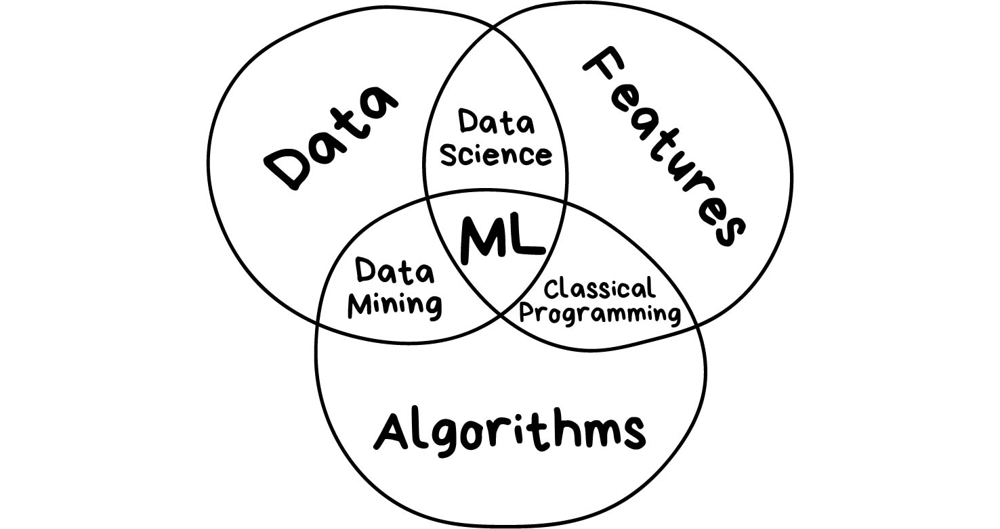

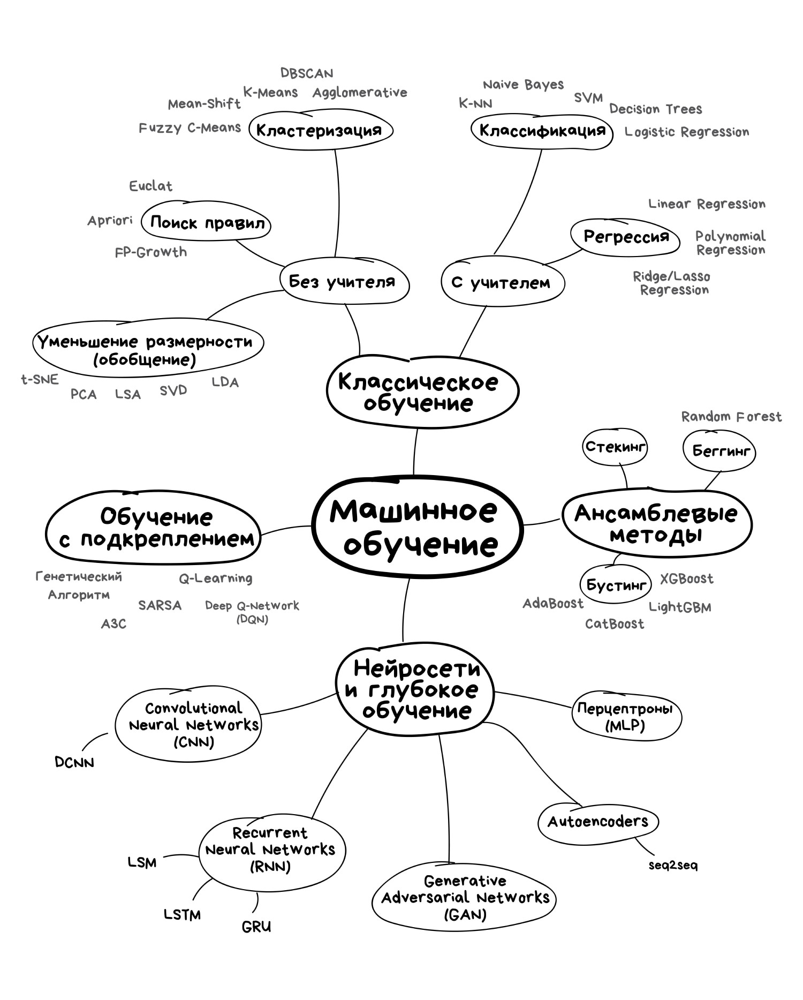

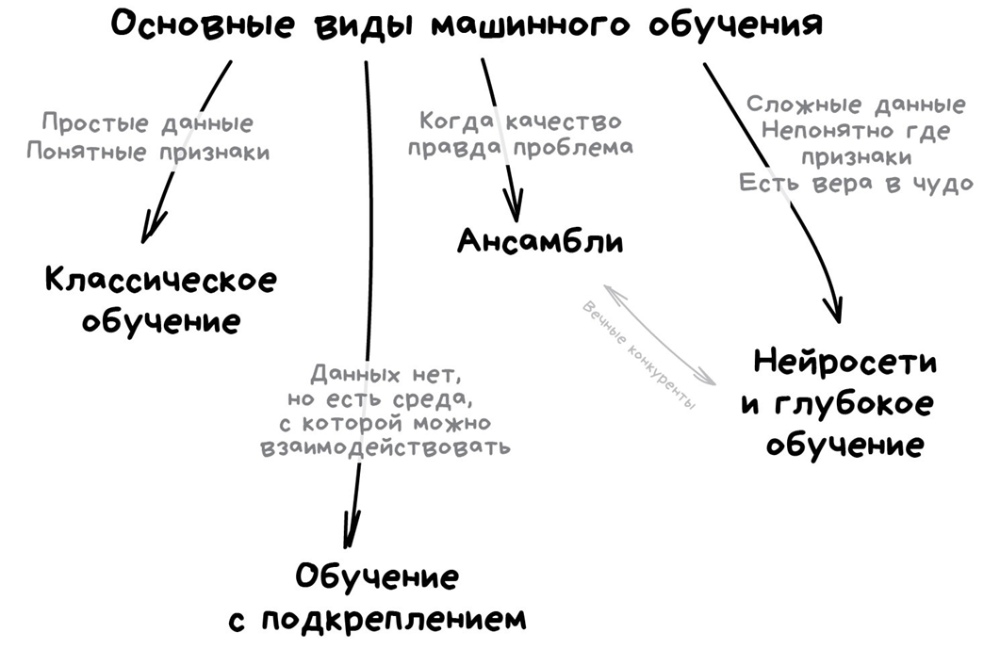

Первые алгоритмы пришли к нам из чистой статистики еще в 1950-х. Они решали формальные задачи — искали закономерности в циферках, оценивали близость точек в пространстве и вычисляли направления.


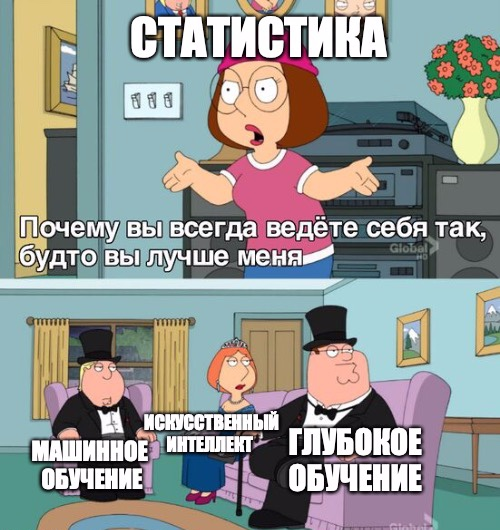

Сегодня на классических алгоритмах держится добрая половина интернета. Когда вы встречаете блок «Рекомендованные статьи» на сайте, или банк блокирует все ваши деньги на карточке после первой же покупки кофе за границей — это почти всегда дело рук одного из этих алгоритмов.


Да, крупные корпорации любят решать все проблемы нейросетями. Потому что лишние 2% точности для них легко конвертируются в дополнительные 2 миллиарда прибыли. Остальным же стоит включать голову. Когда задача решаема классическими методами, дешевле реализовать сколько-нибудь полезную для бизнеса систему на них, а потом думать об улучшениях. А если вы не решили задачу, то не решить её на 2% лучше вам не особо поможет.

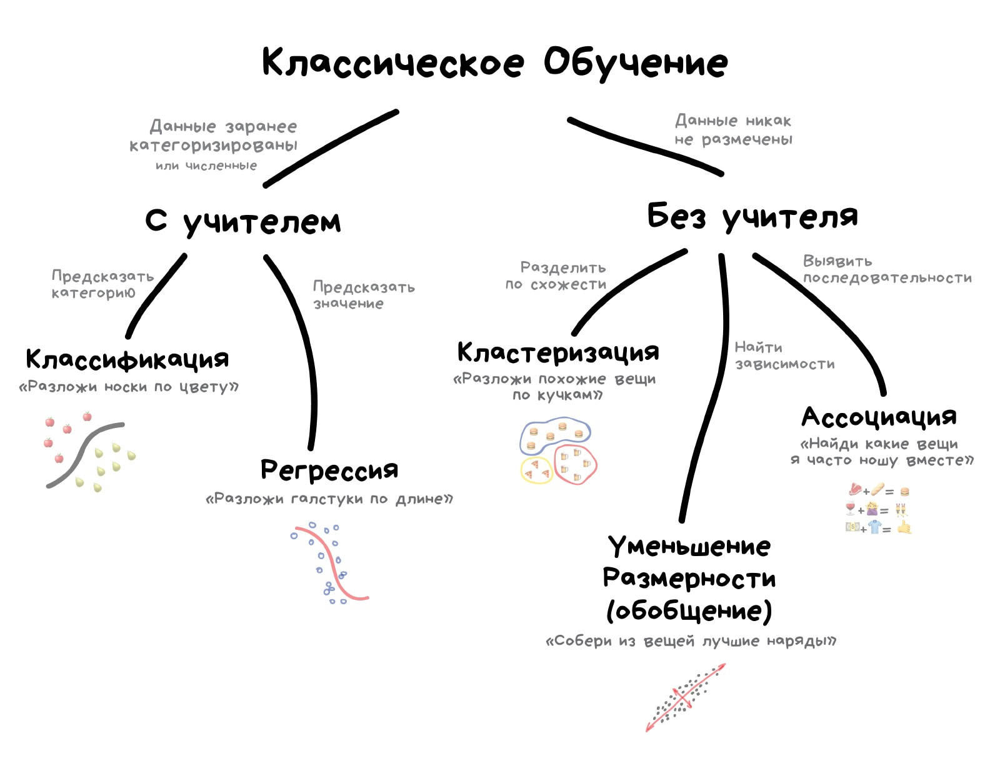

Классическое обучение любят делить на две категории — с учителем и без. Часто можно встретить их английские наименования — Supervised и Unsupervised Learning.


В первом случае у машины есть некий учитель, который говорит ей как правильно. Рассказывает, что на этой картинке кошка, а на этой собака. То есть учитель уже заранее разделил (разметил) все данные на кошек и собак, а машина учится на конкретных примерах.



В обучении без учителя, машине просто вываливают кучу фотографий животных на стол и говорят «разберись, кто здесь на кого похож». Данные не размечены, у машины нет учителя, и она пытается сама найти любые закономерности. Об этих методах поговорим ниже.



Очевидно, что с учителем машина обучится быстрее и точнее, потому в боевых задачах его используют намного чаще.

Задачи обучения делятся на два типа: классификация — предсказание категории объекта, и регрессия — предсказание значения непрерывной величины.


Классификация — самая популярная задача во всём машинном обучении. Классифицировать можно что угодно: производственные данные по траекториям производства, тип структуры по результату рентген анализа, фрактографические снимки по вязкости излома.


Регрессия — метод МО сутью которого является минимизация разницы между модельной зависимостью от входных данных на обучающей выборке.


Классификация вещей — самая популярная задача во всём машинном обучении. Машина в ней как ребёнок, который учится раскладывать игрушки: роботов в один ящик, танки в другой. Опа, а если это робот-танк? Штош, время расплакаться и выпасть в ошибку.



    Спам-фильтры
    Определение языка
    Поиск похожих документов
    Анализ тональности
    Распознавание рукописных букв и цифр
    Определение подозрительных транзакций

Для классификации всегда нужен учитель — размеченные данные с признаками и категориями, которые машина будет учиться определять по этим признакам. Дальше классифицировать можно что угодно: пользователей по интересам — так делают алгоритмические ленты, статьи по языкам и тематикам — важно для поисковиков, музыку по жанрам — вспомните плейлисты Спотифая и Яндекс.Музыки, даже письма в вашем почтовом ящике.

Раньше все спам-фильтры работали на алгоритме Наивного Байеса. Машина считала сколько раз слово «виагра» встречается в спаме, а сколько раз в нормальных письмах. Перемножала эти две вероятности по формуле Байеса, складывала результаты всех слов и бац, всем лежать, у нас машинное обучение!



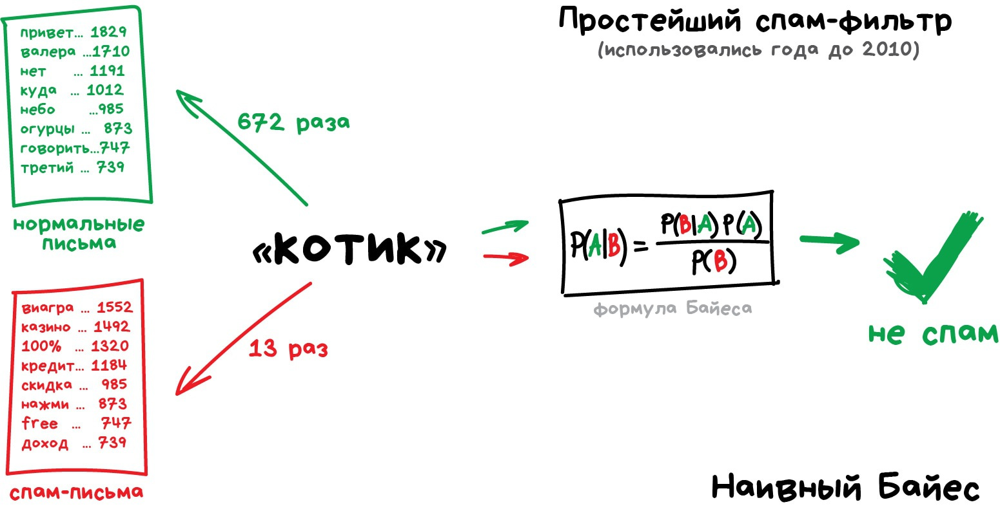

Позже спамеры научились обходить фильтр Байеса, просто вставляя в конец письма много слов с «хорошими» рейтингами. Метод получил ироничное название Отравление Байеса, а фильтровать спам стали другими алгоритмами. Но метод навсегда остался в учебниках как самый простой, красивый и один из первых практически полезных.



Возьмем другой пример полезной классификации. Вот берёте вы кредит в банке. Как банку удостовериться, вернёте вы его или нет? Точно никак, но у банка есть тысячи профилей других людей, которые уже брали кредит до вас. Там указан их возраст, образование, должность, уровень зарплаты и главное — кто из них вернул кредит, а с кем возникли проблемы.



Да, все догадались, где здесь данные и какой надо предсказать результат. Обучим машину, найдём закономерности, получим ответ — вопрос не в этом. Проблема в том, что банк не может слепо доверять ответу машины, без объяснений. Вдруг сбой, злые хакеры или бухой админ решил скриптик исправить.

Для этой задачи придумали Деревья Решений. Машина автоматически разделяет все данные по вопросам, ответы на которые «да» или «нет». Вопросы могут быть не совсем адекватными с точки зрения человека, например «зарплата заёмщика больше, чем 25934 рубля?», но машина придумывает их так, чтобы на каждом шаге разбиение было самым точным.

Деревья нашли свою нишу в областях с высокой ответственностью: диагностике, медицине, финансах.



В чистом виде деревья сегодня используют редко, но вот их ансамбли (о которых будет через пару занятий) лежат в основе крупных систем и зачастую уделывают даже нейросети. Например, когда вы задаете вопрос Яндексу, именно толпа глупых деревьев бежит ранжировать вам результаты.

Но самым популярным методом классической классификации заслуженно является Метод Опорных Векторов (SVM). Им классифицировали уже всё: виды растений, лица на фотографиях, документы по тематикам, даже странных Playboy-моделей. Много лет он был главным ответом на вопрос «какой бы мне взять классификатор».

Идея SVM по своей сути проста — он ищет, как так провести две прямые между категориями, чтобы между ними образовался наибольший зазор. На картинке видно нагляднее:

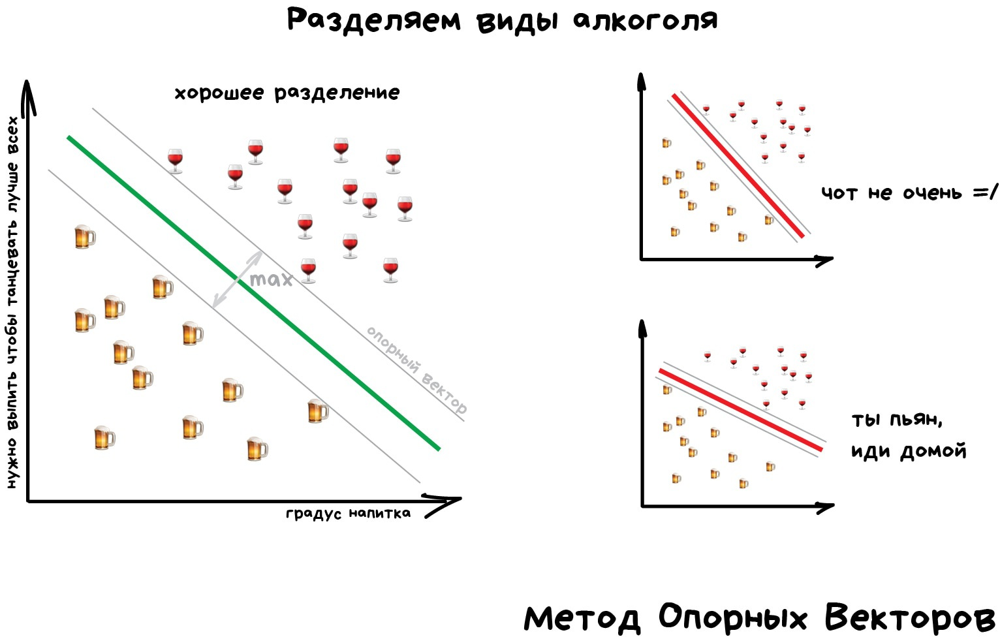

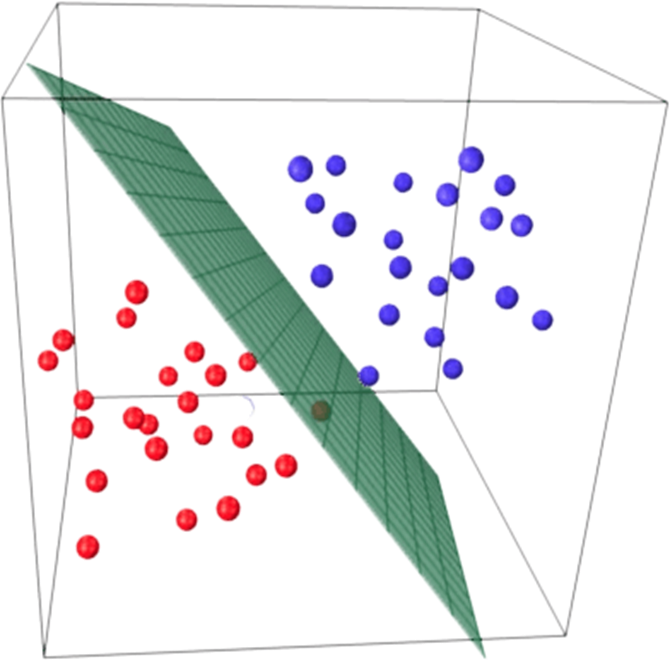

1. Обучение с учителем (Supervised Learning)
Что это: Учим модель на размеченных данных (X → y)

Аналогия: Как учить ребенка с учебником, где все задачи имеют ответы в конце. "Это — кошка, это — собака. А теперь скажи, кто это?"

Примеры:

    Классификация: Спам-фильтр, распознавание лиц
    Регрессия: Предсказание цен на жилье, прогноз продаж

## Обучение без учителя

Обучение без учителя (Unsupervised Learning) было изобретено позже, аж в 90-е, и на практике используется реже. Но бывают задачи, где у нас просто нет выбора.



Размеченные данные, как я сказал, дорогая редкость. Но что делать если я хочу, например, написать классификатор автобусов — идти на улицу руками фотографировать миллион  икарусов и подписывать где какой? Так и жизнь вся пройдёт, а у меня еще "Вставь чем увлекаешься"



Когда нет разметки, есть надежда на капитализм, социальное расслоение и миллион китайцев из сервисов типа Яндекс.Толока, которые готовы делать для вас что угодно за пять центов. Так обычно и поступают на практике. А вы думали где Яндекс берёт все свои крутые датасеты?



Либо, можно попробовать обучение без учителя. Хотя, честно говоря, из своей практики я не помню чтобы где-то оно сработало хорошо.



###### Кластеризация 

Кластеризация — это классификация, но без заранее известных классов. Она сама ищет похожие объекты и объединяет их в кластеры. Количество кластеров можно задать заранее или доверить это машине. Похожесть объектов машина определяет по тем признакам, которые мы ей разметили — у кого много схожих характеристик, тех давай в один класс.




Отличный пример кластеризации — маркеры на картах в вебе. Когда вы ищете все крафтовые бары в Москве, движку приходится группировать их в кружочки с циферкой, иначе браузер зависнет в потугах нарисовать миллион маркеров.



Более сложные примеры кластеризации можно вспомнить в приложениях iPhoto или Google Photos, которые находят лица людей на фотографиях и группируют их в альбомы. Приложение не знает как зовут ваших друзей, но может отличить их по характерным чертам лица. Типичная кластеризация.



Правда для начала им приходится найти эти самые «характерные черты», а это уже только с учителем.



Сжатие изображений — еще одна популярная проблема. Сохраняя картинку в PNG, вы можете установить палитру, скажем, в 32 цвета. Тогда кластеризация найдёт все «примерно красные» пиксели изображения, высчитает из них «средний красный по больнице» и заменит все красные на него. Меньше цветов — меньше файл.



Проблема только, как быть с цветами типа Cyan ◼︎ — вот он ближе к зеленому или синему? Тут нам поможет популярный алгоритм кластеризации — Метод К-средних (K-Means).

Мы случайным образом бросаем на палитру цветов наши 32 точки, обзывая их центроидами. Все остальные точки относим к ближайшему центроиду от них — получаются как бы созвездия из самых близких цветов. Затем двигаем центроид в центр своего созвездия и повторяем пока центроиды не перестанут двигаться. Кластеры обнаружены, стабильны и их ровно 32 как и надо было.

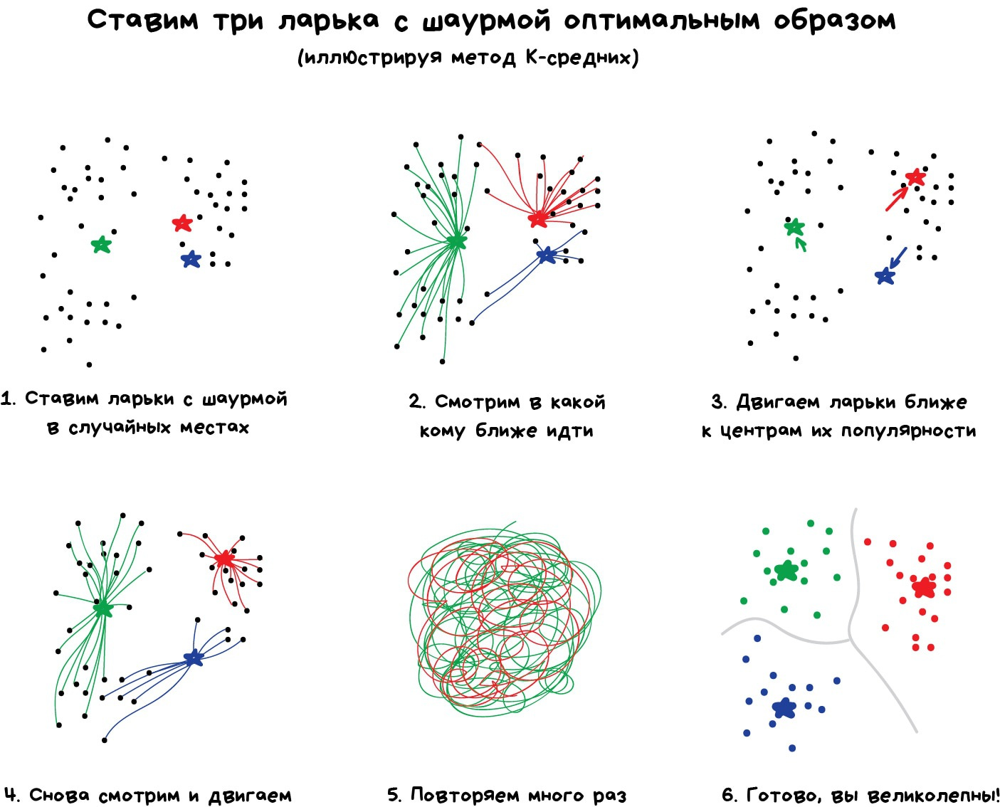

Искать центроиды удобно и просто, но в реальных задачах кластеры могут быть совсем не круглой формы. Вот вы геолог, которому нужно найти на карте схожие по структуре горные породы — ваши кластеры не только будут вложены друг в друга, но вы ещё и не знаете сколько их вообще получится.



Хитрым задачам — хитрые методы. DBSCAN, например. Он сам находит скопления точек и строит вокруг кластеры. Его легко понять, если представить, что точки — это люди на площади. Находим трёх любых близко стоящих человека и говорим им взяться за руки. Затем они начинают брать за руку тех, до кого могут дотянуться. Так по цепочке, пока никто больше не сможет взять кого-то за руку — это и будет первый кластер. Повторяем, пока не поделим всех. Те, кому вообще некого брать за руку — это выбросы, аномалии. В динамике выглядит довольно красиво:



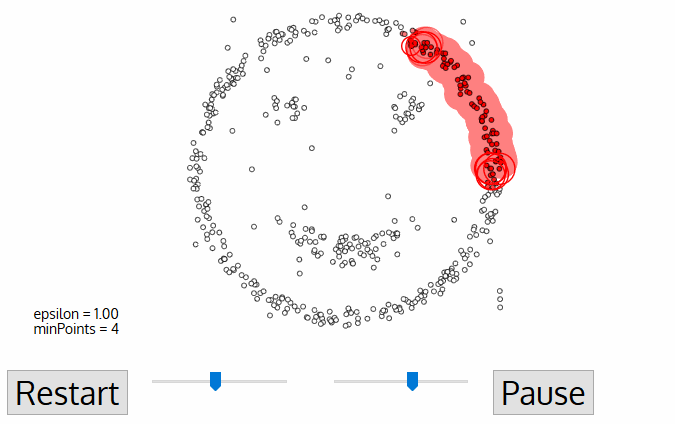

https://towardsdatascience.com/the-5-clustering-algorithms-data-scientists-need-to-know-a36d136ef68

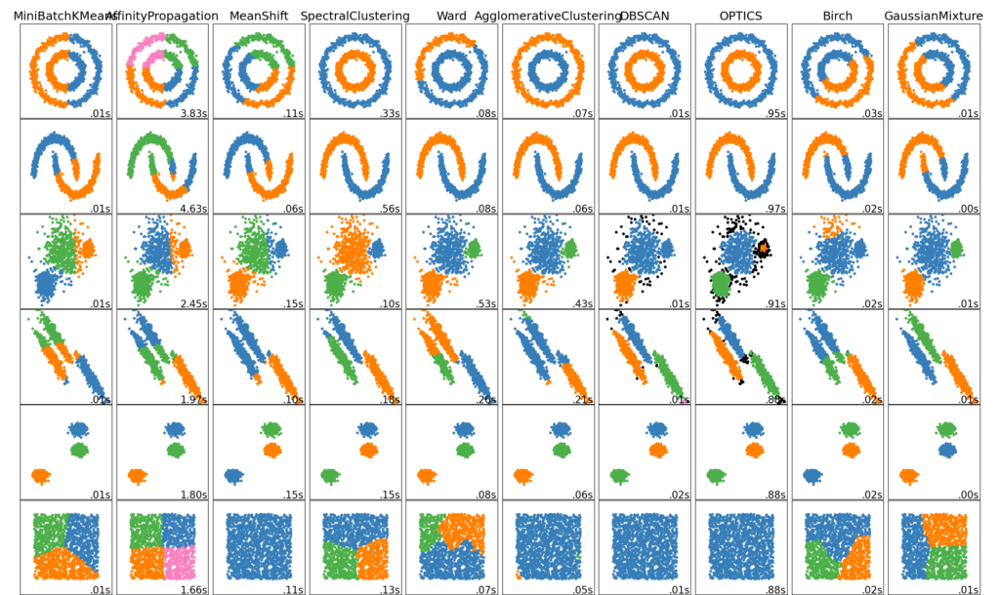

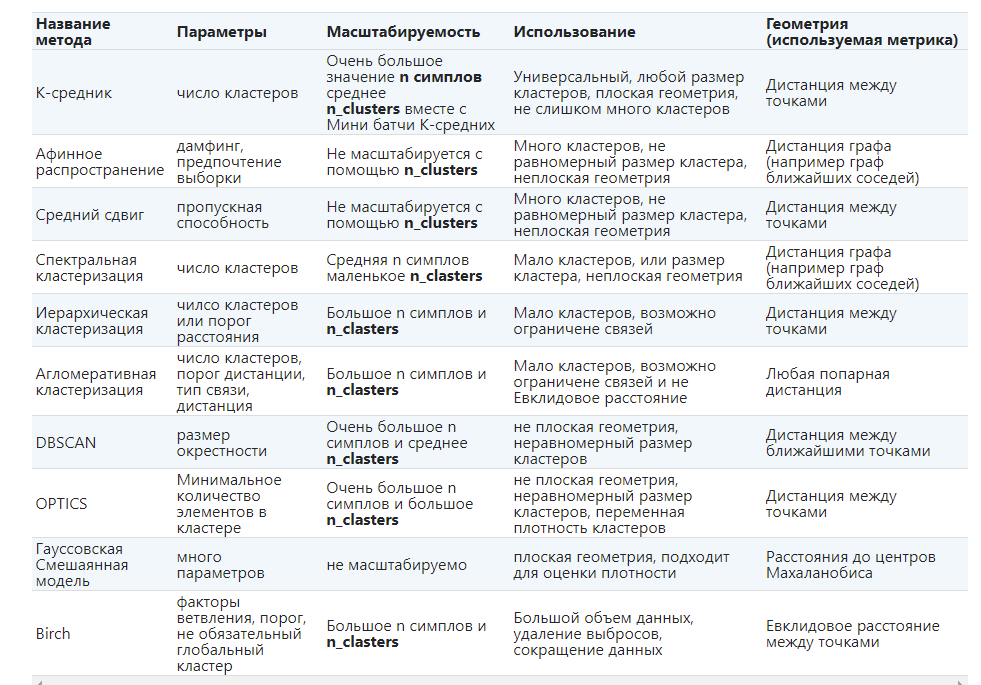

### Обучение с подкреплением (Reinforcement Learning)
Обучение с подкреплением — это  подросток, которого родители выпустили в большой мир с минимумом инструкций: "Иди и пробуй. Когда сделаешь что-то правильно — почувствуешь. Когда ошибешься — тоже узнаешь."

Reinforcement Learning — самый молодой из троицы, начал активно развиваться в 2010-х. Здесь нет ни правильных ответов (как в обучении с учителем), ни запутанных кластеров (как в обучении без). Есть только среда и агент, который с ней взаимодействует.



Представьте, что вы учите робота играть в шахматы. Вы не говорите ему: "Вот так надо ходить в 10 типовых ситуациях" (это был бы Supervised). Вместо этого вы задаете правила: "Когда выиграешь — получишь +100 очков, когда проиграешь — минус 100, а каждый ход стоит -1 очко, чтобы ты не тормозил." И робот сам начинает экспериментировать.



Сначала он ходит наугад как пьяный гроссмейстер. Ставит мат себе на втором ходу (что? -100 очков?!). Потом понимает, что терять фигуры невыгодно. Потом — что некоторые фигуры ценнее других. Через миллион партий он уже играет на уровне чемпиона мира, и никто не понимает, как он принимает решения, включая его создателей.



AlphaGo, победившая чемпиона мира по го — яркий пример. В одной из партий программа сделала ход № 37, который комментаторы назвали "инопланетным" — ни один человек не сыграл бы так. А ход оказался гениальным.



Среди других примеров:

Беспилотные автомобили, учащиеся лавировать в городском потоке
Роботы Boston Dynamics, встающие после падения
Торговые боты, зарабатывающие на бирже

Но у этого типа обучения есть серьезный недостаток: ему требуется невероятное количество попыток. Для обучения в игре Dota 2 бот OpenAI сыграл эквивалент 45,000 лет человеческого опыта. Если бы мы так учили водить реальную машину, нам бы понадобилось разбить несколько тысяч автомобилей, прежде чем алгоритм понял бы, что это плохо. Поэтому для обучения часто используют симуляторы.

Популярные алгоритмы включают Q-Learning, DQN, PPO и SAC. Если простыми словами: они все пытаются понять, какие действия в каких ситуациях приносят наибольшую пользу в долгосрочной перспективе. Примерно как человек, который делает много глупостей, но учится на своих ошибках. И не просто учится, а вычисляет оптимальную стратегию жизни.



## Посмотрим как это выгядит на питоне

/opt/conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


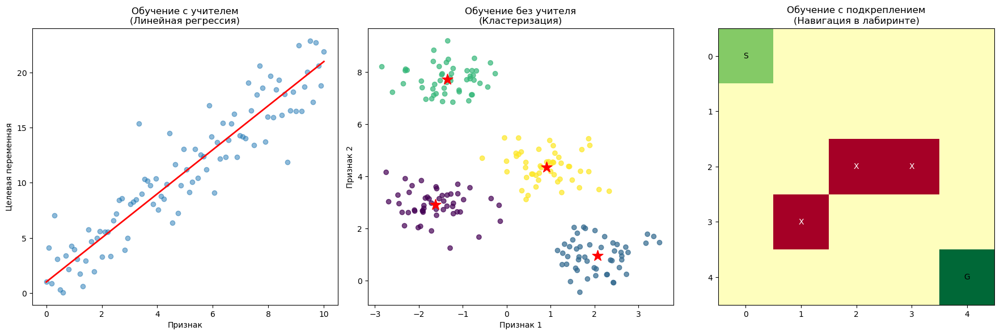

In [5]:
# Визуализация примеров для каждого типа
fig, axes = plt.subplots(1, 3, figsize=(18, 6))

# Supervised Learning - Linear Regression
x = np.linspace(0, 10, 100)
y = 2*x + 1 + np.random.normal(0, 2, 100)
axes[0].scatter(x, y, alpha=0.5)
axes[0].plot(x, 2*x + 1, 'r', linewidth=2)
axes[0].set_title('Обучение с учителем\n(Линейная регрессия)')
axes[0].set_xlabel('Признак')
axes[0].set_ylabel('Целевая переменная')

# Unsupervised Learning - Clustering
from sklearn.datasets import make_blobs
X, _ = make_blobs(n_samples=200, centers=4, cluster_std=0.60, random_state=0)
from sklearn.cluster import KMeans
kmeans = KMeans(n_clusters=4, random_state=0).fit(X)
axes[1].scatter(X[:, 0], X[:, 1], c=kmeans.labels_, cmap='viridis', alpha=0.7)
axes[1].scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], 
               marker='*', s=200, c='red', label='Центроиды')
axes[1].set_title('Обучение без учителя\n(Кластеризация)')
axes[1].set_xlabel('Признак 1')
axes[1].set_ylabel('Признак 2')

# Reinforcement Learning - Simple Maze
maze = np.zeros((5, 5))
maze[0, 0] = 0.5  # Start
maze[4, 4] = 1.0  # Goal
maze[2, 2:4] = -1  # Obstacle
maze[3, 1] = -1  # Obstacle

axes[2].imshow(maze, cmap='RdYlGn')
axes[2].set_title('Обучение с подкреплением\n(Навигация в лабиринте)')
axes[2].text(0, 0, 'S', ha='center', va='center', color='black')
axes[2].text(4, 4, 'G', ha='center', va='center', color='black')
for i in range(5):
    for j in range(5):
        if maze[i, j] == -1:
            axes[2].text(j, i, 'X', ha='center', va='center', color='white')

plt.tight_layout()
plt.show()


1) Левый график (обучение с учителем):
Создает искусственные данные, соответствующие уравнению прямой y = 2x + 1 + шум
Разбрасывает точки вокруг этой прямой (синие точки)
Рисует истинную линию без шума (красная линия)
Демонстрирует суть регрессии: по облаку точек модель находит тренд
2) Центральный график (обучение без учителя):
Генерирует 200 точек, образующих 4 естественных скопления
Применяет алгоритм K-means для их автоматической группировки
Раскрашивает точки по найденным кластерам разными цветами
Отмечает красными звездами центры кластеров (центроиды)
3) Правый график (обучение с подкреплением):
Создает простой лабиринт в виде матрицы 5×5
Старт (S) в верхнем левом углу, цель (G) в нижнем правом
Препятствия (X) в центре и внизу слева
Цветовая схема: зеленый - хорошо, красный - плохо, жёлтый - нейтрально
Иллюстрирует пространство, где агент должен найти оптимальный путь

# Единая абстракция ML

Модель как "чёрный ящик с настройками"

В этом подблоке мы перейдем от классификации типов ML к универсальному представлению всех алгоритмов машинного обучения. Независимо от того, работаем ли мы с нейросетями, деревьями решений или случайными лесами, все они следуют одной и той же абстрактной модели.



Если раздеть любой алгоритм машинного обучения (метафорически, конечно), то увидим одно и то же



y = f(X, θ)



где:

    X — входные данные (признаки)
    θ — параметры модели (которые мы настраиваем)
    y — выход (предсказание)
    f — какая-то хитрая функция преобразования

Линейная регрессия: y = θ₀ + θ₁x₁ + θ₂x₂ + ... + θₙxₙ



Логистическая регрессия: y = 1/(1+e^(-(θ₀ + θ₁x₁ + θ₂x₂ + ... + θₙxₙ)))



Нейросеть: y = слой_N(... слой_2(слой_1(X, θ₁), θ₂)..., θₙ)



###### Обучение модели — это процесс поиска оптимальных θ, чтобы модель делала как можно более точные предсказания.

Моя работа — просто подбирать правильные гиперпараметры, чтобы sklearn.magic() работал лучше." 

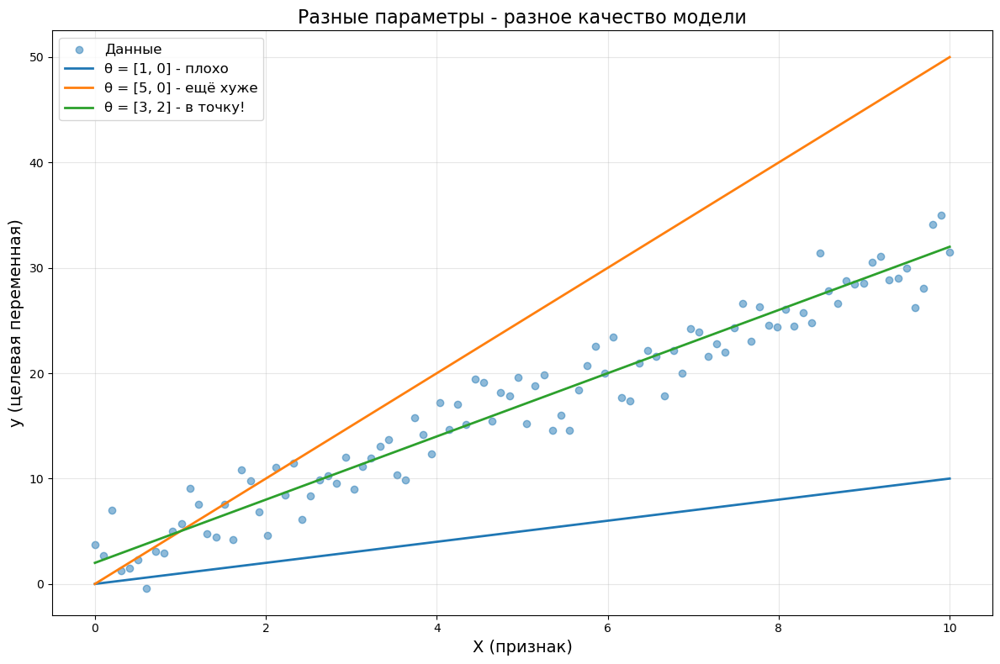

In [11]:
# Демонстрация: меняем параметры линейной регрессии
X = np.linspace(0, 10, 100).reshape(-1, 1)
y_true = 3 * X.squeeze() + 2 + np.random.normal(0, 2, 100)

fig, ax = plt.subplots(figsize=(12, 8))
ax.scatter(X, y_true, alpha=0.5, label='Данные')

# Показываем разные версии моделей с разными параметрами
models = [
    {'slope': 1, 'intercept': 0, 'label': 'θ = [1, 0] - плохо'},
    {'slope': 5, 'intercept': 0, 'label': 'θ = [5, 0] - ещё хуже'},
    {'slope': 3, 'intercept': 2, 'label': 'θ = [3, 2] - в точку!'}
]

for i, model in enumerate(models):
    y_pred = model['slope'] * X.squeeze() + model['intercept']
    ax.plot(X, y_pred, linewidth=2, label=model['label'])

ax.set_title('Разные параметры - разное качество модели', fontsize=16)
ax.set_xlabel('X (признак)', fontsize=14)
ax.set_ylabel('y (целевая переменная)', fontsize=14)
ax.legend(fontsize=12)
ax.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

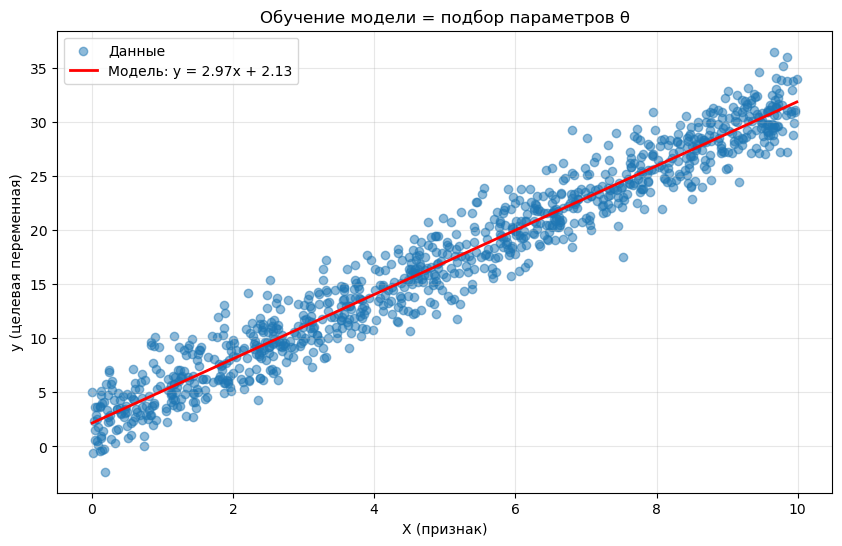

Истинные параметры: θ = [3, 2]
Найденные параметры: θ = [2.97, 2.13]


In [157]:
# Простая визуализация процесса обучения
from sklearn.linear_model import LinearRegression

# Создаем простые данные
X = np.random.rand(1000, 1) * 10
y = 3 * X.squeeze() + 2 + np.random.normal(0, 2, 1000)

# Обучаем модель
model = LinearRegression()
model.fit(X, y)

# Визуализация
plt.figure(figsize=(10, 6))
plt.scatter(X, y, alpha=0.5, label='Данные')
plt.plot(np.sort(X, axis=0), model.predict(np.sort(X, axis=0)), 'r', 
         linewidth=2, label=f'Модель: y = {model.coef_[0]:.2f}x + {model.intercept_:.2f}')
plt.title('Обучение модели = подбор параметров θ')
plt.xlabel('X (признак)')
plt.ylabel('y (целевая переменная)')
plt.legend()
plt.grid(True, alpha=0.3)
plt.show()

print(f"Истинные параметры: θ = [3, 2]")
print(f"Найденные параметры: θ = [{model.coef_[0]:.2f}, {model.intercept_:.2f}]")

##### Каждый алгоритм ML говорит на одном языке


Помните, как в фильмах хакеры печатают зелёные буквы на чёрном экране, и всё магически работает? В машинном обучении всё почти так же просто! (Спойлер: на самом деле нет)

### Три волшебных заклинания ML:



In [25]:
# 1. Создаем модель
model = SuperPuperAlgorithm(magic_level=9000)

# 2. Обучаем на данных
model.fit(X_train, y_train)

# 3. Делаем предсказания
predictions = model.predict(X_test)

NameError: name 'SuperPuperAlgorithm' is not defined

##### Что происходит, когда вы вызываете fit():

    Модель смотрит на ваши данные и думает: "Так-так, что бы это значило?"
    Происходит оптимизация параметров θ, чтобы минимизировать ошибку
    Внутри модели крутятся миллионы циклов градиентного спуска или других алгоритмов
    Модель потеет, страдает, но в итоге находит какое-то решение
    И всё это в одной строчке кода!

##### Что происходит при predict():
    Модель берёт новые данные и применяет уже настроенную функцию
    "Дайте подумать... если подставить ваши признаки в мою формулу... получится вот это!"
    Вся магия в том, что модель выдаёт ответы для данных, которых никогда не видела

##### А дальше оценка - насколько всё плохо (или хорошо): 



In [ ]:
accuracy = some_metric(y_true, predictions)
print(f"Насколько хороша модель: {accuracy:.2%}")
# Вывод типа: "Насколько хороша модель: 87.53%"

Шаг 0: Данные готовы
Обучающая выборка: 140 примеров
Тестовая выборка: 60 примеров

Первые 5 примеров обучающей выборки:


,Признак 1,Признак 2,Целевая переменная
0,4.741738,0.978342,21.588825
1,3.390298,3.492096,19.905801
2,8.287375,3.567533,37.461292
3,4.560700,7.851760,36.701841
4,7.722448,1.987157,31.714762



Шаг 1: Создали модель (LinearRegression)
Начальные параметры: {'copy_X': True, 'fit_intercept': True, 'n_jobs': None, 'positive': False}

Шаг 2: Запускаем обучение (model.fit)...
Обучение завершено!
Найденные коэффициенты: [3.03062726 1.97729615]
Найденное смещение: 5.049186079584505
Математическая формула модели: y = 3.03*x₁ + 1.98*x₂ + 5.05

Шаг 3: Делаем предсказания на тестовых данных (model.predict)...

Сравнение предсказаний с реальностью (первые 5 примеров):


,Фактическое значение,Предсказание модели,Ошибка
0,26.766276,25.611397,1.154879
1,27.893519,26.833373,1.060146
2,21.145223,22.193920,-1.048697
3,17.704093,20.869567,-3.165475
4,42.870355,47.183118,-4.312763



Шаг 4: Оцениваем качество модели...
Среднеквадратичная ошибка (MSE): 5.76
Коэффициент детерминации (R²): 0.94
Интерпретация: модель объясняет 94.5% вариации в данных
Вердикт: Модель неплохо справляется!


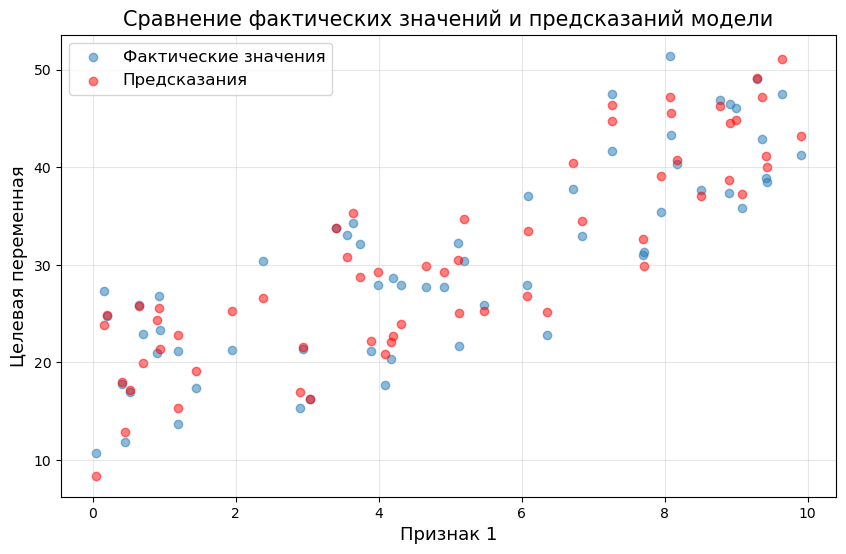

In [26]:
# Полная демонстрация процесса обучения на реальном примере
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score
import pandas as pd

# Создаем простой датасет
np.random.seed(42)
n_samples = 200
X = np.random.rand(n_samples, 2) * 10  # Два признака
y = 3*X[:, 0] + 2*X[:, 1] + 5 + np.random.normal(0, 2, n_samples)  # Линейная зависимость с шумом

# Разбиваем на обучающую и тестовую выборки
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

print("Шаг 0: Данные готовы")
print(f"Обучающая выборка: {X_train.shape[0]} примеров")
print(f"Тестовая выборка: {X_test.shape[0]} примеров")
print("\nПервые 5 примеров обучающей выборки:")
display(pd.DataFrame(
    np.column_stack([X_train[:5], y_train[:5]]), 
    columns=['Признак 1', 'Признак 2', 'Целевая переменная']
))

# Шаг 1: Создаем модель
model = LinearRegression()
print("\nШаг 1: Создали модель (LinearRegression)")
print(f"Начальные параметры: {model.get_params()}")

# Шаг 2: Обучаем модель
print("\nШаг 2: Запускаем обучение (model.fit)...")
model.fit(X_train, y_train)
print("Обучение завершено!")
print(f"Найденные коэффициенты: {model.coef_}")
print(f"Найденное смещение: {model.intercept_}")
print(f"Математическая формула модели: y = {model.coef_[0]:.2f}*x₁ + {model.coef_[1]:.2f}*x₂ + {model.intercept_:.2f}")

# Шаг 3: Делаем предсказания
print("\nШаг 3: Делаем предсказания на тестовых данных (model.predict)...")
y_pred = model.predict(X_test)

# Отображаем первые 5 предсказаний и фактические значения
comparison = pd.DataFrame({
    'Фактическое значение': y_test[:5],
    'Предсказание модели': y_pred[:5],
    'Ошибка': y_test[:5] - y_pred[:5]
})
print("\nСравнение предсказаний с реальностью (первые 5 примеров):")
display(comparison)

# Шаг 4: Оцениваем качество модели
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print("\nШаг 4: Оцениваем качество модели...")
print(f"Среднеквадратичная ошибка (MSE): {mse:.2f}")
print(f"Коэффициент детерминации (R²): {r2:.2f}")
print(f"Интерпретация: модель объясняет {r2:.1%} вариации в данных")

if r2 > 0.7:
    print("Вердикт: Модель неплохо справляется!")
else:
    print("Вердикт: Нужно искать более сложную модель или улучшать данные")

# Визуализация предсказаний (для 1 признака, чтобы можно было отобразить на 2D графике)
plt.figure(figsize=(10, 6))
plt.scatter(X_test[:, 0], y_test, alpha=0.5, label='Фактические значения')
plt.scatter(X_test[:, 0], y_pred, color='r', alpha=0.5, label='Предсказания')
plt.title('Сравнение фактических значений и предсказаний модели', fontsize=15)
plt.xlabel('Признак 1', fontsize=13)
plt.ylabel('Целевая переменная', fontsize=13)
plt.legend(fontsize=12)
plt.grid(alpha=0.3)
plt.show()

#### От ML-абстракции к практическим сценариям


В любом фреймворке для ML (scikit-learn, TensorFlow, PyTorch) вы найдёте этот паттерн:



    Инициализация модели: Выбор алгоритма и настройка гиперпараметров
    Обучение: model.fit(X, y) - "съешь эти данные и найди закономерности"
    Предсказание: model.predict(X_new) - "а теперь скажи, что думаешь об этом"
    Оценка: Сравнение предсказаний с реальностью по какой-то метрике

Дополнительные методы в реальной жизни:

    model.score() - быстрая оценка модели на данных
    model.transform() - подготовка данных (в пайплайнах)
    model.get_params() / model.set_params() - настройка на ходу

Все алгоритмы ML - это просто разные варианты функции f в уравнении y = f(X, θ). Меняются только:

    Какие параметры θ настраиваются
    Как именно вычисляется f
    Какой метод оптимизации используется для поиска θ

Но принцип всегда один: "подбери параметры, чтобы предсказания были максимально близки к реальности". 



# Данные → Модель → Предсказание → Метрика → Оптимизация

## Данные

Данные - это новая нефть... только в отличие от нефти, сырыми они не дают нам ничего полезного.



##### Чем хороши данные:

    В мире их всё больше: от соцсетей до IoT-устройств
    Могут рассказать то, что мы сами не замечаем
    Бывают структурированными (таблицы), полуструктурированными (JSON) и неструктурированными (тексты, видео)

##### Чем плохи данные:
    80% из них - мусор или почти мусор
    Реальные данные всегда грязные: пропуски, дубликаты, ошибки
    Данные обычно собирали не для вас, а для какой-то другой цели
    Данных одновременно и слишком много, и слишком мало


##### Типичные проблемы с данными:
    Мусор: "Мусор на входе = мусор на выходе, но с уверенностью 97.8%"
    Смещение: "Наша модель отлично предсказывает продажи мороженого... но только летом"
    Утечка данных: "Модель идеально предсказывает цену акций, если знает, какая она будет завтра"

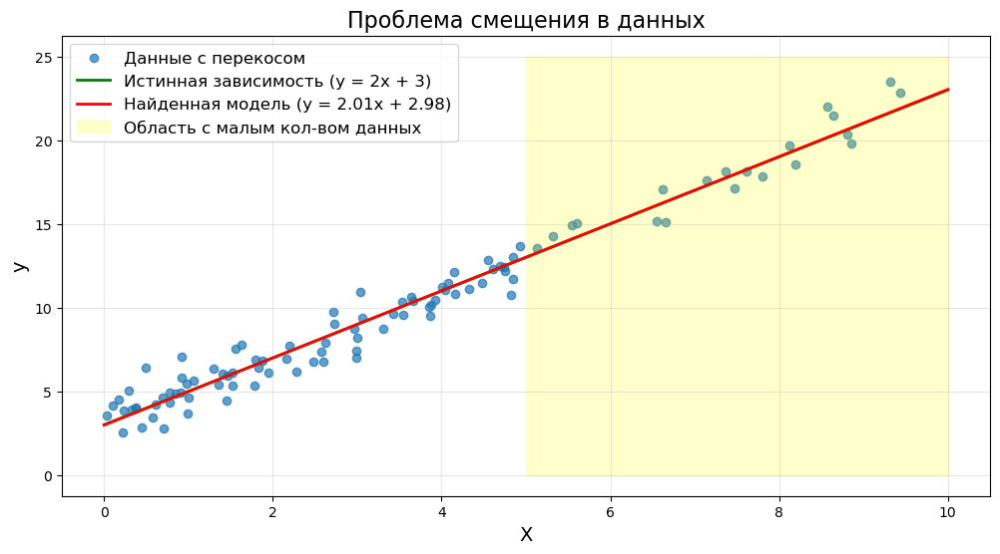

Модель отклонилась от истинной зависимости из-за неравномерного распределения данных


In [22]:
 #Демонстрация проблемы смещения в данных
np.random.seed(42)

# Генерируем данные, где x > 5 имеет намного меньше точек
X_biased = np.concatenate([
    np.random.uniform(0, 5, 80),
    np.random.uniform(5, 10, 20)
]).reshape(-1, 1)

y_biased = 2 * X_biased.squeeze() + 3 + np.random.normal(0, 1, 100)

# Обучаем модель
model = LinearRegression()
model.fit(X_biased, y_biased)

# Визуализируем
plt.figure(figsize=(12, 6))
plt.scatter(X_biased, y_biased, alpha=0.7, label='Данные с перекосом')
plt.plot(
    [0, 10], 
    [3, 2*10+3], 
    'g-', 
    linewidth=2, 
    label='Истинная зависимость (y = 2x + 3)'
)
plt.plot(
    [0, 10], 
    [model.intercept_, model.intercept_ + 10*model.coef_[0]], 
    'r-', 
    linewidth=2, 
    label=f'Найденная модель (y = {model.coef_[0]:.2f}x + {model.intercept_:.2f})'
)
plt.fill_between([5, 10], 0, 25, color='yellow', alpha=0.2, label='Область с малым кол-вом данных')
plt.title('Проблема смещения в данных', fontsize=16)
plt.xlabel('X', fontsize=14)
plt.ylabel('y', fontsize=14)
plt.legend(fontsize=12)
plt.grid(True, alpha=0.3)
plt.show()

print("Модель отклонилась от истинной зависимости из-за неравномерного распределения данных")

## Модель: наша математическая рабочая лошадка

Модель - это математическая функция, которую мы пытаемся сделать похожей на реальность.



##### Спектр сложности моделей:
##### Простые: Линейная регрессия, логистическая регрессия, наивный Байес 
    Быстрые, объяснимые, не требуют много данных
    "Кухонный нож из фикспрайса, изолета, отвертка: не впечатляет, но всегда под рукой и часто достаточно"
##### Средние: Деревья решений, случайные леса, SVM, градиентный бустинг 
    Хороший баланс между сложностью и производительностью
    "Шуруповерт, мультитул, ренноватор: можно сделать многое, и результат обычно неплох"
##### Сложные: Глубокие нейронные сети, трансформеры, ансамбли моделей 
    Способны улавливать сложнейшие зависимости, но требовательны
    "Промышленный ЧПУ станок: делает удивительные вещи, но требует опыта, данных и электричества"


###### Мудрость ML-инженеров: "Начинайте с простого. Не применяйте ядерное оружие для охоты на мух."



###### Компоненты моделей:

###### Параметры: 
Числа, которые модель подбирает сама (веса, коэффициенты)
###### Гиперпараметры:
Настройки, которые задаем мы (глубина дерева, скорость обучения)
###### Интересный факт:
Самые большие языковые модели (например, GPT-4) имеют около 175 млрд параметров. Это как если бы каждый житель Земли настраивал 22 параметра. 

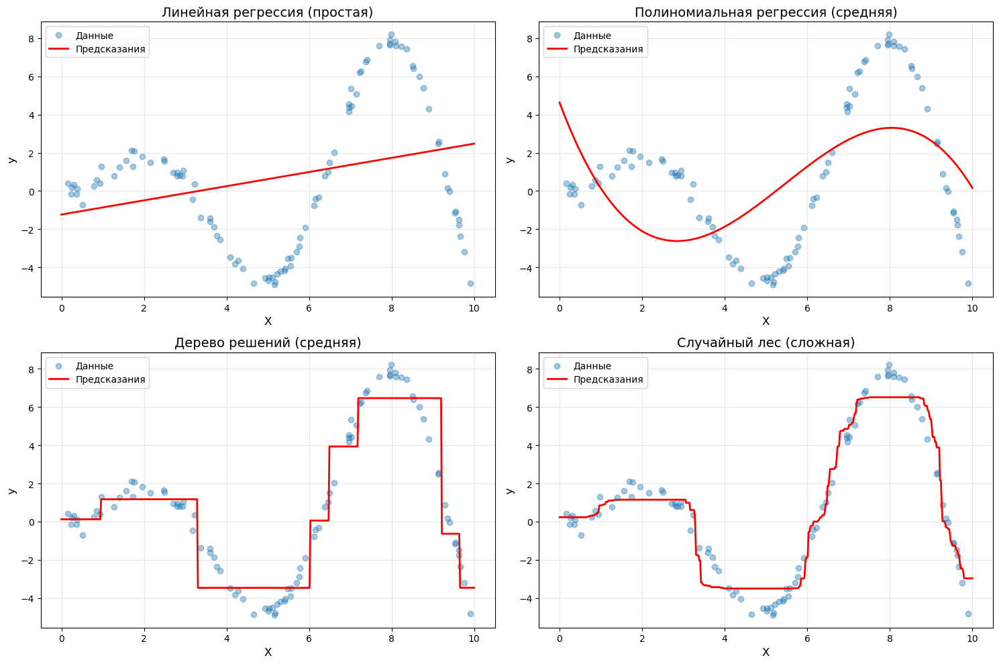

Сравнение моделей разной сложности на одних и тех же данных


In [24]:
# Сравнение разных типов моделей на одних данных
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor

# Создаем сложные нелинейные данные
X = np.sort(np.random.uniform(0, 10, 100)).reshape(-1, 1)
y = np.sin(X.squeeze()) * X.squeeze() + np.random.normal(0, 0.3, 100)

# Подготавливаем модели разной сложности
models = [
    ("Линейная регрессия (простая)", LinearRegression()),
    ("Полиномиальная регрессия (средняя)", make_pipeline(PolynomialFeatures(3), LinearRegression())),
    ("Дерево решений (средняя)", DecisionTreeRegressor(max_depth=3)),
    ("Случайный лес (сложная)", RandomForestRegressor(n_estimators=100, max_depth=3)),
]

# Визуализируем сравнение моделей
plt.figure(figsize=(15, 10))

for i, (name, model) in enumerate(models):
    model.fit(X, y)
    
    # Предсказания для плавной визуализации
    X_test = np.linspace(0, 10, 500).reshape(-1, 1)
    y_pred = model.predict(X_test)
    
    plt.subplot(2, 2, i+1)
    plt.scatter(X, y, alpha=0.4, label='Данные')
    plt.plot(X_test, y_pred, 'r-', linewidth=2, label='Предсказания')
    plt.title(name, fontsize=14)
    plt.xlabel('X', fontsize=12)
    plt.ylabel('y', fontsize=12)
    plt.legend()
    plt.grid(alpha=0.3)

plt.tight_layout()
plt.show()

print("Сравнение моделей разной сложности на одних и тех же данных")

## Предсказание: то, ради чего всё затевалось


Предсказание - это ответ модели на наш вопрос. "Компьютер подумал и сказал..."



###### Типы предсказаний:

    Регрессия: Число (сколько будут стоить акции)
    Классификация: Категория (спам/не спам) или вероятности категорий (70% спам, 30% не спам)
    Кластеризация: Группировка (клиенты сегмента A)
    Генерация: Новый контент (текст, изображение, звук)

###### Интерпретация предсказаний:



    Модель никогда не бывает на 100% уверена (разве что переобучена)
    Предсказание всегда вероятностное, даже когда модель выдает четкий ответ
    Помните: "Все модели неверны, но некоторые полезны" (Джордж Бокс)

###### Практические моменты:

    В регрессии модель может выдавать "невозможные" значения (отрицательный вес человека)
    В классификации модель часто выдает вероятности вместо меток классов
    Для практического использования часто нужно добавить "здравый смысл" поверх предсказаний модели

/opt/conda/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


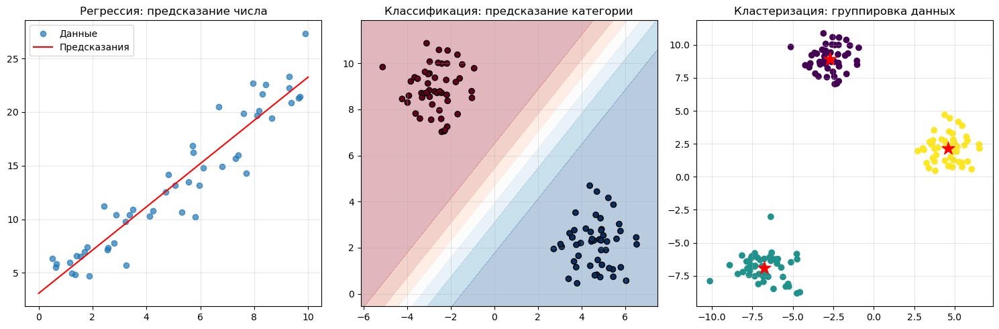

Три типа предсказаний: числа, категории, группировки


In [27]:
# Демонстрация разных типов предсказаний
from sklearn.linear_model import LogisticRegression
from sklearn.cluster import KMeans
from sklearn.datasets import make_blobs

plt.figure(figsize=(15, 5))

# 1. Регрессия (предсказание числа)
ax1 = plt.subplot(1, 3, 1)
X_reg = np.random.uniform(0, 10, 50).reshape(-1, 1)
y_reg = 2 * X_reg.squeeze() + 3 + np.random.normal(0, 2, 50)
model_reg = LinearRegression().fit(X_reg, y_reg)

# Предсказания
X_test_reg = np.linspace(0, 10, 100).reshape(-1, 1)
y_pred_reg = model_reg.predict(X_test_reg)

ax1.scatter(X_reg, y_reg, alpha=0.7, label='Данные')
ax1.plot(X_test_reg, y_pred_reg, 'r-', label='Предсказания')
ax1.set_title('Регрессия: предсказание числа')
ax1.legend()
ax1.grid(alpha=0.3)

# 2. Классификация (предсказание категории)
ax2 = plt.subplot(1, 3, 2)
X_cls, y_cls = make_blobs(n_samples=100, centers=2, random_state=42)
model_cls = LogisticRegression().fit(X_cls, y_cls)

# Сетка для визуализации границы решения
x_min, x_max = X_cls[:, 0].min() - 1, X_cls[:, 0].max() + 1
y_min, y_max = X_cls[:, 1].min() - 1, X_cls[:, 1].max() + 1
xx, yy = np.meshgrid(np.arange(x_min, x_max, 0.1),
                    np.arange(y_min, y_max, 0.1))
Z = model_cls.predict_proba(np.c_[xx.ravel(), yy.ravel()])[:, 1]
Z = Z.reshape(xx.shape)

ax2.contourf(xx, yy, Z, alpha=0.3, cmap='RdBu')
ax2.scatter(X_cls[:, 0], X_cls[:, 1], c=y_cls, cmap='RdBu', edgecolors='k')
ax2.set_title('Классификация: предсказание категории')
ax2.grid(alpha=0.3)

# 3. Кластеризация (группировка данных)
ax3 = plt.subplot(1, 3, 3)
X_clust, _ = make_blobs(n_samples=150, centers=3, random_state=42)
model_clust = KMeans(n_clusters=3, random_state=42).fit(X_clust)

ax3.scatter(X_clust[:, 0], X_clust[:, 1], c=model_clust.labels_, cmap='viridis')
ax3.scatter(model_clust.cluster_centers_[:, 0], model_clust.cluster_centers_[:, 1], 
           marker='*', s=200, c='red')
ax3.set_title('Кластеризация: группировка данных')
ax3.grid(alpha=0.3)

plt.tight_layout()
plt.show()

print("Три типа предсказаний: числа, категории, группировки")

## Метрика: измеряем качество модели


###### Что такое метрика?



    Числовой показатель качества предсказаний модели
    "Температура", измеряющая, насколько модель горяча или холодна
    Способ объективно сравнить разные модели

#### Популярные метрики для разных задач:



###### Для регрессии:



    MSE (Mean Squared Error): Среднеквадратичная ошибка. Сильно штрафует за большие отклонения.
    MAE (Mean Absolute Error): Средняя абсолютная ошибка. Более устойчива к выбросам.
    R²: Доля объясненной дисперсии. 1.0 - идеально, 0 - бесполезно, отрицательное - хуже случайного.

###### Для классификации:



    Accuracy (Точность): Доля правильных ответов. Проста, но обманчива при несбалансированных классах.
    Precision (Точность): Из всех предсказанных положительных, сколько действительно положительных?
    Recall (Полнота): Из всех реальных положительных, сколько мы нашли?
    F1-Score: Гармоническое среднее между точностью и полнотой.
    AUC-ROC: Площадь под ROC-кривой. Отражает способность модели ранжировать примеры.

###### Выбор метрики - не просто техническое решение, а бизнес-решение: 



    Врач предпочтет высокую полноту (лучше перестраховаться)
    Спам-фильтр будет оптимизирован на точность (лучше пропустить спам, чем заблокировать важное письмо)
    Поисковик будет оценивать NDCG или MAP (качество ранжирования)

Распределение классов в тестовой выборке:
Класс 0: 271 примеров (90.3%)
Класс 1: 29 примеров (9.7%)

Метрики нашей модели:
Accuracy: 0.9100
Precision: 0.5556
Recall: 0.3448
F1-score: 0.4255
AUC-ROC: 0.9028

Для сравнения, если всегда предсказывать только класс 0:
Accuracy: 0.9033
Precision: -
Recall: 0.0000
F1-score: 0.0000


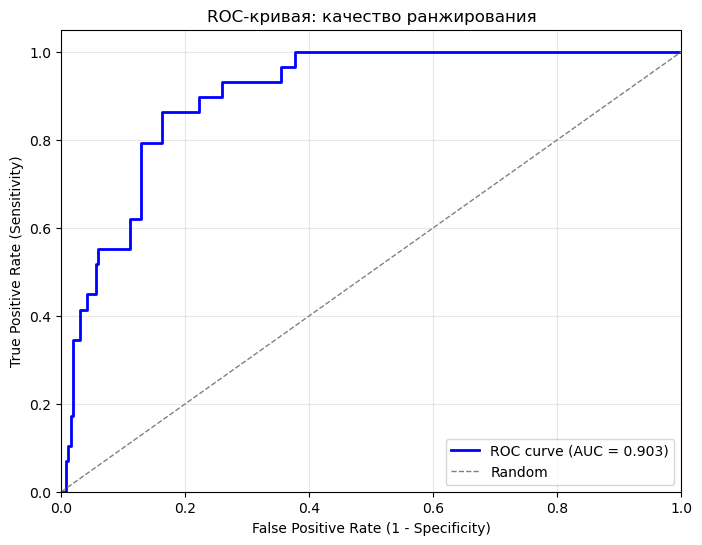

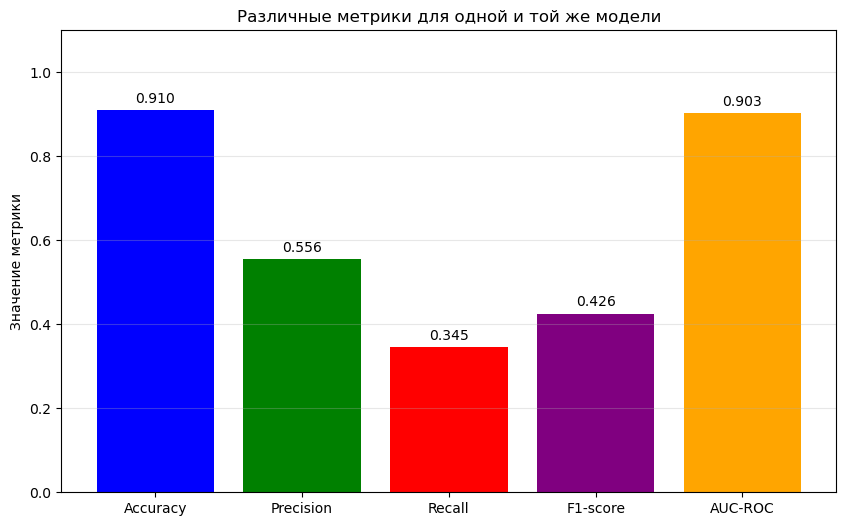

In [29]:
# Демонстрация разных метрик для классификации
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_curve, auc
from sklearn.model_selection import train_test_split
from sklearn.datasets import make_classification
from sklearn.linear_model import LogisticRegression

# Создаем несбалансированный датасет (много отрицательных, мало положительных)
X, y = make_classification(n_samples=1000, n_features=20, n_informative=10,
                         weights=[0.9, 0.1], random_state=42)  # 90% класса 0, 10% класса 1

# Разбиваем на обучающую и тестовую выборки
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Обучаем модель
model = LogisticRegression(random_state=42)
model.fit(X_train, y_train)

# Делаем предсказания
y_pred = model.predict(X_test)
y_pred_proba = model.predict_proba(X_test)[:, 1]

# Рассчитываем метрики
accuracy = accuracy_score(y_test, y_pred)
precision = precision_score(y_test, y_pred)
recall = recall_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred)

# Рассчитываем ROC-кривую
fpr, tpr, _ = roc_curve(y_test, y_pred_proba)
roc_auc = auc(fpr, tpr)

# Всегда предсказывать отрицательный класс
y_pred_all_neg = np.zeros_like(y_test)
accuracy_all_neg = accuracy_score(y_test, y_pred_all_neg)

# Вывод результатов
print(f"Распределение классов в тестовой выборке:")
print(f"Класс 0: {np.sum(y_test==0)} примеров ({np.mean(y_test==0):.1%})")
print(f"Класс 1: {np.sum(y_test==1)} примеров ({np.mean(y_test==1):.1%})")
print("\nМетрики нашей модели:")
print(f"Accuracy: {accuracy:.4f}")
print(f"Precision: {precision:.4f}") 
print(f"Recall: {recall:.4f}")
print(f"F1-score: {f1:.4f}")
print(f"AUC-ROC: {roc_auc:.4f}")
print("\nДля сравнения, если всегда предсказывать только класс 0:")
print(f"Accuracy: {accuracy_all_neg:.4f}")
print(f"Precision: -")  # Undefined (деление на ноль)
print(f"Recall: 0.0000")
print(f"F1-score: 0.0000")

# Визуализация ROC-кривой
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='blue', lw=2, label=f'ROC curve (AUC = {roc_auc:.3f})')
plt.plot([0, 1], [0, 1], color='gray', lw=1, linestyle='--', label='Random')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate (1 - Specificity)')
plt.ylabel('True Positive Rate (Sensitivity)')
plt.title('ROC-кривая: качество ранжирования')
plt.legend(loc='lower right')
plt.grid(alpha=0.3)
plt.show()

# Визуализация метрик
metrics = ['Accuracy', 'Precision', 'Recall', 'F1-score', 'AUC-ROC']
values = [accuracy, precision, recall, f1, roc_auc]

plt.figure(figsize=(10, 6))
bars = plt.bar(metrics, values, color=['blue', 'green', 'red', 'purple', 'orange'])
for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2., height + 0.01, f'{height:.3f}', 
             ha='center', va='bottom')
plt.ylim(0, 1.1)
plt.title('Различные метрики для одной и той же модели')
plt.ylabel('Значение метрики')
plt.grid(axis='y', alpha=0.3)
plt.show()

## Оптимизация: искусство доведения до совершенства


###### Что такое оптимизация в ML:



    Процесс поиска лучших параметров и гиперпараметров модели
    Балансирование между недообучением и переобучением
    То, что превращает "так себе" модель в "вау" модель

##### Основные направления оптимизации:



###### Оптимизация параметров модели 

    Градиентный спуск и его варианты (SGD, Adam, RMSprop)
    Модель сама подбирает оптимальные веса/коэффициенты

###### Оптимизация гиперпараметров (делаем мы):

    Подбор сложности модели (глубина дерева, количество слоев в нейросети)
    Настройка регуляризации для борьбы с переобучением
    GridSearch, RandomSearch, Bayesian optimization

###### Оптимизация данных: 

    Сбор более качественных или релевантных данных
    Инженерия признаков (создание новых информативных признаков)
    Аугментация данных (увеличение объема обучающих примеров)

###### "Железное" правило оптимизации в ML:


"Сначала данные, потом алгоритм, потом гиперпараметры" 



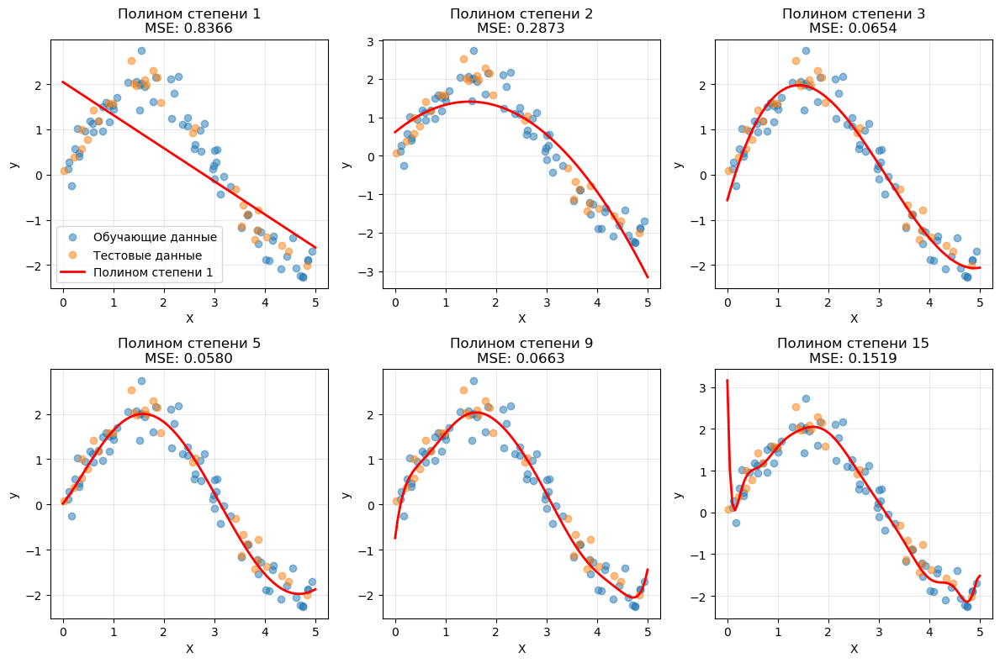

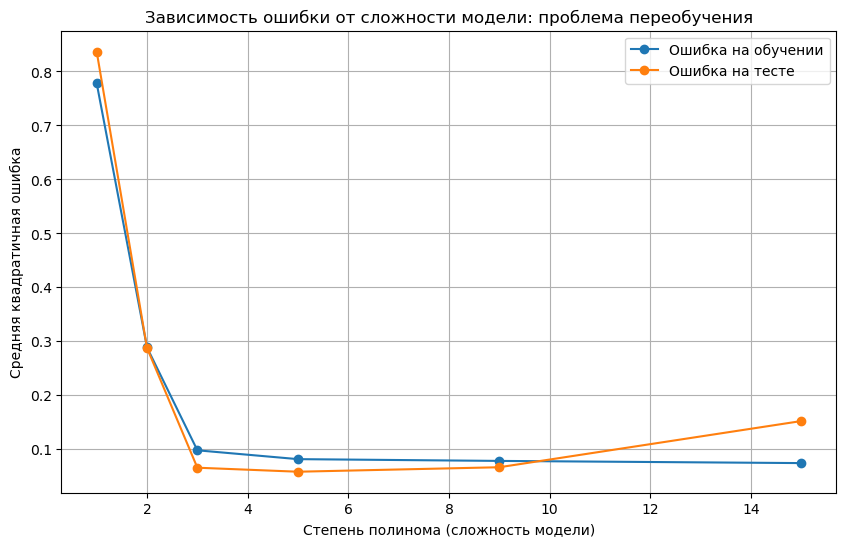

Этот график иллюстрирует классическую проблему в ML: переобучение.
При увеличении сложности модели:
1. Ошибка на обучающей выборке всегда уменьшается
2. Но ошибка на тестовой выборке сначала уменьшается, а потом увеличивается
3. Оптимальная модель находится в точке минимума тестовой ошибки


In [8]:
# Иллюстрация процесса оптимизации
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import PolynomialFeatures
from sklearn.metrics import mean_squared_error
import numpy as np
import matplotlib.pyplot as plt

# Генерируем синтетические данные с нелинейной зависимостью
np.random.seed(42)
X = np.sort(np.random.rand(100, 1) * 5, axis=0)
y = np.sin(X.squeeze()) * 2 + np.random.normal(0, 0.3, 100)

# Разделяем на обучающую и тестовую выборки
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Создаем модели разной сложности
mse_train = []
mse_test = []
degrees = [1, 2, 3, 5, 9, 15]  # Степени полиномов

plt.figure(figsize=(12, 8))

for i, degree in enumerate(degrees):
    # Преобразование признаков - полиномиальные
    poly_features = PolynomialFeatures(degree=degree, include_bias=False)
    X_poly_train = poly_features.fit_transform(X_train)
    X_poly_test = poly_features.transform(X_test)
    
    # Обучаем модель
    model = LinearRegression()
    model.fit(X_poly_train, y_train)
    
    # Предсказания
    y_train_pred = model.predict(X_poly_train)
    y_test_pred = model.predict(X_poly_test)
    
    # Считаем метрики качества
    train_mse = mean_squared_error(y_train, y_train_pred)
    test_mse = mean_squared_error(y_test, y_test_pred)
    
    mse_train.append(train_mse)
    mse_test.append(test_mse)
    
    # Визуализация для каждой модели
    plt.subplot(2, 3, i+1)
    plt.scatter(X_train, y_train, alpha=0.5, label='Обучающие данные')
    plt.scatter(X_test, y_test, alpha=0.5, label='Тестовые данные')
    
    # Сортируем для плавного отображения кривой
    X_plot = np.linspace(0, 5, 100).reshape(-1, 1)
    X_plot_poly = poly_features.transform(X_plot)
    y_plot = model.predict(X_plot_poly)
    
    plt.plot(X_plot, y_plot, 'r', linewidth=2, label=f'Полином степени {degree}')
    plt.title(f'Полином степени {degree}\nMSE: {test_mse:.4f}')
    plt.xlabel('X')
    plt.ylabel('y')
    if i == 0:
        plt.legend()
    plt.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

# График ошибок
plt.figure(figsize=(10, 6))
plt.plot(degrees, mse_train, 'o-', label='Ошибка на обучении')
plt.plot(degrees, mse_test, 'o-', label='Ошибка на тесте')
plt.xlabel('Степень полинома (сложность модели)')
plt.ylabel('Средняя квадратичная ошибка')
plt.title('Зависимость ошибки от сложности модели: проблема переобучения')
plt.grid(True)
plt.legend()
plt.show()

print("Этот график иллюстрирует классическую проблему в ML: переобучение.")
print("При увеличении сложности модели:")
print("1. Ошибка на обучающей выборке всегда уменьшается")
print("2. Но ошибка на тестовой выборке сначала уменьшается, а потом увеличивается")
print("3. Оптимальная модель находится в точке минимума тестовой ошибки")

#### Методы подбора гиперпараметров: инструментарий дата-сайентиста

##### Cross-Validation: не доверяй одной выборке


###### Что такое: 
Метод оценки модели, при котором данные многократно разбиваются на обучающую и проверочную выборки.



###### Зачем нужна: 
Одно разбиение может быть "счастливым" или "несчастливым". Cross-validation даёт более надёжную оценку качества модели.



###### Как работает:



    K-fold CV: Разбиваем данные на k частей. Обучаем на k-1 частях, валидируем на оставшейся. Повторяем k раз.
    Stratified K-fold: То же самое, но сохраняет соотношение классов в каждом разбиении.
    Leave-One-Out: Предельный случай — обучаемся на всех примерах, кроме одного, и так для каждого примера.

In [ ]:
from sklearn.model_selection import cross_val_score
scores = cross_val_score(model, X, y, cv=5)  # 5-fold CV

##### GridSearchCV: перебор всех комбинаций


###### Что такое: 
Метод поиска гиперпараметров, который перебирает все возможные комбинации из заданного набора.



###### Плюсы:

    Гарантированно найдёт лучшую комбинацию из заданных
    Систематичный и понятный

###### Минусы:

    Вычислительно дорогой (10 параметров с 5 значениями = 5^10 = 10 миллионов комбинаций)
    "Проклятие размерности" — экспоненциальный рост с числом параметров

###### Когда использовать:

    Мало гиперпараметров
    Есть вычислительные ресурсы
    Нужна уверенность в оптимальности

#### RandomizedSearchCV: случайный поиск


###### Что такое: 
Вместо полного перебора выбирает случайные комбинации из распределений параметров.

###### Плюсы:

    Значительно быстрее, чем GridSearch
    Часто находит почти такие же хорошие решения
    Можно задавать непрерывные распределения параметров

###### Минусы:

    Не гарантирует нахождение оптимума
    Результаты могут отличаться при повторных запусках

###### Исследование Бергстра и Бенджио:
Случайный поиск часто находит лучшие параметры быстрее, чем сеточный, особенно когда не все параметры одинаково важны.



In [ ]:
from sklearn.model_selection import RandomizedSearchCV
random_search = RandomizedSearchCV(model, param_distributions, n_iter=100, cv=5)

#### Продвинутые методы


###### Bayesian Optimization:



    Строит вероятностную модель целевой функции и выбирает точки для оценки
    Учится на предыдущих результатах, фокусируясь на перспективных областях
    Библиотеки: Hyperopt, scikit-optimize, Optuna

###### Генетические алгоритмы:
    Имитируют естественный отбор, "скрещивая" успешные комбинации параметров
    Могут преодолевать локальные минимумы
    Модули: DEAP, TPOT


#### Практические советы


###### 1. Начинайте с грубой сетки, затем уточняйте

In [ ]:
# Сначала широкий диапазон
param_grid_rough = {'n_estimators': [10, 100, 1000], 'max_depth': [3, 10, None]}

# Потом уточняем в перспективной области
param_grid_fine = {'n_estimators': [50, 75, 100, 150], 'max_depth': [8, 9, 10, 11, 12]}

###### 2. Используйте логарифмические шкалы для некоторых параметров



In [ ]:
from scipy.stats import loguniform
param_dist = {'C': loguniform(1e-3, 1e3)}  # Для SVM или логистической регрессии

###### 3. Мониторьте процесс и раннее прекращение



In [ ]:
# Можно остановить поиск, когда нет улучшений
search = GridSearchCV(..., callback=your_early_stopping_callback)

###### 4. Параллелизация — ваш друг



In [ ]:
search = GridSearchCV(..., n_jobs=-1)  # Использует все доступные ядра

###### 5. Сохраняйте результаты



In [ ]:
import joblib
joblib.dump(search.cv_results_, 'search_results.pkl')  # Не потеряйте часы вычислений!

###### Мудрость дата-сайентиста №42:


"Нахождение идеальных гиперпараметров — это искусство на грани с наукой. Частично статистика, частично инженерия, частично шаманство." 



Точность базовой модели (неоптимальные параметры): 0.6033

Начинаем поиск оптимальных гиперпараметров...
Fitting 5 folds for each of 48 candidates, totalling 240 fits

Лучшие найденные гиперпараметры: {'max_depth': None, 'min_samples_split': 5, 'n_estimators': 200}
Лучшая кросс-валидационная точность: 0.8757

Точность на тестовой выборке:
Базовая модель (неоптимальная): 0.6033
Оптимизированная модель: 0.8833
Улучшение: 28.00%


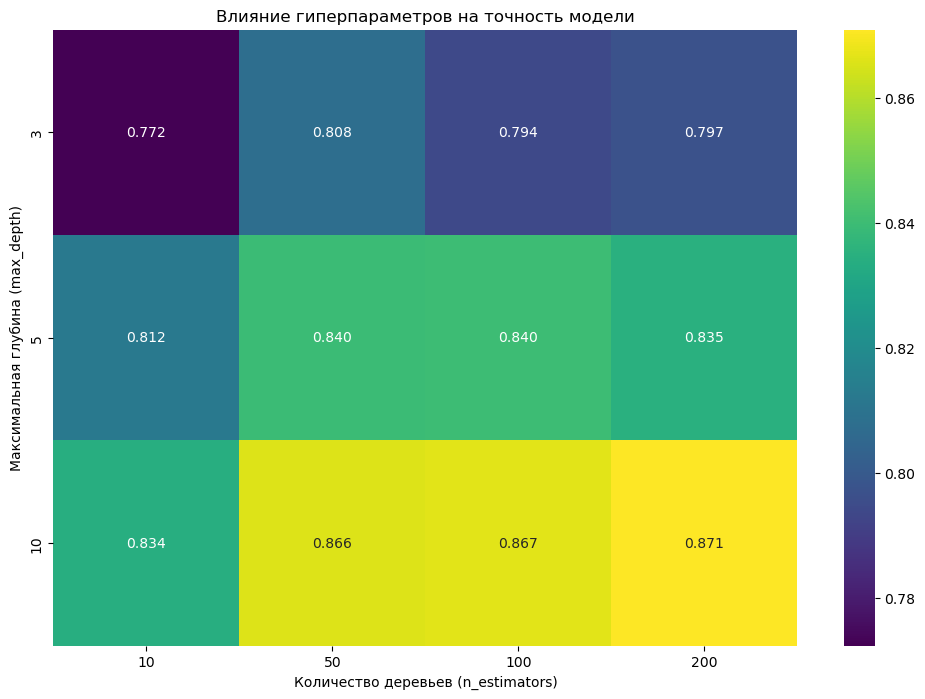

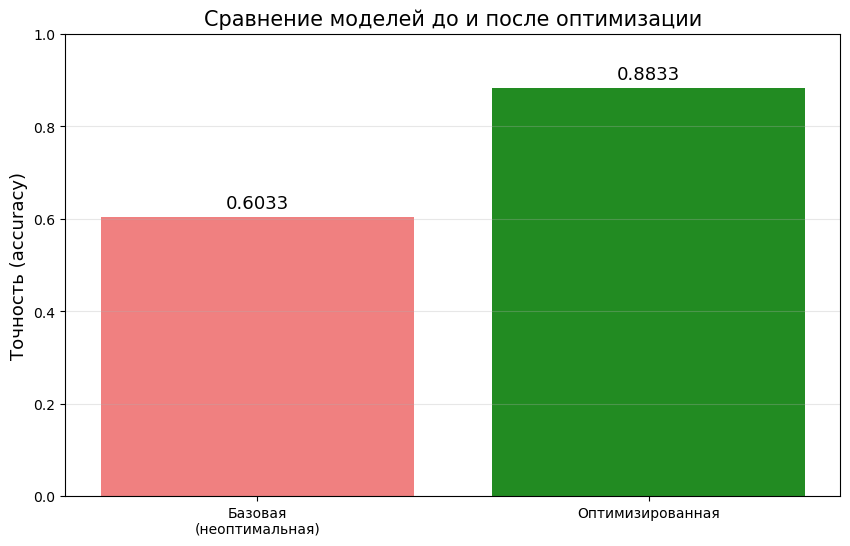

In [39]:

# Демонстрация оптимизации гиперпараметров 
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.datasets import make_classification
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns

# Создаем более сложный датасет
X, y = make_classification(n_samples=1000, n_features=20, n_informative=10, 
                          n_redundant=5, class_sep=0.7, random_state=42)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Базовая модель с намеренно неоптимальными параметрами
base_model = RandomForestClassifier(n_estimators=5, max_depth=2, random_state=42)
base_model.fit(X_train, y_train)
base_pred = base_model.predict(X_test)
base_accuracy = accuracy_score(y_test, base_pred)

print(f"Точность базовой модели (неоптимальные параметры): {base_accuracy:.4f}")

# Определяем более обширную сетку гиперпараметров для перебора
param_grid = {
    'n_estimators': [10, 50, 100, 200],
    'max_depth': [3, 5, 10, None],
    'min_samples_split': [2, 5, 10]
}

# Используем GridSearchCV для поиска лучших гиперпараметров
grid_search = GridSearchCV(
    RandomForestClassifier(random_state=42),
    param_grid,
    cv=5,
    scoring='accuracy',
    n_jobs=-1,
    verbose=1
)

print("\nНачинаем поиск оптимальных гиперпараметров...")
grid_search.fit(X_train, y_train)

# Результаты поиска
print(f"\nЛучшие найденные гиперпараметры: {grid_search.best_params_}")
print(f"Лучшая кросс-валидационная точность: {grid_search.best_score_:.4f}")

# Проверяем на тестовой выборке
best_model = grid_search.best_estimator_
best_pred = best_model.predict(X_test)
best_accuracy = accuracy_score(y_test, best_pred)

print(f"\nТочность на тестовой выборке:")
print(f"Базовая модель (неоптимальная): {base_accuracy:.4f}")
print(f"Оптимизированная модель: {best_accuracy:.4f}")
print(f"Улучшение: {(best_accuracy - base_accuracy) * 100:.2f}%")

# Визуализация результатов поиска (упрощенная версия для наглядности)
results = pd.DataFrame(grid_search.cv_results_)

# Выберем только n_estimators и max_depth для визуализации
pivot_table = results.pivot_table(
    index='param_max_depth', 
    columns='param_n_estimators',
    values='mean_test_score'
)

plt.figure(figsize=(12, 8))
sns.heatmap(pivot_table, annot=True, cmap='viridis', fmt='.3f')
plt.title('Влияние гиперпараметров на точность модели')
plt.xlabel('Количество деревьев (n_estimators)')
plt.ylabel('Максимальная глубина (max_depth)')
plt.show()

# Сравнение базовой и оптимизированной моделей
models = ['Базовая\n(неоптимальная)', 'Оптимизированная']
accuracies = [base_accuracy, best_accuracy]

plt.figure(figsize=(10, 6))
bars = plt.bar(models, accuracies, color=['lightcoral', 'forestgreen'])
plt.title('Сравнение моделей до и после оптимизации', fontsize=15)
plt.ylabel('Точность (accuracy)', fontsize=13)
plt.ylim(0, 1.0)

for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2., height + 0.01,
            f'{height:.4f}', ha='center', va='bottom', fontsize=13)

plt.grid(axis='y', alpha=0.3)
plt.show()

Сравнение методов подбора гиперпараметров:
Значения по умолчанию:
  Среднее качество: 0.9330
  Время выполнения: 1.62 сек
  Число оценок моделей: 1
GridSearchCV:
  Среднее качество: 0.9350
  Время выполнения: 1.79 сек
  Число оценок моделей: 4
RandomizedSearchCV:
  Среднее качество: 0.9310
  Время выполнения: 1.73 сек
  Число оценок моделей: 4


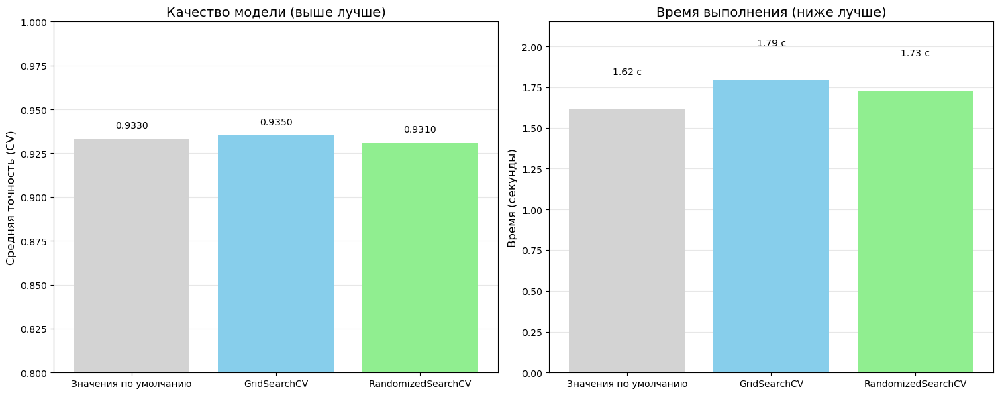

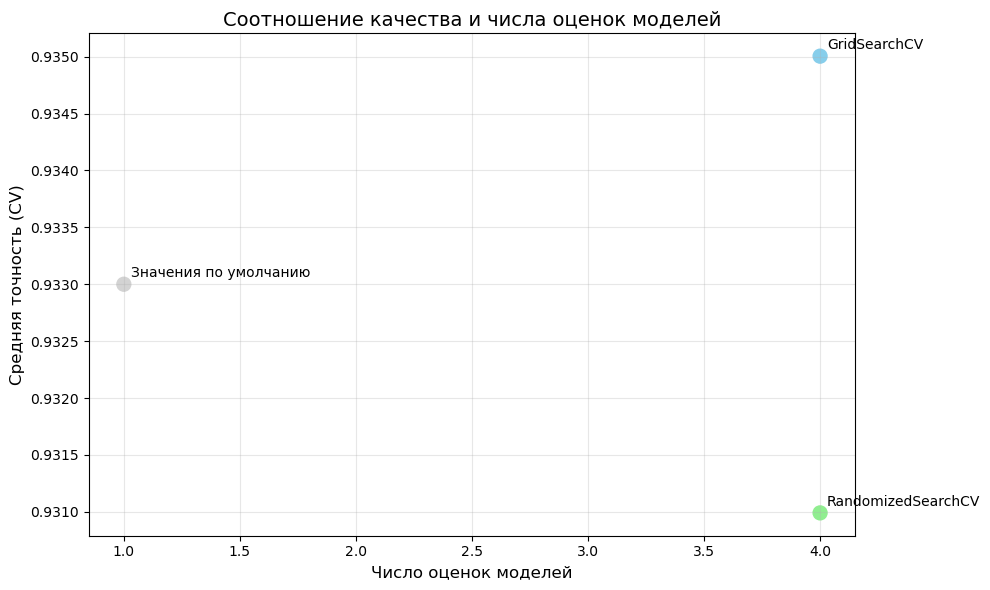

In [42]:
# Демонстрация различных методов поиска гиперпараметров
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV, cross_val_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.datasets import make_classification
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import numpy as np
import time
from scipy.stats import randint, uniform

# Создаем датасет
X, y = make_classification(n_samples=1000, n_features=20, n_informative=10, 
                         n_redundant=5, random_state=42)

# Определяем пайплайн с предобработкой и моделью
pipeline = Pipeline([
    ('scaler', StandardScaler()),
    ('classifier', RandomForestClassifier(random_state=42))
])

# Параметры для поиска
param_grid = {
    'classifier__n_estimators': [10, 50, 100, 200],
    'classifier__max_depth': [3, 5, 10, None],
    'classifier__min_samples_split': [2, 5, 10],
    'classifier__min_samples_leaf': [1, 2, 4]
}

# Параметры для случайного поиска
param_dist = {
    'classifier__n_estimators': randint(10, 200),
    'classifier__max_depth': randint(3, 15),
    'classifier__min_samples_split': randint(2, 11),
    'classifier__min_samples_leaf': randint(1, 5)
}

# Сравним время и производительность различных методов
methods = {}

# 1. Базовая модель со значениями по умолчанию
start_time = time.time()
base_model = Pipeline([
    ('scaler', StandardScaler()),
    ('classifier', RandomForestClassifier(random_state=42))
])
base_scores = cross_val_score(base_model, X, y, cv=5)
base_time = time.time() - start_time
methods['Значения по умолчанию'] = {
    'score': np.mean(base_scores),
    'time': base_time,
    'evaluations': 1
}

# 2. Grid Search с сокращенной сеткой для демонстрации
small_param_grid = {
    'classifier__n_estimators': [10, 100],
    'classifier__max_depth': [3, None]
}
start_time = time.time()
grid_search = GridSearchCV(pipeline, small_param_grid, cv=3, n_jobs=-1)
grid_search.fit(X, y)
grid_time = time.time() - start_time
methods['GridSearchCV'] = {
    'score': grid_search.best_score_,
    'time': grid_time,
    'evaluations': len(grid_search.cv_results_['params'])
}

# 3. Random Search с тем же бюджетом оценок
start_time = time.time()
random_search = RandomizedSearchCV(pipeline, param_dist, n_iter=len(grid_search.cv_results_['params']), 
                                 cv=3, random_state=42, n_jobs=-1)
random_search.fit(X, y)
random_time = time.time() - start_time
methods['RandomizedSearchCV'] = {
    'score': random_search.best_score_,
    'time': random_time,
    'evaluations': len(random_search.cv_results_['params'])
}

# Вывод результатов
print("Сравнение методов подбора гиперпараметров:")
for method, stats in methods.items():
    print(f"{method}:")
    print(f"  Среднее качество: {stats['score']:.4f}")
    print(f"  Время выполнения: {stats['time']:.2f} сек")
    print(f"  Число оценок моделей: {stats['evaluations']}")

# Визуализация результатов
method_names = list(methods.keys())
scores = [methods[m]['score'] for m in method_names]
times = [methods[m]['time'] for m in method_names]

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 6))

# График качества
bars1 = ax1.bar(method_names, scores, color=['lightgray', 'skyblue', 'lightgreen'])
ax1.set_title('Качество модели (выше лучше)', fontsize=14)
ax1.set_ylabel('Средняя точность (CV)', fontsize=12)
ax1.set_ylim(0.8, 1.0)

# Добавляем текстовые метки над столбцами
for bar in bars1:
    height = bar.get_height()
    ax1.text(bar.get_x() + bar.get_width()/2., height + 0.005,
            f'{height:.4f}', ha='center', va='bottom')

# График времени
bars2 = ax2.bar(method_names, times, color=['lightgray', 'skyblue', 'lightgreen'])
ax2.set_title('Время выполнения (ниже лучше)', fontsize=14)
ax2.set_ylabel('Время (секунды)', fontsize=12)
ax2.set_ylim(0, max(times) * 1.2)

# Добавляем текстовые метки над столбцами
for bar in bars2:
    height = bar.get_height()
    ax2.text(bar.get_x() + bar.get_width()/2., height + 0.2,
            f'{height:.2f} с', ha='center', va='bottom')

# Общие настройки
for ax in [ax1, ax2]:
    ax.grid(axis='y', alpha=0.3)
    ax.set_axisbelow(True)

plt.tight_layout()
plt.show()

# Дополнительная визуализация: соотношение качества и числа оценок
evaluations = [methods[m]['evaluations'] for m in method_names]

plt.figure(figsize=(10, 6))
plt.scatter(evaluations, scores, s=100, c=['lightgray', 'skyblue', 'lightgreen'])

for i, method in enumerate(method_names):
    plt.annotate(method, (evaluations[i], scores[i]), 
                xytext=(5, 5), textcoords='offset points')

plt.title('Соотношение качества и числа оценок моделей', fontsize=14)
plt.xlabel('Число оценок моделей', fontsize=12)
plt.ylabel('Средняя точность (CV)', fontsize=12)
plt.grid(alpha=0.3)
plt.tight_layout()
plt.show()

Когда какой метод подбора гиперпараметров использовать?


По размеру пространства поиска
GridSearchCV:

    ✅ Небольшое число параметров (≤ 3)
    ✅ Дискретные значения с небольшим количеством вариантов
    ✅ Когда важно исследовать все комбинации
    ❌ Большое пространство поиска (комбинаторный взрыв)
RandomizedSearchCV:

    ✅ Среднее или большое число параметров (≥ 4)
    ✅ Смесь дискретных и непрерывных параметров
    ✅ Ограниченный вычислительный бюджет
    ❌ Когда нужен детерминированный результат
Bayesian Optimization:

    ✅ Дорогие в вычислении модели (глубокие нейросети)
    ✅ Сложные зависимости между параметрами
    ✅ Когда каждая оценка "на вес золота"
    ❌ Простые задачи (избыточная сложность)

    Последовательность использования
    1 Начало: Значения по умолчанию + интуиция 
    Создайте базовую модель с разумными значениями
    Проверьте, работает ли задача в принципе
    2 Ручной поиск: Попробуйте несколько осмысленных вариантов 
    Определите примерные диапазоны для каждого параметра
    Поймите влияние отдельных параметров на производительность
    3 Случайный поиск: RandomizedSearchCV с широким диапазоном 
    Охватите большое пространство поиска
    Найдите перспективные регионы
    4 Уточнение: GridSearchCV в перспективных областях 
    Сузьте диапазоны вокруг лучших найденных значений
    Исследуйте все комбинации в этой области
    5 Продвинутое: Bayesian Optimization для финальных корректировок 
    Когда каждый процент точности имеет значение
    Для параметров, которые трудно подобрать вручную

# Часть2: Подготовка данных

## EDA (Exploratory Data Analysis)

"Допрос данных": что они скрывают и как это выяснить


##### Цели EDA:


1. Понять структуру данных - что у нас есть?
2. Выявить аномалии - что здесь не так?
3. Обнаружить закономерности - что интересного?
4. Проверить гипотезы - правда ли, что...?
5. Вдохновиться на новые идеи - а что если...?

Первые 5 строк данных:


,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude,PRICE
0,8.3252,41.0,6.984127,1.023810,322.0,2.555556,37.88,-122.23,4.526
1,8.3014,21.0,6.238137,0.971880,2401.0,2.109842,37.86,-122.22,3.585
2,7.2574,52.0,8.288136,1.073446,496.0,2.802260,37.85,-122.24,3.521
3,5.6431,52.0,5.817352,1.073059,558.0,2.547945,37.85,-122.25,3.413
4,3.8462,52.0,6.281853,1.081081,565.0,2.181467,37.85,-122.25,3.422



Общая информация о данных:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20640 entries, 0 to 20639
Data columns (total 9 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   MedInc      20640 non-null  float64
 1   HouseAge    20640 non-null  float64
 2   AveRooms    20640 non-null  float64
 3   AveBedrms   20640 non-null  float64
 4   Population  20640 non-null  float64
 5   AveOccup    20640 non-null  float64
 6   Latitude    20640 non-null  float64
 7   Longitude   20640 non-null  float64
 8   PRICE       20640 non-null  float64
dtypes: float64(9)
memory usage: 1.4 MB


None


Статистическое описание числовых данных:


,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude,PRICE
count,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000
mean,3.870671,28.639486,5.429000,1.096675,1425.476744,3.070655,35.631861,-119.569704,2.068558
std,1.899822,12.585558,2.474173,0.473911,1132.462122,10.386050,2.135952,2.003532,1.153956
min,0.499900,1.000000,0.846154,0.333333,3.000000,0.692308,32.540000,-124.350000,0.149990
25%,2.563400,18.000000,4.440716,1.006079,787.000000,2.429741,33.930000,-121.800000,1.196000
50%,3.534800,29.000000,5.229129,1.048780,1166.000000,2.818116,34.260000,-118.490000,1.797000
75%,4.743250,37.000000,6.052381,1.099526,1725.000000,3.282261,37.710000,-118.010000,2.647250
max,15.000100,52.000000,141.909091,34.066667,35682.000000,1243.333333,41.950000,-114.310000,5.000010



Пропущенные значения:


MedInc        0
HouseAge      0
AveRooms      0
AveBedrms     0
Population    0
AveOccup      0
Latitude      0
Longitude     0
PRICE         0
dtype: int64

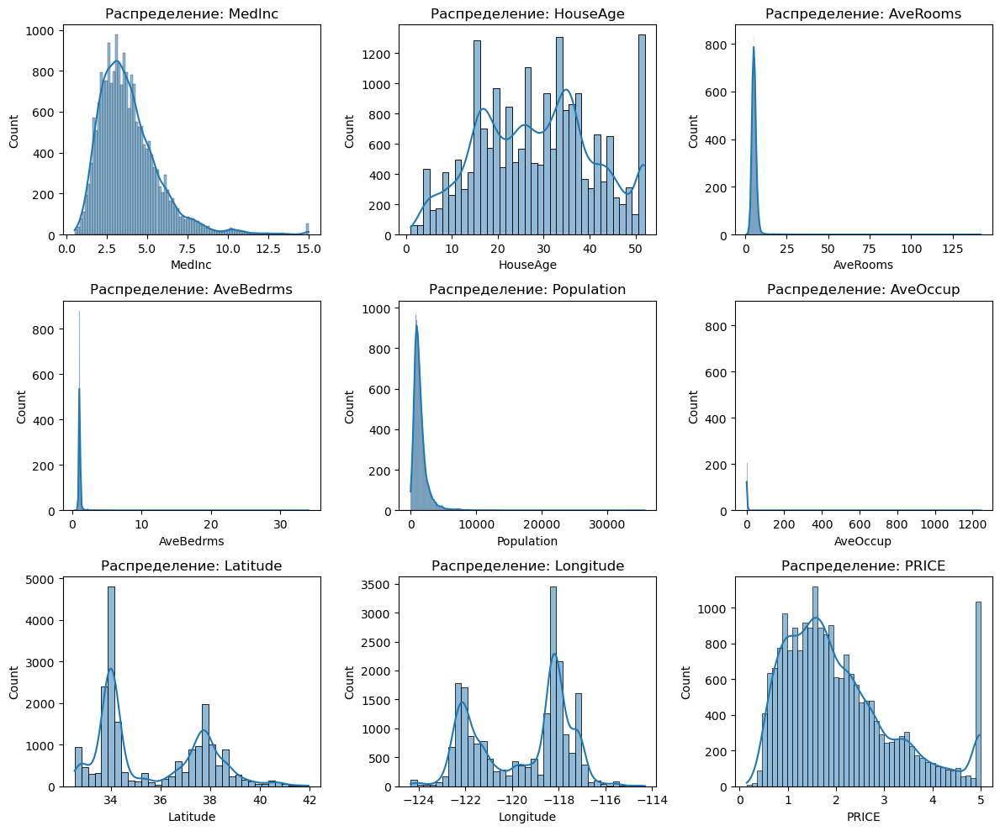

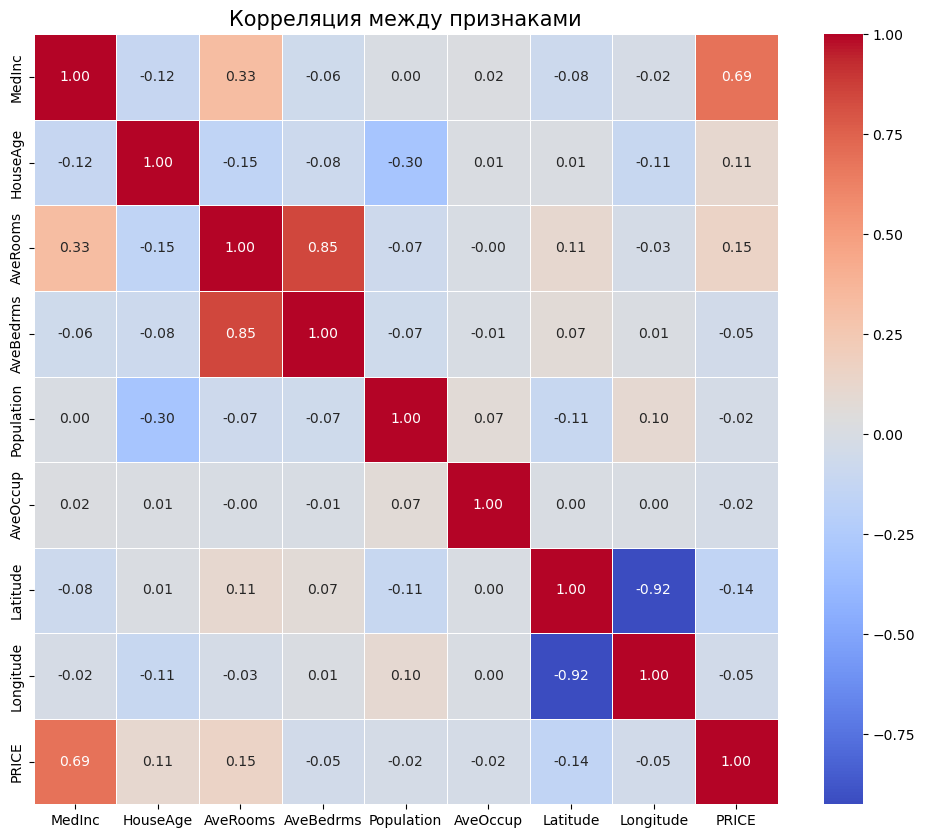

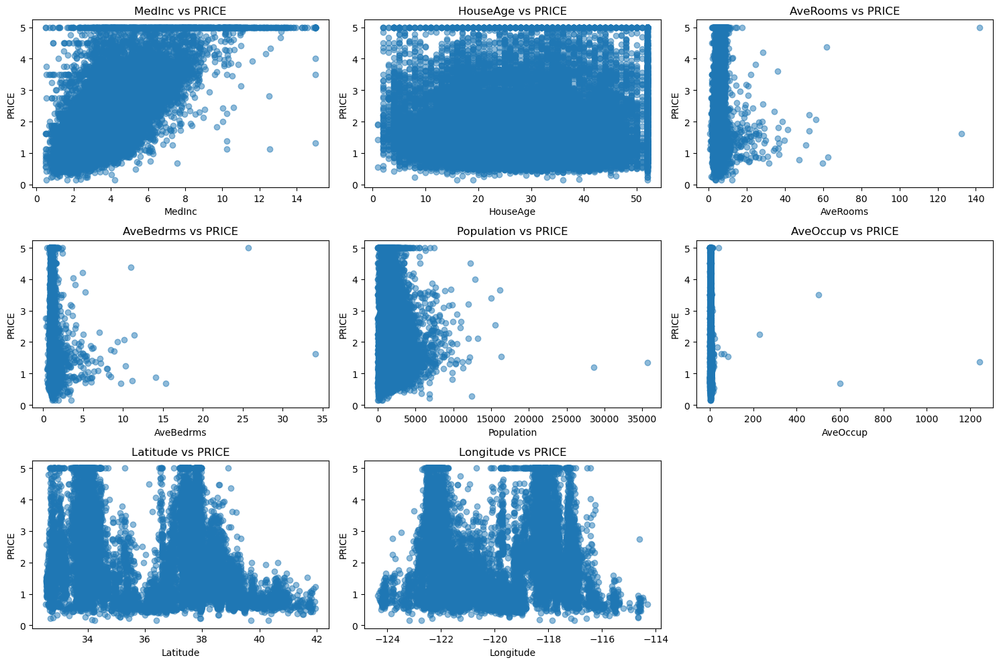

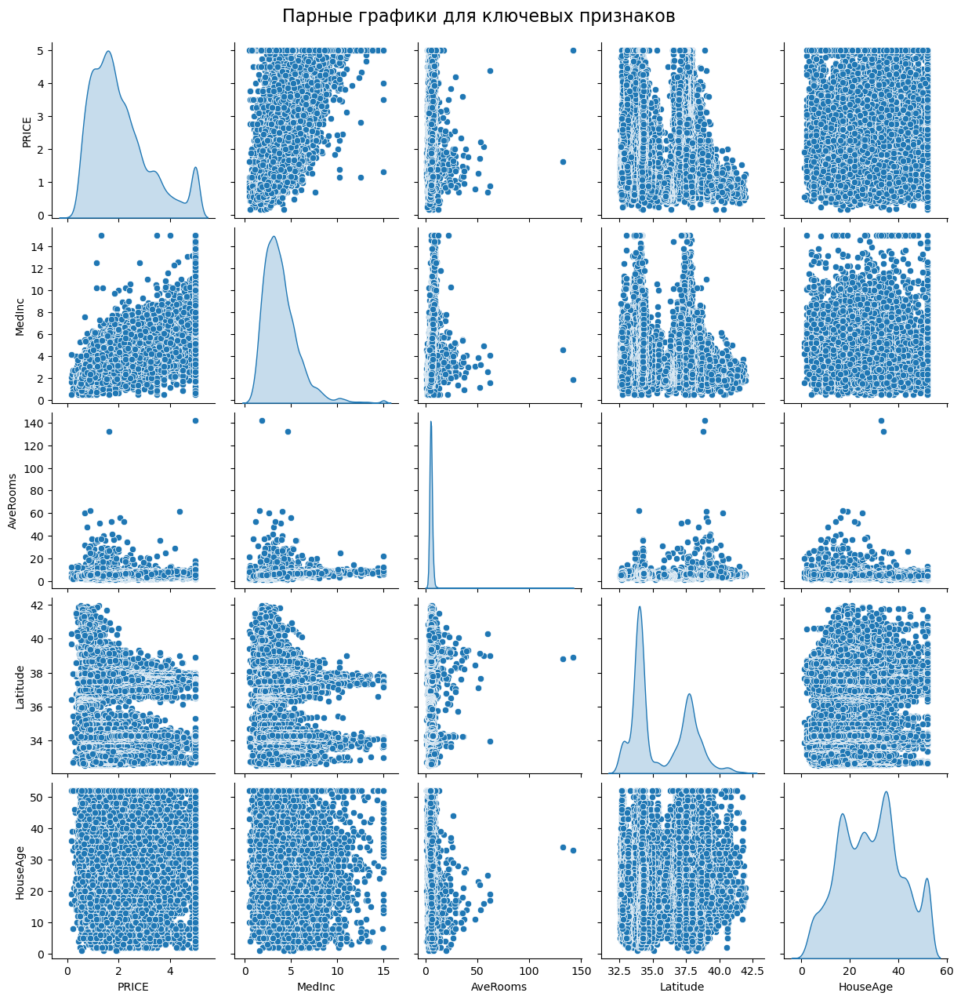

In [44]:
# Загрузим классический датасет для демонстрации
# Предположим, что мы хотим предсказать цены на жилье
from sklearn.datasets import fetch_california_housing

# Загружаем данные
housing = fetch_california_housing()
df = pd.DataFrame(housing.data, columns=housing.feature_names)
df['PRICE'] = housing.target

# Шаг 1: Первичный осмотр
print("Первые 5 строк данных:")
display(df.head())

print("\nОбщая информация о данных:")
display(df.info())

print("\nСтатистическое описание числовых данных:")
display(df.describe())

# Проверка на пропущенные значения
missing_values = df.isnull().sum()
print("\nПропущенные значения:")
display(missing_values)

# Шаг 2: Распределения признаков
plt.figure(figsize=(12, 10))
for i, column in enumerate(df.columns):
    plt.subplot(3, 3, i+1)
    sns.histplot(df[column], kde=True)
    plt.title(f'Распределение: {column}')
    plt.tight_layout()
plt.show()

# Шаг 3: Взаимосвязи между признаками
plt.figure(figsize=(12, 10))
correlation_matrix = df.corr()
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f', linewidths=0.5)
plt.title('Корреляция между признаками', fontsize=15)
plt.show()

# Шаг 4: Связь признаков с целевой переменной
plt.figure(figsize=(15, 10))
for i, column in enumerate(df.columns[:-1]):  # Исключаем целевую переменную
    plt.subplot(3, 3, i+1)
    plt.scatter(df[column], df['PRICE'], alpha=0.5)
    plt.title(f'{column} vs PRICE')
    plt.xlabel(column)
    plt.ylabel('PRICE')
    plt.tight_layout()
plt.show()

# Шаг 5: Парные графики для ключевых признаков
# Выбираем признаки с наибольшей корреляцией с целевой переменной
top_corr_features = correlation_matrix['PRICE'].abs().sort_values(ascending=False).index[:5]
sns.pairplot(df[top_corr_features], kind='scatter', diag_kind='kde')
plt.suptitle('Парные графики для ключевых признаков', y=1.02, fontsize=16)
plt.show()

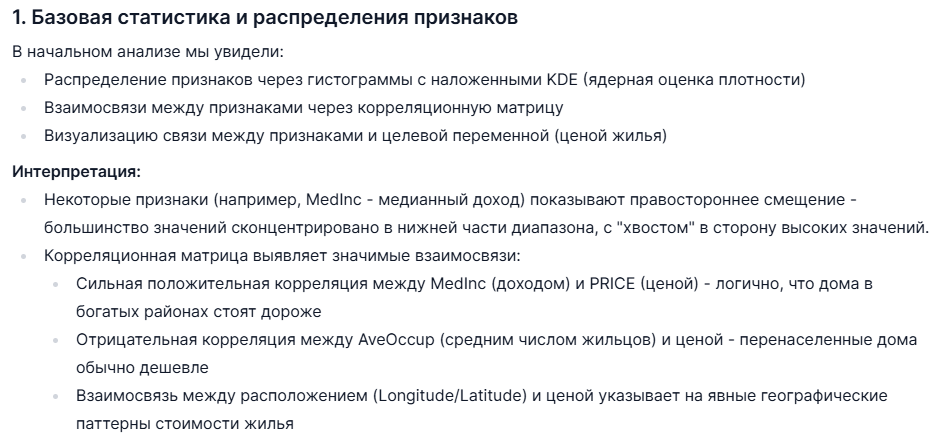

### Технические приемы EDA:

1. Универсальная последовательность действий:



In [48]:
# Осмотр "места преступления"
df.head()                      # Первые n строк
df.tail()                      # Последние n строк
df.sample(10)                  # Случайные строки

# Сбор фактов
df.info()                      # Типы данных и пропуски
df.describe()                  # Статистика по числовым столбцам
#df.describe(include='object')  # Статистика по категориальным

# Исследование подозрительных мест
df.isnull().sum()              # Количество пропусков
df.duplicated().sum()          # Количество дубликатов

# Анализ уникальных значений
for col in df.select_dtypes(include='object').columns:
    print(f"{col}: {df[col].nunique()} уникальных значений")
    print(df[col].value_counts().head(3))

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20640 entries, 0 to 20639
Data columns (total 9 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   MedInc      20640 non-null  float64
 1   HouseAge    20640 non-null  float64
 2   AveRooms    20640 non-null  float64
 3   AveBedrms   20640 non-null  float64
 4   Population  20640 non-null  float64
 5   AveOccup    20640 non-null  float64
 6   Latitude    20640 non-null  float64
 7   Longitude   20640 non-null  float64
 8   PRICE       20640 non-null  float64
dtypes: float64(9)
memory usage: 1.4 MB


0

2. Визуальные методы допроса:



###### Одномерные данные: 
    Числовые: гистограммы, боксплоты, KDE
    Категориальные: столбчатые диаграммы, круговые диаграммы


###### Двумерные отношения: 
    Числовое vs Числовое: scatter plots, гексбины
    Категориальное vs Числовое: boxplots, violin plots
    Категориальное vs Категориальное: мозаичные графики, heatmaps


###### Многомерные зависимости: 
    Pairplots, parallel coordinates, 3D-графики
    Снижение размерности: PCA, t-SNE, UMAP

3. Разговор с интуицией:



    Что выглядит странным?
    Каких данных не хватает?
    Какие признаки должны быть связаны?
    Какова бизнес-логика этих данных?

Расширенная статистика:


,count,mean,std,min,1%,5%,25%,50%,75%,95%,99%,max,missing,missing_pct,skew,kurtosis
MedInc,20640.0,3.870671,1.899822,0.499900,1.069631,1.600570,2.563400,3.534800,4.743250,7.300305,10.596540,15.000100,0,0.0,1.646657,4.952524
HouseAge,20640.0,28.639486,12.585558,1.000000,4.000000,8.000000,18.000000,29.000000,37.000000,52.000000,52.000000,52.000000,0,0.0,0.060331,-0.800629
AveRooms,20640.0,5.429000,2.474173,0.846154,2.581133,3.432330,4.440716,5.229129,6.052381,7.640247,10.357033,141.909091,0,0.0,20.697869,879.353264
AveBedrms,20640.0,1.096675,0.473911,0.333333,0.872840,0.939109,1.006079,1.048780,1.099526,1.273006,2.127541,34.066667,0,0.0,31.316956,1636.711972
Population,20640.0,1425.476744,1132.462122,3.000000,88.000000,348.000000,787.000000,1166.000000,1725.000000,3288.000000,5805.830000,35682.000000,0,0.0,4.935858,73.553116
AveOccup,20640.0,3.070655,10.386050,0.692308,1.536686,1.872545,2.429741,2.818116,3.282261,4.333417,5.394812,1243.333333,0,0.0,97.639561,10651.010636
Latitude,20640.0,35.631861,2.135952,32.540000,32.680000,32.820000,33.930000,34.260000,37.710000,38.960000,40.626100,41.950000,0,0.0,0.465953,-1.117760
Longitude,20640.0,-119.569704,2.003532,-124.350000,-123.220000,-122.470000,-121.800000,-118.490000,-118.010000,-117.080000,-116.290000,-114.310000,0,0.0,-0.297801,-1.330152
PRICE,20640.0,2.068558,1.153956,0.149990,0.500000,0.662000,1.196000,1.797000,2.647250,4.898100,5.000010,5.000010,0,0.0,0.977763,0.327870


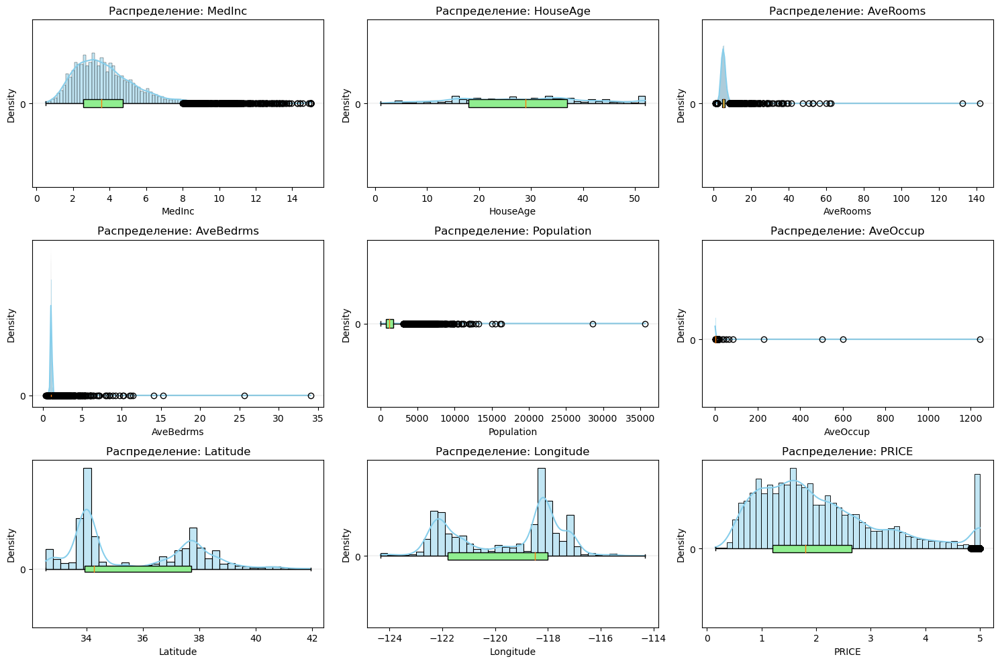

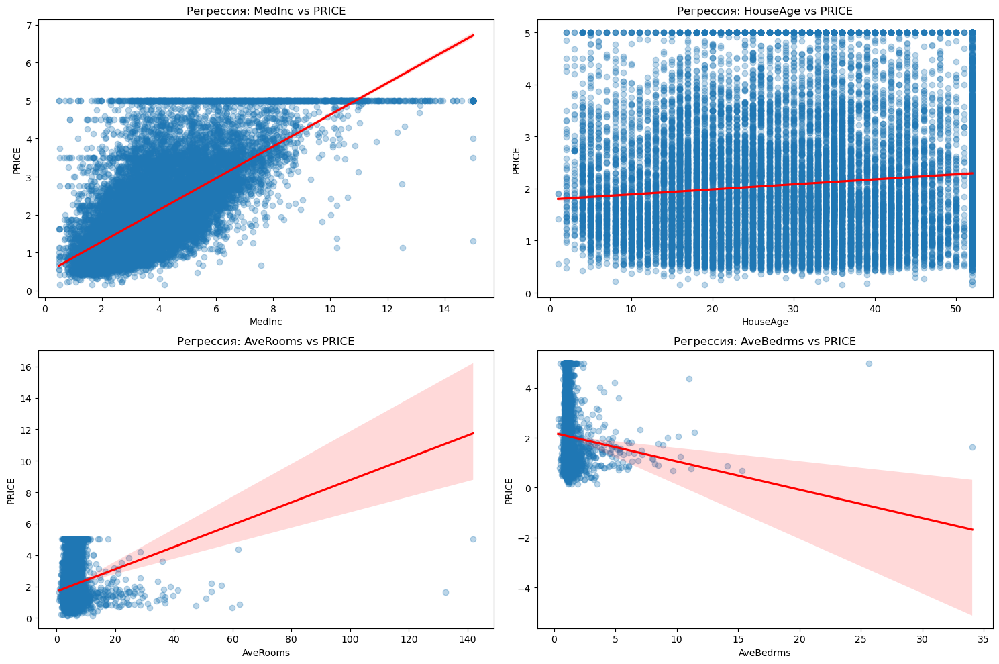

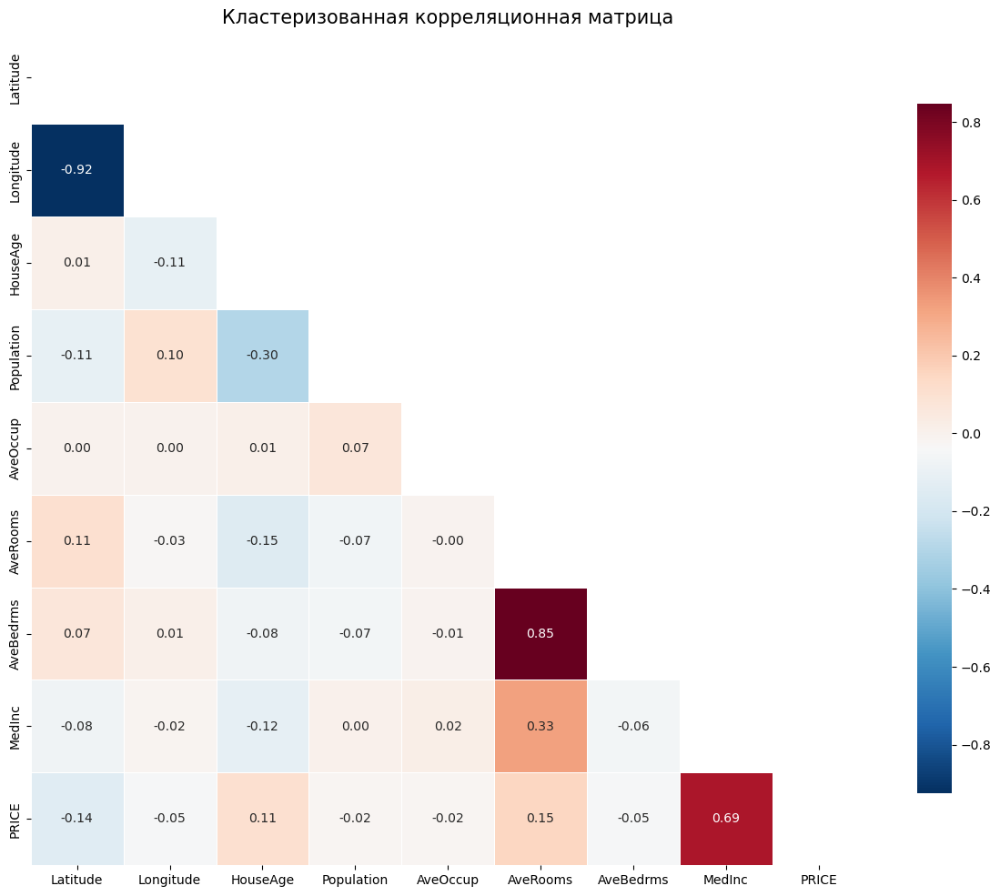

In [53]:
# Расширенные техники визуализации для EDA
# Создадим более детальные рекомендации и примеры

# 1. Обогащение базовой статистики
def enhanced_describe(df):
    """Расширенное статистическое описание с дополнительными метриками"""
    desc = df.describe(percentiles=[.01, .05, .25, .5, .75, .95, .99]).T
    # Добавляем количество пропусков
    desc['missing'] = df.isnull().sum()
    # Добавляем процент пропусков
    desc['missing_pct'] = df.isnull().mean() * 100
    # Асимметрия и эксцесс
    desc['skew'] = df.skew()
    desc['kurtosis'] = df.kurtosis()
    return desc

enhanced_stats = enhanced_describe(df.select_dtypes(include=np.number))
print("Расширенная статистика:")
display(enhanced_stats)

# 2. Визуализация распределений с выбросами
plt.figure(figsize=(15, 10))
for i, column in enumerate(df.select_dtypes(include=np.number).columns):
    plt.subplot(3, 3, i+1)
    
    # Гистограмма с KDE
    sns.histplot(df[column], kde=True, stat='density', color='skyblue')
    
    # Добавляем боксплот внизу для наглядности
    plt.axhline(y=0, color='grey', linestyle='-', alpha=0.1)
    boxplot_data = plt.boxplot(df[column], vert=False, widths=0.05, 
                             positions=[0], patch_artist=True)
    
    # Настраиваем цвета боксплота
    for box in boxplot_data['boxes']:
        box.set(facecolor='lightgreen')
    
    plt.title(f'Распределение: {column}')
    plt.tight_layout()
plt.show()

# 3. Двумерные отношения с регрессией и доверительными интервалами
plt.figure(figsize=(15, 10))
for i, col in enumerate(df.select_dtypes(include=np.number).columns[:4]):  # Берем только первые 4 для наглядности
    plt.subplot(2, 2, i+1)
    sns.regplot(x=col, y='PRICE', data=df, scatter_kws={'alpha':0.3}, line_kws={'color':'red'})
    plt.title(f'Регрессия: {col} vs PRICE')
plt.tight_layout()
plt.show()

# 4. Визуализация корреляционной матрицы с группировкой
from scipy.cluster import hierarchy
from scipy.spatial.distance import squareform

# Рассчитываем корреляционную матрицу
corr = df.corr()

# Преобразуем корреляцию в расстояние
distance = 1 - np.abs(corr)
dist_linkage = hierarchy.ward(squareform(distance))

# Создаем маскированную тепловую карту
plt.figure(figsize=(12, 10))
# Переупорядочиваем матрицу корреляции
idx = hierarchy.fcluster(dist_linkage, t=1, criterion='distance')
idx = np.argsort(idx)
corr = corr.iloc[idx, idx]

# Создаем маску для верхнего треугольника
mask = np.triu(np.ones_like(corr, dtype=bool))

# Рисуем тепловую карту
sns.heatmap(corr, mask=mask, cmap='RdBu_r', annot=True, fmt='.2f', 
          square=True, linewidths=0.5, cbar_kws={"shrink": .8})
plt.title('Кластеризованная корреляционная матрица', fontsize=15)
plt.tight_layout()
plt.show()

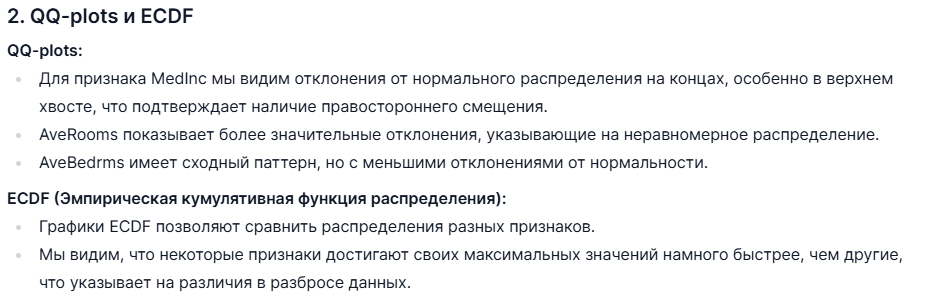

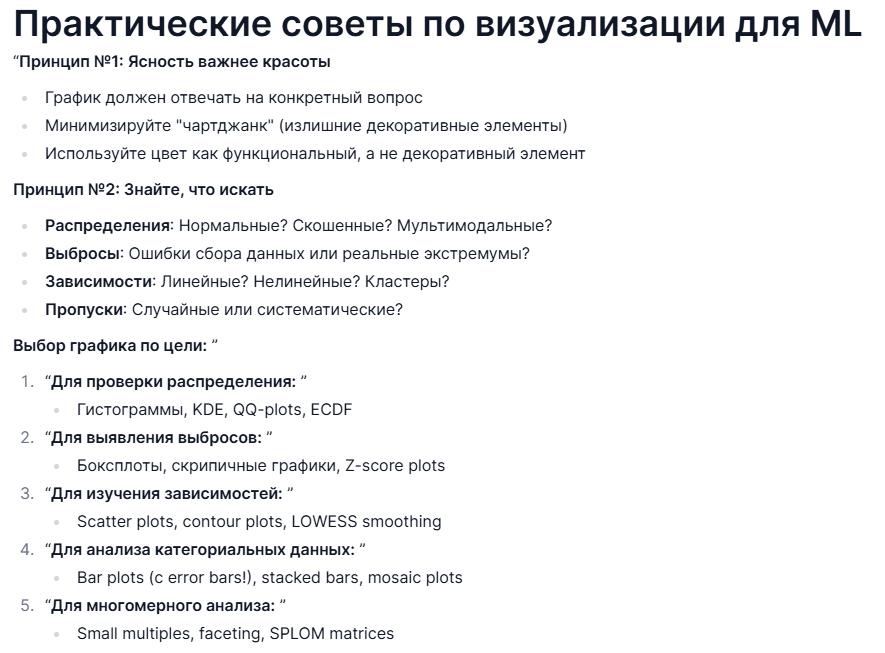

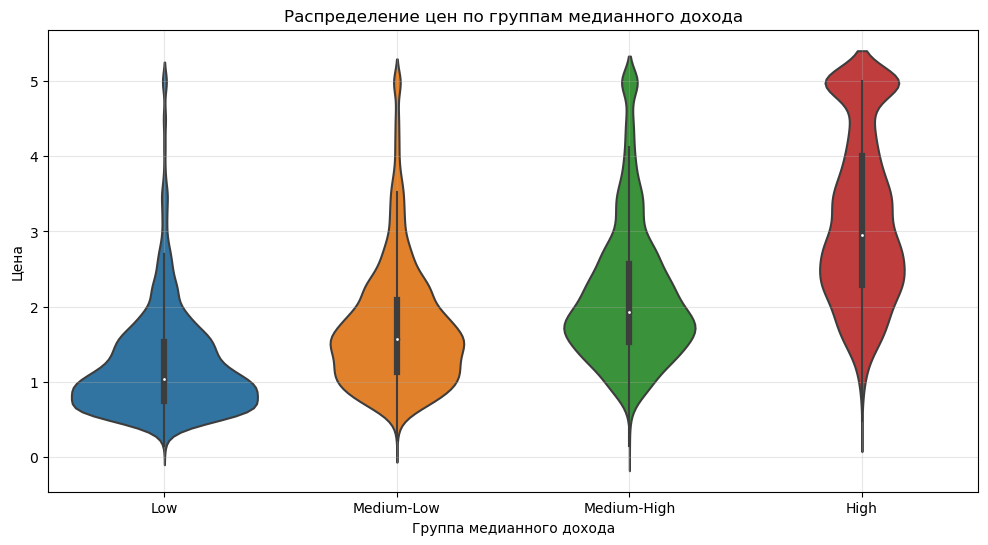

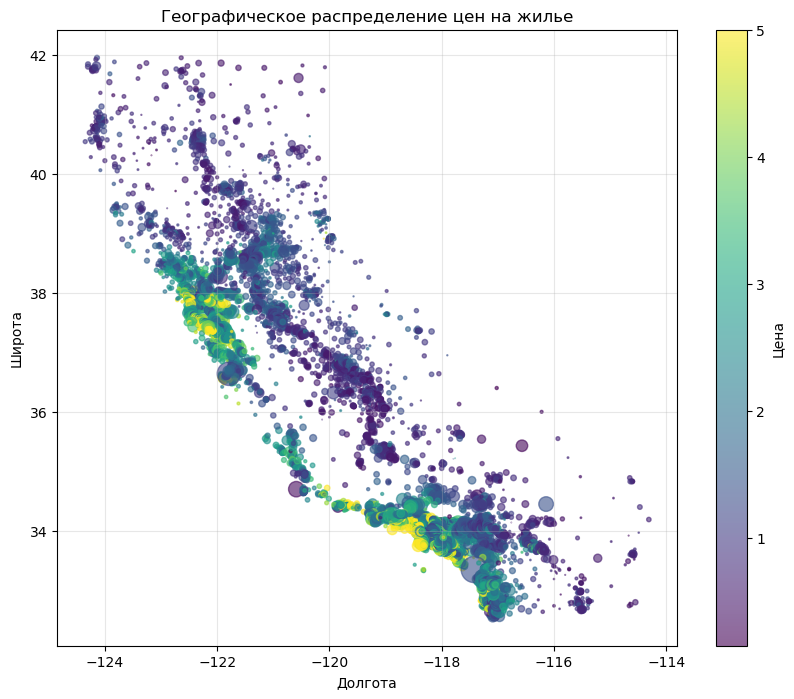

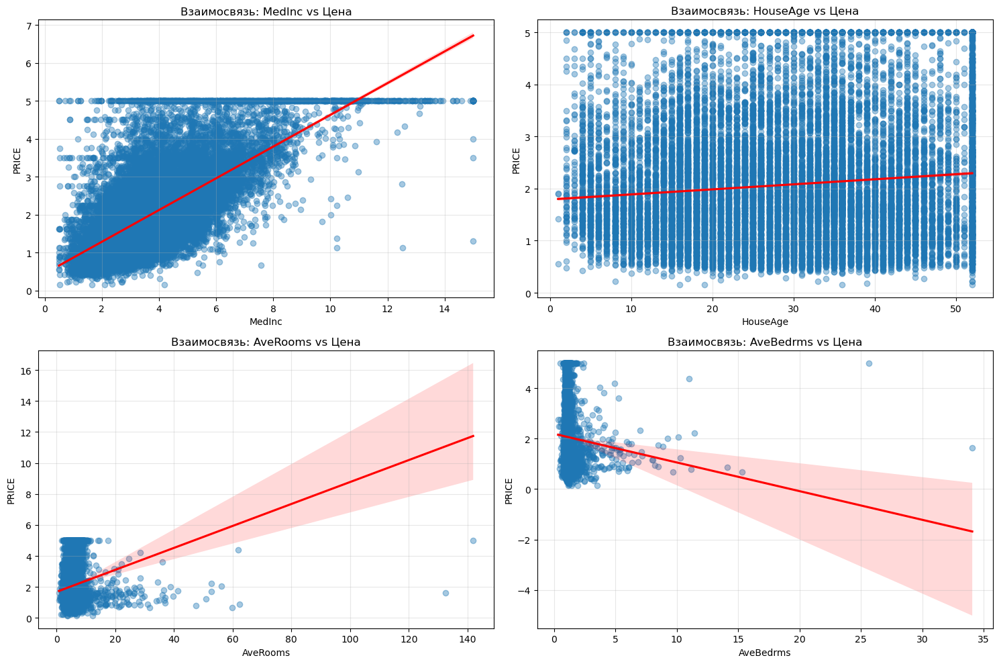

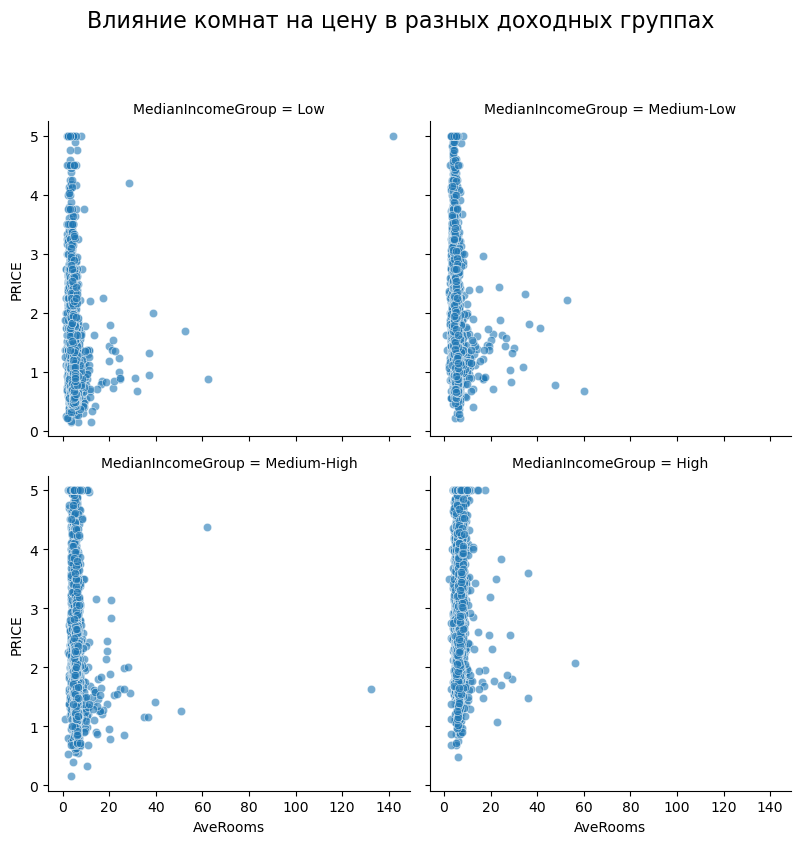

In [55]:
# 3. Violin plots для сравнения распределений по категориям
# Создадим категориальный признак для демонстрации
df['MedianIncomeGroup'] = pd.qcut(df['MedInc'], 4, labels=['Low', 'Medium-Low', 'Medium-High', 'High'])

plt.figure(figsize=(12, 6))
sns.violinplot(x='MedianIncomeGroup', y='PRICE', data=df)
plt.title('Распределение цен по группам медианного дохода')
plt.xlabel('Группа медианного дохода')
plt.ylabel('Цена')
plt.grid(True, alpha=0.3)
plt.show()

# 4. Heatmap для географических данных (если доступны координаты)
plt.figure(figsize=(10, 8))
scatter = plt.scatter(df['Longitude'], df['Latitude'], 
                     c=df['PRICE'], cmap='viridis', 
                     alpha=0.6, s=df['Population']/100)
plt.colorbar(scatter, label='Цена')
plt.title('Географическое распределение цен на жилье')
plt.xlabel('Долгота')
plt.ylabel('Широта')
plt.grid(True, alpha=0.3)
plt.show()

# 5. Scatter plots с регрессионной линией и доверительными интервалами
plt.figure(figsize=(15, 10))
for i, feature in enumerate(['MedInc', 'HouseAge', 'AveRooms', 'AveBedrms']):
    plt.subplot(2, 2, i+1)
    sns.regplot(x=feature, y='PRICE', data=df, scatter_kws={'alpha':0.4}, 
               line_kws={'color':'red'})
    plt.title(f'Взаимосвязь: {feature} vs Цена')
    plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

# 6. Facet grid для многомерного анализа
g = sns.FacetGrid(df, col='MedianIncomeGroup', col_wrap=2, height=4)
g.map(sns.scatterplot, 'AveRooms', 'PRICE', alpha=0.6)
g.add_legend()
g.fig.suptitle('Влияние комнат на цену в разных доходных группах', y=1.05, fontsize=16)
plt.tight_layout()
plt.show()

**3. Violin plots для распределения цен по группам дохода**

*   Скрипичные графики наглядно демонстрируют, как распределение цен меняется в зависимости от группы медианного дохода.
*   Заметно, что:
    *   В группе с низким доходом (Low) цены концентрируются в нижнем диапазоне с узким распределением.
    *   В группе с высоким доходом (High) распределение цен намного шире и имеет более высокий медианный уровень.
    *   Формы "скрипок" отражают различные формы распределения для разных групп дохода.

**4. Географическое распределение цен**

*   На карте, где точки окрашены по цене и размер зависит от населения:
    *   Видны явные ценовые кластеры - прибрежные районы и области вокруг крупных городов (Сан-Франциско, Лос-Анджелес) имеют более высокие цены.
    *   Внутренние регионы Калифорнии показывают более низкие цены.
    *   Можно заметить кластеры с высокой плотностью населения, но относительно низкими ценами (вероятно, городские районы с более низким уровнем жизни).

**5. Scatter plots с регрессионными линиями**

*   Графики показывают взаимосвязь между отдельными признаками и ценой жилья:
    *   MedInc имеет сильную положительную линейную взаимосвязь с ценой.
    *   HouseAge показывает более слабую зависимость - по регрессионной линии видно, что возраст дома не так сильно влияет на цену.
    *   AveRooms демонстрирует положительную корреляцию - больше комнат обычно означает более высокую цену, но с большим разбросом.
    *   Доверительные интервалы (серые области вокруг линий) показывают неопределенность в оценке взаимосвязи.

**6. Facet grid для анализа влияния комнат на цену в разных доходных группах**

*   Разбивка по группам дохода показывает, как меняется взаимосвязь между количеством комнат и ценой:
    *   В группах с высоким доходом наклон линии регрессии круче, что указывает на более сильное влияние количества комнат на цену.
    *   Разброс точек больше в группах с высоким доходом, что означает большую вариативность цен.

## Визуализации с прицелом на машинное обучение

_"Проблемы, которые нужно выявить до моделирования:"_

1.  **Нелинейные зависимости**
    *   *Почему важно:* Линейные модели не справятся с нелинейными данными
    *   *Решение:* Трансформация признаков или выбор нелинейных моделей

2.  **Неоднородность дисперсии (гетероскедастичность)**
    *   *Почему важно:* Нарушает предположения многих моделей, особенно линейных
    *   *Решение:* Логарифмирование, нормализация данных

3.  **Мультиколлинеарность**
    *   *Почему важно:* Избыточные признаки создают шум и неустойчивость
    *   *Решение:* Исключение признаков, PCA, регуляризация

4.  **Дисбаланс классов**
    *   *Почему важно:* Модель будет смещена к мажоритарному классу
    *   *Решение:* Ребалансировка, весовые коэффициенты, специализированные метрики

5.  **Недостаточное представление отдельных групп**
    *   *Почему важно:* Модель не обобщится на недопредставленные группы
    *   *Решение:* Стратифицированная выборка, аугментация данных

In [56]:
# Пример автоматизированной проверки распределений
def check_distributions(df, target_col):
    """Визуализирует распределения и возможные проблемы в датасете"""
    numerics = df.select_dtypes(include=np.number).columns
    
    for col in numerics:
        if col == target_col:
            continue
            
        fig, axes = plt.subplots(1, 3, figsize=(18, 5))
        
        # Распределение с проверкой на выбросы
        sns.histplot(df[col], kde=True, ax=axes[0])
        axes[0].set_title(f'Распределение {col}')
        
        # Проверка на нелинейность
        sns.regplot(x=col, y=target_col, data=df, ax=axes[1], 
                   scatter_kws={'alpha': 0.3})
        axes[1].set_title(f'{col} vs {target_col}')
        
        # Проверка на гетероскедастичность
        sns.scatterplot(x=col, y=target_col, data=df, ax=axes[2])
        axes[2].set_title('Проверка однородности дисперсии')
        
        plt.tight_layout()
        plt.show()

In [57]:
# Демонстрация визуализаций для выявления проблем в данных

# 1. Проверка на нелинейности и проблемы с распределением
def check_distributions(df, target_col, n_cols=5):
    """Визуализирует распределения и возможные проблемы в датасете"""
    numerics = df.select_dtypes(include=np.number).columns
    numerics = [col for col in numerics if col != target_col]
    
    # Берем только первые n_cols для демонстрации
    for col in numerics[:n_cols]:
        fig, axes = plt.subplots(1, 3, figsize=(18, 5))
        
        # Распределение с проверкой на выбросы
        sns.histplot(df[col], kde=True, ax=axes[0])
        axes[0].set_title(f'Распределение {col}')
        
        # Проверка на нелинейность
        sns.regplot(x=col, y=target_col, data=df, ax=axes[1], 
                   scatter_kws={'alpha': 0.3})
        axes[1].set_title(f'{col} vs {target_col}')
        
        # Проверка на гетероскедастичность
        sns.residplot(x=col, y=target_col, data=df, ax=axes[2],
                     scatter_kws={'alpha': 0.3})
        axes[2].set_title('Остатки (проверка однородности дисперсии)')
        
        plt.tight_layout()
        plt.show()

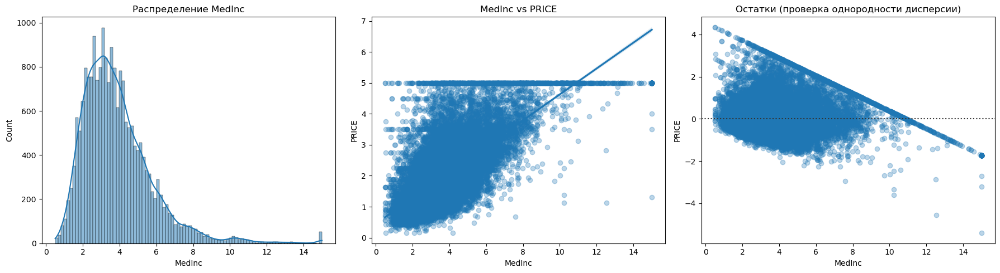

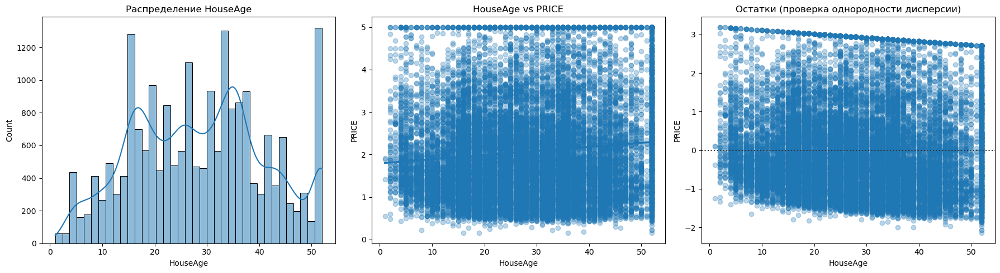

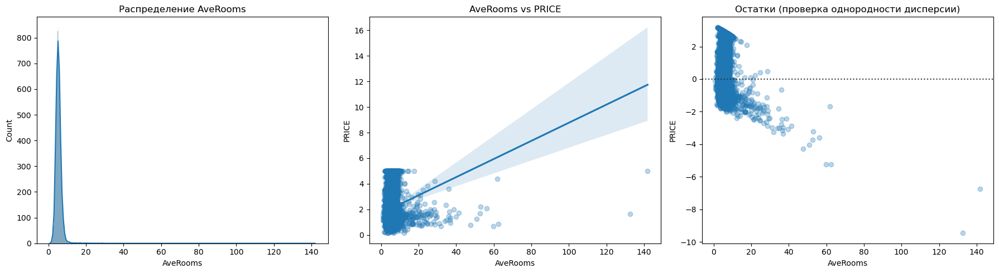

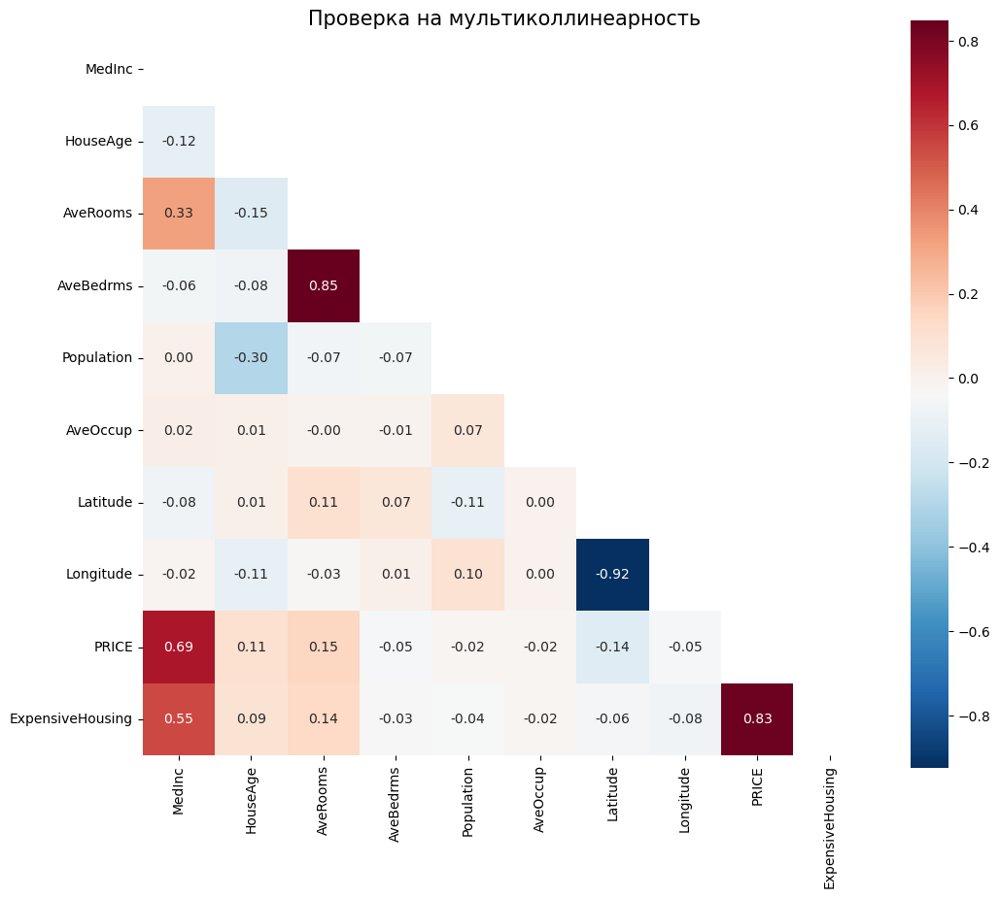

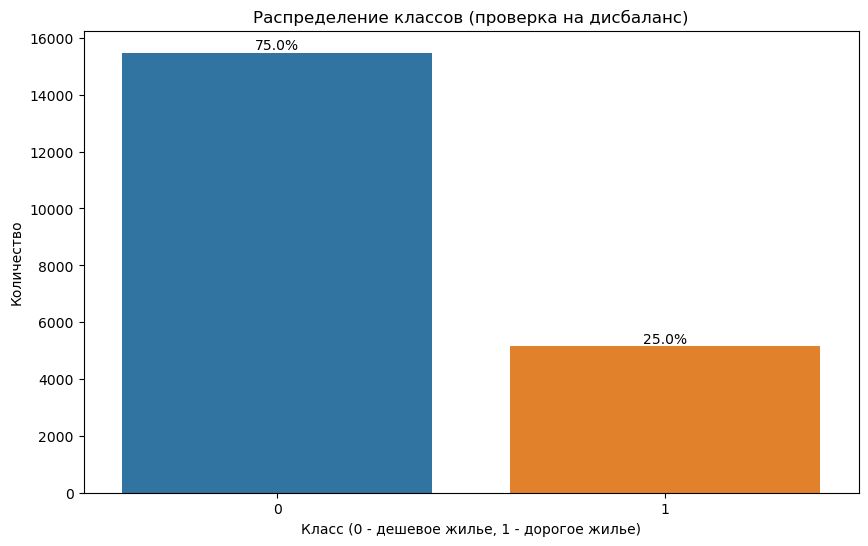

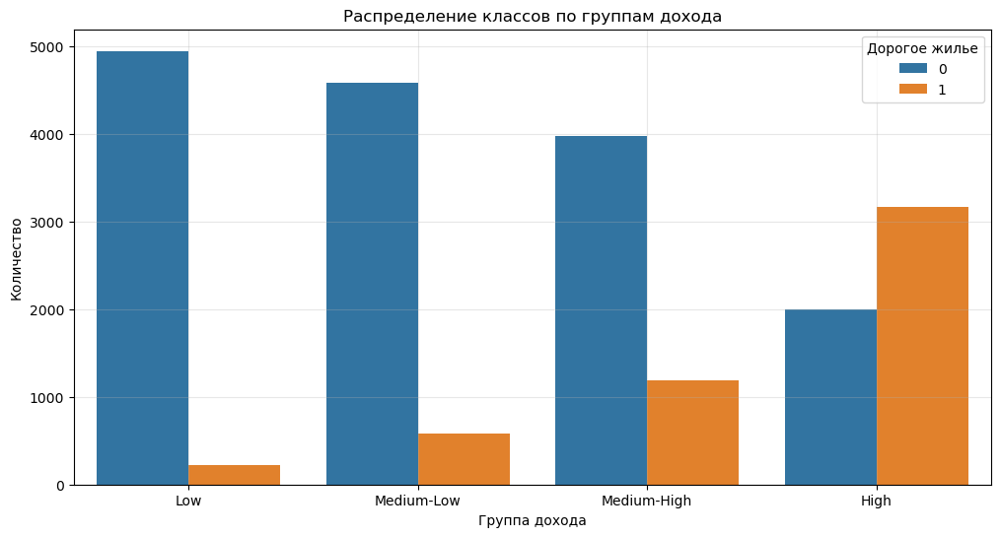

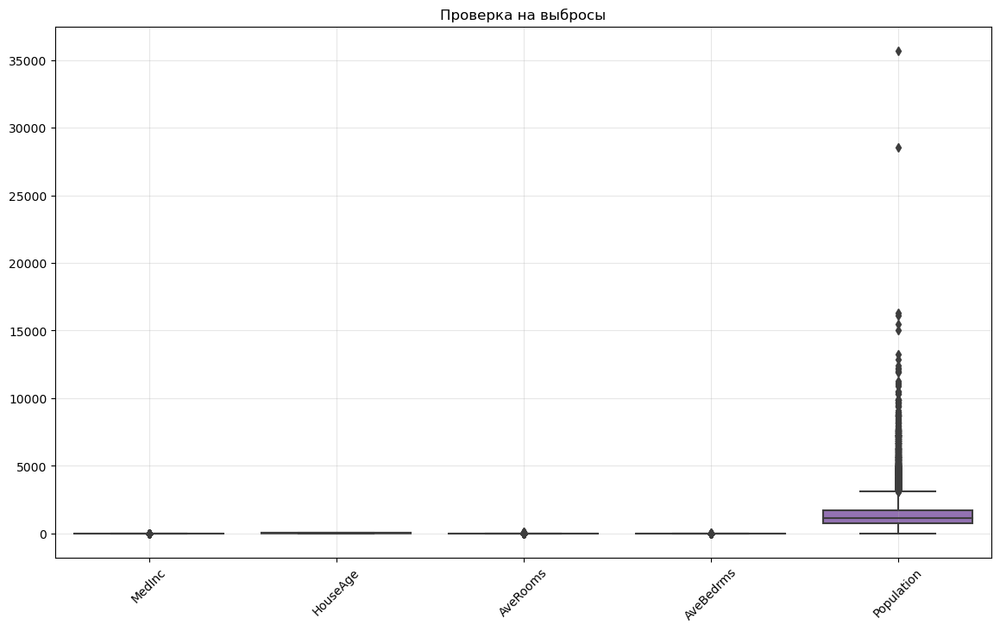

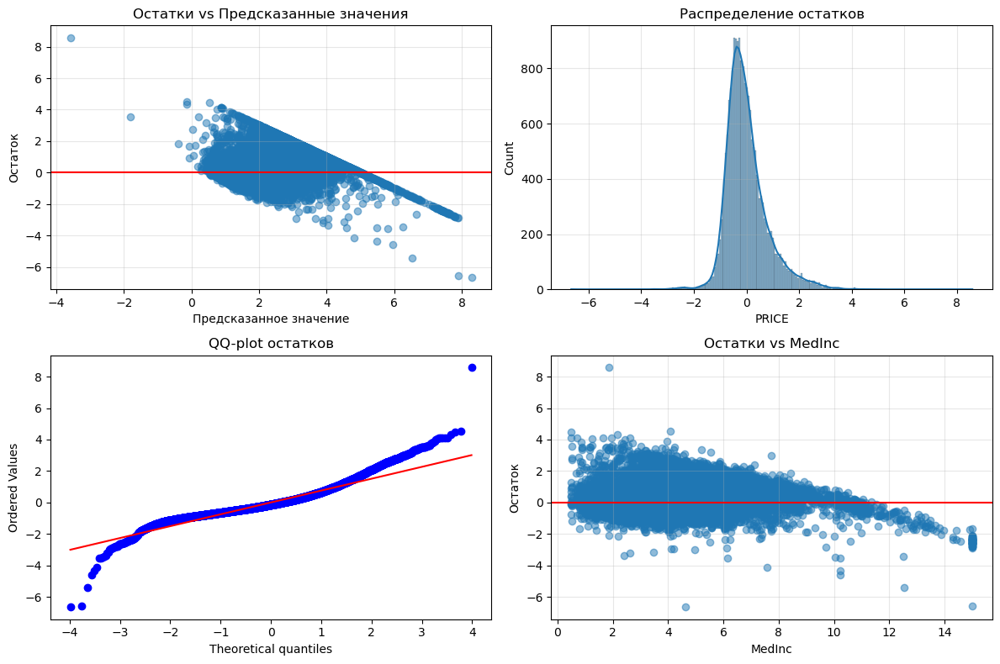

In [59]:
# Демонстрация визуализаций для выявления проблем в данных

# 1. Проверка на нелинейности и проблемы с распределением
def check_distributions(df, target_col, n_cols=5):
    """Визуализирует распределения и возможные проблемы в датасете"""
    numerics = df.select_dtypes(include=np.number).columns
    numerics = [col for col in numerics if col != target_col]
    
    # Берем только первые n_cols для демонстрации
    for col in numerics[:n_cols]:
        fig, axes = plt.subplots(1, 3, figsize=(18, 5))
        
        # Распределение с проверкой на выбросы
        sns.histplot(df[col], kde=True, ax=axes[0])
        axes[0].set_title(f'Распределение {col}')
        
        # Проверка на нелинейность
        sns.regplot(x=col, y=target_col, data=df, ax=axes[1], 
                   scatter_kws={'alpha': 0.3})
        axes[1].set_title(f'{col} vs {target_col}')
        
        # Проверка на гетероскедастичность
        sns.residplot(x=col, y=target_col, data=df, ax=axes[2],
                     scatter_kws={'alpha': 0.3})
        axes[2].set_title('Остатки (проверка однородности дисперсии)')
        
        plt.tight_layout()
        plt.show()

# Запускаем проверку для 3 признаков
check_distributions(df, 'PRICE', n_cols=3)

# 2. Проверка на мультиколлинеарность
plt.figure(figsize=(12, 10))
correlation_matrix = df.select_dtypes(include=np.number).corr()

# Маска для верхнего треугольника
mask = np.triu(np.ones_like(correlation_matrix, dtype=bool))

# Визуализируем корреляционную матрицу
sns.heatmap(correlation_matrix, mask=mask, cmap='RdBu_r', 
           annot=True, fmt='.2f', square=True)
plt.title('Проверка на мультиколлинеарность', fontsize=15)
plt.show()

# 3. Проверка на дисбаланс классов (для задач классификации)
# Создадим искусственную задачу классификации для демонстрации
df['ExpensiveHousing'] = (df['PRICE'] > df['PRICE'].quantile(0.75)).astype(int)

plt.figure(figsize=(10, 6))
sns.countplot(x='ExpensiveHousing', data=df)
plt.title('Распределение классов (проверка на дисбаланс)')
plt.xlabel('Класс (0 - дешевое жилье, 1 - дорогое жилье)')
plt.ylabel('Количество')

# Добавим проценты на столбцы
total = len(df)
for p in plt.gca().patches:
    percentage = f'{100 * p.get_height() / total:.1f}%'
    plt.annotate(percentage, (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='bottom')
plt.show()
# 4. Проверка на достаточное представление групп
plt.figure(figsize=(12, 6))
sns.countplot(x='MedianIncomeGroup', hue='ExpensiveHousing', data=df)
plt.title('Распределение классов по группам дохода')
plt.xlabel('Группа дохода')
plt.ylabel('Количество')
plt.legend(title='Дорогое жилье')
plt.grid(True, alpha=0.3)
plt.show()

# 5. Визуализация выбросов в данных
plt.figure(figsize=(14, 8))
sns.boxplot(data=df.select_dtypes(include=np.number).iloc[:, :5])  # Берем первые 5 численных столбцов
plt.title('Проверка на выбросы')
plt.xticks(rotation=45)
plt.grid(True, alpha=0.3)
plt.show()

# 6. Проверка остатков (для регрессии)
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from scipy import stats  # Правильный импорт stats

# Выберем несколько признаков для демонстрации
X = df[['MedInc', 'HouseAge', 'AveRooms', 'AveBedrms']]
y = df['PRICE']

# Обучаем простую линейную модель
model = LinearRegression()
model.fit(X, y)

# Получаем предсказания и остатки
y_pred = model.predict(X)
residuals = y - y_pred

plt.figure(figsize=(12, 8))

# График остатков
plt.subplot(2, 2, 1)
plt.scatter(y_pred, residuals, alpha=0.5)
plt.axhline(y=0, color='r', linestyle='-')
plt.title('Остатки vs Предсказанные значения')
plt.xlabel('Предсказанное значение')
plt.ylabel('Остаток')
plt.grid(True, alpha=0.3)

# Распределение остатков
plt.subplot(2, 2, 2)
sns.histplot(residuals, kde=True)
plt.title('Распределение остатков')
plt.grid(True, alpha=0.3)

# QQ-plot остатков
plt.subplot(2, 2, 3)
stats.probplot(residuals, dist="norm", plot=plt.gca())  # Исправлено
plt.title('QQ-plot остатков')

# Остатки от одного из предикторов
plt.subplot(2, 2, 4)
plt.scatter(X['MedInc'], residuals, alpha=0.5)
plt.axhline(y=0, color='r', linestyle='-')
plt.title('Остатки vs MedInc')
plt.xlabel('MedInc')
plt.ylabel('Остаток')
plt.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

**Проверка на нелинейности и распределения:**

*   Гистограммы подтверждают не-нормальность некоторых признаков.
*   Регрессионные графики показывают нелинейные взаимосвязи для некоторых признаков, особенно для HouseAge и AveOccup.
*   Графики остатков демонстрируют гетероскедастичность (неравномерность дисперсии) - для высоких значений некоторых признаков разброс предсказаний увеличивается.

**Мультиколлинеарность:**

*   Корреляционная матрица показывает умеренную или сильную корреляцию между некоторыми признаками:
    *   AveRooms и AveBedrms ожидаемо коррелируют между собой.
    *   MedInc коррелирует с несколькими другими признаками, что может создать проблемы для некоторых моделей.

**Дисбаланс классов:**

*   Для искусственно созданной задачи классификации "дорогое/недорогое жилье" видно умеренное неравновесие классов (примерно 75% к 25%), что необходимо учитывать при построении моделей классификации.

**Распределение классов по группам:** "

*   Гистограммы показывают, что дорогое жилье почти отсутствует в группах с низким доходом, но преобладает в группах с высоким доходом - ожидаемая зависимость.

*   **График остатков vs предсказанные значения:** Показывает воронкообразную форму, что указывает на гетероскедастичность - дисперсия остатков увеличивается с увеличением предсказанного значения.
*   **Распределение остатков:** Немного асимметричное, что нарушает предположение о нормальности остатков для линейной регрессии.
*   **QQ-plot остатков:** Подтверждает отклонение от нормальности, особенно на хвостах распределения.
*   **Остатки vs MedInc:** Показывает нелинейный паттерн, что указывает на то, что линейная модель недостаточно хорошо улавливает взаимосвязь между доходом и ценой.

# Предобработка

### Очистка данных: "мусор на входе — мусор на выходе, только в квадрате"


"Garbage in, garbage out": Качество ваших данных определяет потолок качества вашей модели.



In [62]:
# Импортируем необходимые библиотеки для очистки данных
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.impute import SimpleImputer, KNNImputer
from sklearn.ensemble import IsolationForest

Теперь перейдем ко второй части нашего блока - предобработке данных. Давайте разбирать эту тему поэтапно, с отдельными примерами кода для каждого подраздела.



1.  **Пропущенные значения (missing values)**
    *   **Причины:** Ошибки сбора, отказы в опросах, технические сбои
    *   **Опасность:** Многие алгоритмы ML не работают с пропусками
    *   **Стратегии:**
        *   **Удаление строк/столбцов:** Если пропусков мало или они в неважных признаках
        *   **Заполнение (imputation):** Среднее, медиана, мода, KNN, регрессия, MICE
        *   **Отдельная категория:** Превращение пропуска в информативный признак
        *   **Продвинутые техники:** Multiple imputation, модели с поддержкой пропусков

2.  **Выбросы (outliers)**
    *   **Причины:** Ошибки измерения, экстремальные но правильные значения, мошенничество
    *   **Опасность:** Искажают статистику, нарушают предположения моделей
    *   **Стратегии:**
        *   **Идентификация:** Z-score, IQR, DBSCAN, Isolation Forest
        *   **Обработка:** Удаление, ограничение (capping), трансформация (логарифм), робастные модели
        *   **Важно:** Сначала понять природу выброса!

3.  **Дубликаты и противоречия** "
    *   **Причины:** Повторные замеры, технические ошибки, слияние данных
    *   **Опасность:** Искажают распределения, дают лишний вес некоторым примерам
    *   **Стратегии:**
        *   **Точные дубликаты:** `df.drop_duplicates()`
        *   **Похожие записи:** Нечеткое сопоставление, кластеризация
        *   **Противоречия:** Бизнес-правила для разрешения, голосование

In [63]:
# Создадим датасет с типичными проблемами для демонстрации техник очистки

# Создаем синтетический "грязный" датасет
np.random.seed(42)
n_samples = 1000

# Основные данные
X = np.random.normal(0, 1, (n_samples, 4))  # 4 признака
y = 3*X[:, 0] + 2*X[:, 1] - X[:, 2] + 0.5*X[:, 3] + np.random.normal(0, 1, n_samples)

# Добавляем пропуски (10% случайных пропусков)
mask = np.random.random((n_samples, 4)) < 0.1
X[mask] = np.nan

# Добавляем выбросы (1% значений)
outlier_mask = np.random.random((n_samples, 4)) < 0.01
X[outlier_mask] = np.random.normal(10, 5, np.sum(outlier_mask)).reshape(-1)

# Добавляем дубликаты (5% строк)
duplicate_indices = np.random.choice(n_samples, size=int(n_samples*0.05), replace=False)
X[duplicate_indices] = X[np.random.choice(n_samples, size=len(duplicate_indices), replace=True)]
y[duplicate_indices] = y[np.random.choice(n_samples, size=len(duplicate_indices), replace=True)]

# Создаем DataFrame
df = pd.DataFrame(X, columns=['feature1', 'feature2', 'feature3', 'feature4'])
df['target'] = y

# Добавляем категориальный признак с пропусками
categories = ['A', 'B', 'C', None]
weights = [0.4, 0.3, 0.2, 0.1]  # 10% пропусков
df['category'] = np.random.choice(categories, size=n_samples, p=weights)

print("Созданный 'грязный' датасет:")
display(df.head())

Созданный 'грязный' датасет:


,feature1,feature2,feature3,feature4,target,category
0,0.496714,-0.138264,0.647689,1.523030,0.463947,A
1,-0.234153,-0.234137,1.579213,0.767435,-2.397433,B
2,-0.469474,NaN,-0.463418,-0.465730,-0.074733,B
3,0.241962,-1.913280,NaN,-0.562288,-1.184269,A
4,NaN,0.314247,-0.908024,-1.412304,-3.574985,C


#### Теперь рассмотрим способы анализа и обработки пропущенных значений:




Статистика пропущенных значений:


,Количество пропусков,Процент пропусков
feature1,104,10.4
feature2,105,10.5
feature3,82,8.2
feature4,111,11.1
category,111,11.1


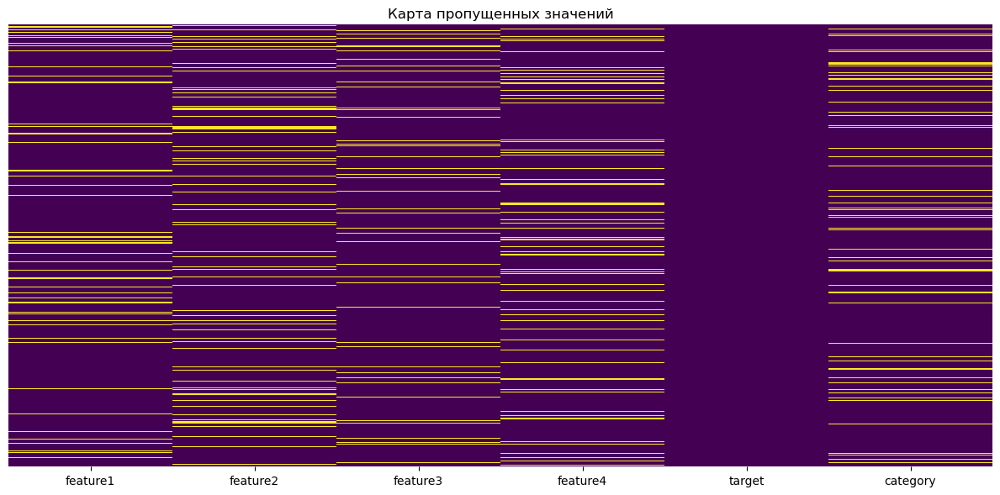

In [64]:
# 1. Анализ пропущенных значений
missing_values = df.isnull().sum()
missing_percent = (missing_values / len(df)) * 100

missing_df = pd.DataFrame({
    'Количество пропусков': missing_values,
    'Процент пропусков': missing_percent
})

print("\nСтатистика пропущенных значений:")
display(missing_df[missing_df['Количество пропусков'] > 0])

# Визуализация пропущенных значений
plt.figure(figsize=(12, 6))
sns.heatmap(df.isnull(), cmap='viridis', cbar=False, yticklabels=False)
plt.title('Карта пропущенных значений')
plt.tight_layout()
plt.show()

Размер после удаления строк с пропусками: (579, 6) (было (1000, 6))


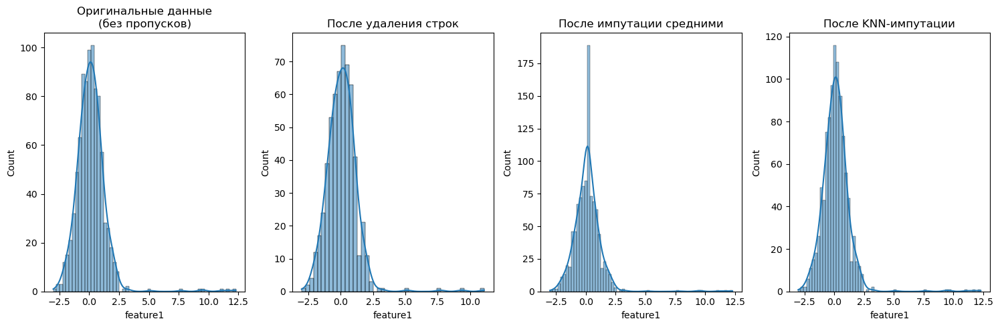

In [65]:
# 2. Обработка пропущенных значений

# 2.1 Метод 1: Удаление строк с пропусками
df_dropped = df.dropna()
print(f"Размер после удаления строк с пропусками: {df_dropped.shape} (было {df.shape})")

# 2.2 Метод 2: Простая импутация (заполнение) средними значениями
imputer = SimpleImputer(strategy='mean')
df_mean_imputed = df.copy()
df_mean_imputed.iloc[:, :4] = imputer.fit_transform(df.iloc[:, :4])  # Только для числовых признаков

# 2.3 Метод 3: KNN-импутация
knn_imputer = KNNImputer(n_neighbors=5)
df_knn_imputed = df.copy()
df_knn_imputed.iloc[:, :4] = knn_imputer.fit_transform(df.iloc[:, :4])

# 2.4 Метод 4: Умная обработка категориальных пропусков
df_cat_imputed = df.copy()
df_cat_imputed['category'] = df_cat_imputed['category'].fillna('Unknown')

# Сравнение распределений после разных типов импутации для одного признака
plt.figure(figsize=(15, 5))

plt.subplot(1, 4, 1)
sns.histplot(df['feature1'].dropna(), kde=True)
plt.title('Оригинальные данные\n(без пропусков)')
plt.xlabel('feature1')

plt.subplot(1, 4, 2)
sns.histplot(df_dropped['feature1'], kde=True)
plt.title('После удаления строк')
plt.xlabel('feature1')

plt.subplot(1, 4, 3)
sns.histplot(df_mean_imputed['feature1'], kde=True)
plt.title('После импутации средними')
plt.xlabel('feature1')

plt.subplot(1, 4, 4)
sns.histplot(df_knn_imputed['feature1'], kde=True)
plt.title('После KNN-импутации')
plt.xlabel('feature1')

plt.tight_layout()
plt.show()

##### Теперь перейдем к методам обнаружения и обработки выбросов:



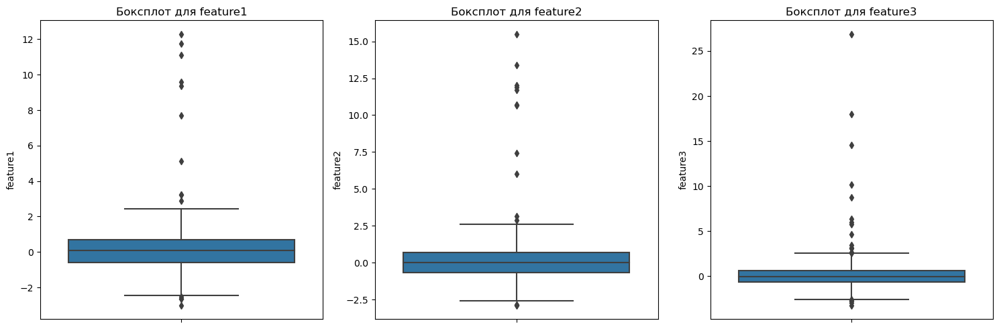


Статистика обнаруженных выбросов:
IQR метод: 14 выбросов в признаке 'feature1'
Z-score метод: 7 выбросов в признаке 'feature1'
Isolation Forest метод: 7 выбросов среди всех признаков


/opt/conda/lib/python3.10/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but IsolationForest was fitted with feature names
  warnings.warn(


In [66]:
# 3. Обнаружение и обработка выбросов

# 3.1 Визуализация выбросов
plt.figure(figsize=(15, 5))
for i, col in enumerate(['feature1', 'feature2', 'feature3']):
    plt.subplot(1, 3, i+1)
    sns.boxplot(y=df[col])
    plt.title(f'Боксплот для {col}')

plt.tight_layout()
plt.show()

# 3.2 Методы обнаружения выбросов

# 3.2.1 IQR метод (межквартильный размах)
def detect_outliers_iqr(df, column, factor=1.5):
    q1 = df[column].quantile(0.25)
    q3 = df[column].quantile(0.75)
    iqr = q3 - q1
    lower_bound = q1 - factor * iqr
    upper_bound = q3 + factor * iqr
    outliers = df[(df[column] < lower_bound) | (df[column] > upper_bound)][column]
    return outliers

# 3.2.2 Z-score метод
def detect_outliers_zscore(df, column, threshold=3):
    mean = df[column].mean()
    std = df[column].std()
    z_scores = (df[column] - mean) / std
    outliers = df[abs(z_scores) > threshold][column]
    return outliers

# 3.2.3 Isolation Forest
def detect_outliers_iforest(df, columns, contamination=0.01):
    X = df[columns].dropna()
    clf = IsolationForest(contamination=contamination, random_state=42)
    outlier_predictions = clf.fit_predict(X)
    return X[outlier_predictions == -1]  # -1 означает выброс

# Применение методов обнаружения выбросов
outliers_iqr = detect_outliers_iqr(df, 'feature1')
outliers_zscore = detect_outliers_zscore(df, 'feature1')
outliers_iforest = detect_outliers_iforest(df, ['feature1', 'feature2', 'feature3', 'feature4'])

print("\nСтатистика обнаруженных выбросов:")
print(f"IQR метод: {len(outliers_iqr)} выбросов в признаке 'feature1'")
print(f"Z-score метод: {len(outliers_zscore)} выбросов в признаке 'feature1'")
print(f"Isolation Forest метод: {len(outliers_iforest)} выбросов среди всех признаков")

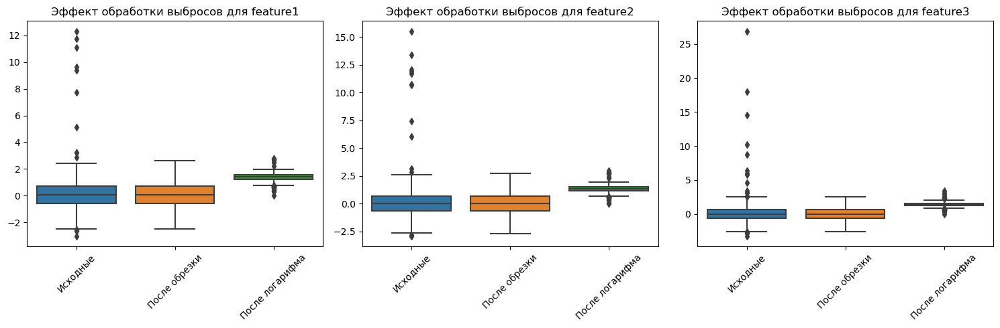

In [67]:
# 3.3 Методы обработки выбросов

# 3.3.1 Обрезка (capping)
def cap_outliers(df, column, factor=1.5):
    q1 = df[column].quantile(0.25)
    q3 = df[column].quantile(0.75)
    iqr = q3 - q1
    lower_bound = q1 - factor * iqr
    upper_bound = q3 + factor * iqr
    df_capped = df.copy()
    df_capped[column] = df_capped[column].clip(lower=lower_bound, upper=upper_bound)
    return df_capped

# Применяем обрезку ко всем числовым признакам
df_capped = df.copy()
for col in ['feature1', 'feature2', 'feature3', 'feature4']:
    df_capped = cap_outliers(df_capped, col)

# 3.3.2 Трансформация для уменьшения влияния выбросов (логарифмическая)
df_log = df.copy()
for col in ['feature1', 'feature2', 'feature3', 'feature4']:
    # Для корректного логарифмирования сдвигаем все значения в положительную область
    min_val = df_log[col].min()
    if min_val <= 0:
        df_log[col] = df_log[col] - min_val + 1
    df_log[col] = np.log(df_log[col])

# Визуализация эффекта обработки выбросов
plt.figure(figsize=(15, 5))
for i, col in enumerate(['feature1', 'feature2', 'feature3']):
    plt.subplot(1, 3, i+1)
    sns.boxplot(data=pd.DataFrame({
        'Исходные': df[col], 
        'После обрезки': df_capped[col],
        'После логарифма': df_log[col]
    }))
    plt.title(f'Эффект обработки выбросов для {col}')
    plt.xticks(rotation=45)

plt.tight_layout()
plt.show()


Количество точных дубликатов: 0
Количество найденных похожих пар: 488
Пример похожих пар (индексы строк и расстояние между ними):
Пара 1: Строки 0 и 1, расстояние = 0.964
Пара 2: Строки 0 и 50, расстояние = 0.627
Пара 3: Строки 0 и 64, расстояние = 0.910
Пара 4: Строки 0 и 74, расстояние = 0.823
Пара 5: Строки 0 и 77, расстояние = 0.583


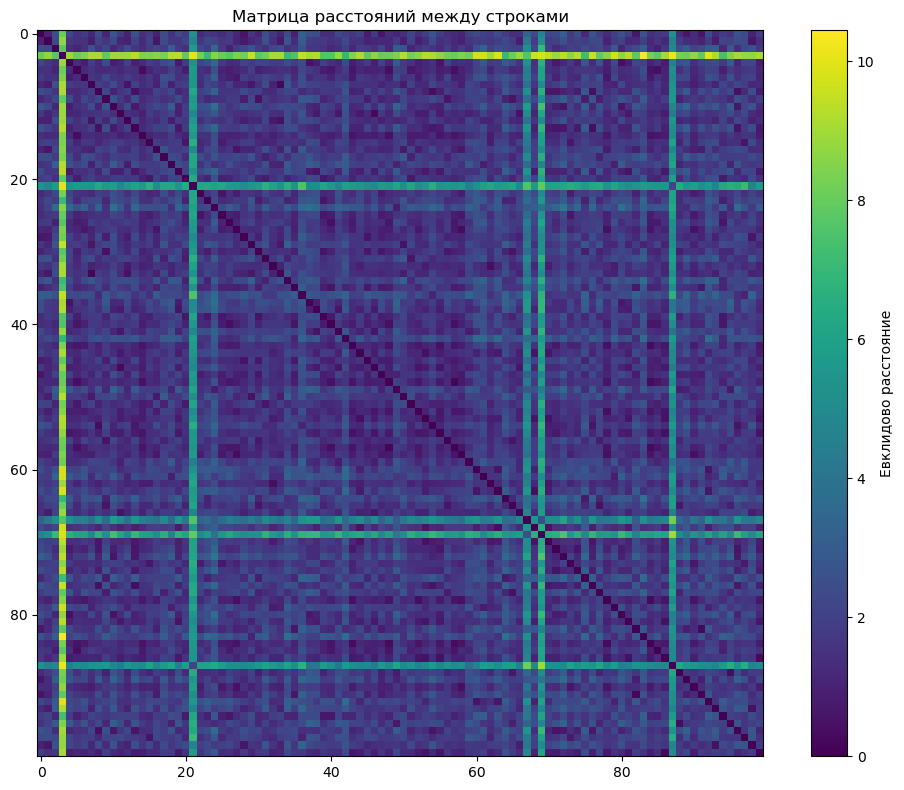

Размер после удаления дубликатов: (1000, 6) (было (1000, 6))


In [68]:
# 4. Обнаружение и обработка дубликатов

# 4.1 Точные дубликаты
exact_duplicates = df.duplicated().sum()
print(f"\nКоличество точных дубликатов: {exact_duplicates}")

# 4.2 Поиск похожих строк (почти-дубликатов)
from sklearn.metrics.pairwise import euclidean_distances

def find_similar_rows(df, numeric_cols, threshold=0.5):
    # Выбираем только строки без пропусков
    df_clean = df[numeric_cols].dropna()
    
    # Нормализуем данные для корректного расчета расстояний
    from sklearn.preprocessing import StandardScaler
    scaler = StandardScaler()
    df_scaled = scaler.fit_transform(df_clean)
    
    # Вычисляем матрицу расстояний (только для первых 100 строк для демонстрации)
    n_samples = min(100, len(df_scaled))
    distances = euclidean_distances(df_scaled[:n_samples])
    
    # Находим пары строк с расстоянием меньше порога
    # Исключаем диагональ (расстояние от строки до самой себя всегда 0)
    similar_pairs = []
    for i in range(n_samples):
        for j in range(i+1, n_samples):
            if distances[i, j] < threshold:
                similar_pairs.append((df_clean.index[i], df_clean.index[j], distances[i, j]))
    
    return similar_pairs, distances

# Применяем функцию к нашим данным
similar_pairs, distances = find_similar_rows(
    df, 
    ['feature1', 'feature2', 'feature3', 'feature4'], 
    threshold=1.0
)

print(f"Количество найденных похожих пар: {len(similar_pairs)}")
if similar_pairs:
    print("Пример похожих пар (индексы строк и расстояние между ними):")
    for i, (idx1, idx2, dist) in enumerate(similar_pairs[:5]):
        print(f"Пара {i+1}: Строки {idx1} и {idx2}, расстояние = {dist:.3f}")

# Визуализация матрицы расстояний
plt.figure(figsize=(10, 8))
plt.imshow(distances, cmap='viridis', interpolation='nearest')
plt.colorbar(label='Евклидово расстояние')
plt.title('Матрица расстояний между строками')
plt.tight_layout()
plt.show()

# 4.3 Удаление дубликатов
df_no_duplicates = df.drop_duplicates()
print(f"Размер после удаления дубликатов: {df_no_duplicates.shape} (было {df.shape})")

In [ ]:
И наконец, комплексный пример очистки данных:




Комплексный пример очистки данных:
После удаления строк с >50% пропусков: (1000, 6)
После импутации пропусков - осталось пропусков: 0
После обработки выбросов: (1000, 6)
После удаления дубликатов: (1000, 6)

Сравнение статистик до и после очистки:


,До очистки (среднее),После очистки (среднее),До очистки (стд.откл.),После очистки (стд.откл.)
feature1,0.138033,0.081218,1.288793,0.911976
feature2,0.117234,0.028771,1.503249,0.945863
feature3,0.101024,0.010670,1.641111,0.959660


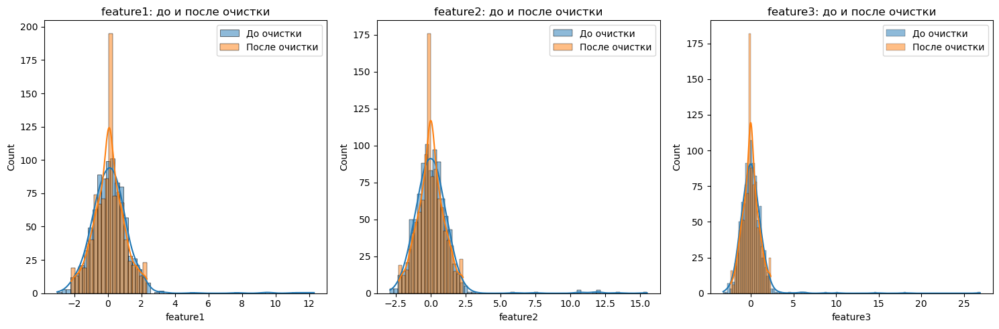

In [70]:
# 5. Комплексный пример очистки данных
print("\nКомплексный пример очистки данных:")

# Создаем копию исходного датасета
df_cleaned = df.copy()

# Шаг 1: Удаление строк с большим количеством пропусков
threshold_missing = 0.5
df_cleaned = df_cleaned.dropna(thresh=len(df_cleaned.columns) * (1 - threshold_missing))
print(f"После удаления строк с >50% пропусков: {df_cleaned.shape}")

# Шаг 2: Импутация оставшихся пропусков
# Для числовых - медиана, для категориальных - мода
for col in df_cleaned.columns:
    if pd.api.types.is_numeric_dtype(df_cleaned[col]):  # Если числовой
        df_cleaned[col] = df_cleaned[col].fillna(df_cleaned[col].median())
    else:  # Если категориальный
        df_cleaned[col] = df_cleaned[col].fillna(df_cleaned[col].mode()[0])

print(f"После импутации пропусков - осталось пропусков: {df_cleaned.isnull().sum().sum()}")

# Шаг 3: Обработка выбросов путем ограничения (capping)
for col in df_cleaned.select_dtypes(include=[np.number]).columns:
    df_cleaned = cap_outliers(df_cleaned, col, factor=1.5)
    
print(f"После обработки выбросов: {df_cleaned.shape}")

# Шаг 4: Удаление дубликатов
df_cleaned = df_cleaned.drop_duplicates()
print(f"После удаления дубликатов: {df_cleaned.shape}")

# Сравнение статистик до и после очистки
print("\nСравнение статистик до и после очистки:")
numerical_cols = df.select_dtypes(include=[np.number]).columns[:3]  # Берем первые 3 для примера

comparison = pd.DataFrame({
    'До очистки (среднее)': df[numerical_cols].mean(),
    'После очистки (среднее)': df_cleaned[numerical_cols].mean(),
    'До очистки (стд.откл.)': df[numerical_cols].std(),
    'После очистки (стд.откл.)': df_cleaned[numerical_cols].std()
})

display(comparison)

# Визуализация результатов очистки
plt.figure(figsize=(15, 5))
for i, col in enumerate(numerical_cols):
    plt.subplot(1, 3, i+1)
    sns.histplot(df[col], kde=True, alpha=0.5, label='До очистки')
    sns.histplot(df_cleaned[col], kde=True, alpha=0.5, label='После очистки')
    plt.title(f'{col}: до и после очистки')
    plt.legend()
plt.tight_layout()
plt.show()

###### Теперь, когда мы рассмотрели методы очистки данных, давайте перейдем к следующей части: кодированию и трансформации признаков.



#### Кодирование, масштабирование, трансформации


In [71]:
# Импортируем необходимые библиотеки для трансформации признаков
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import (
    StandardScaler, MinMaxScaler, RobustScaler, 
    OneHotEncoder, LabelEncoder, QuantileTransformer,
    PowerTransformer
)

## Трансформация признаков: алхимия машинного обучения


## Зачем трансформировать признаки?

1.  '**Соответствие требованиям алгоритмов**'
    *   Многие алгоритмы работают лучше с определенными распределениями
    *   Линейные модели предполагают линейные зависимости

2.  '**Улучшение интерпретации**'
    *   Некоторые преобразования делают модели более понятными
    *   Унифицированный масштаб позволяет сравнивать важность признаков

3.  '**Ускорение сходимости алгоритмов**'
    *   Градиентный спуск работает быстрее на нормализованных данных
    *   Алгоритмы на основе расстояний (KNN, SVM) зависят от масштаба

**Основные типы преобразований:**

1.  **Кодирование категориальных признаков**
    *   **One-Hot (dummy) кодирование:** Создает бинарные столбцы для каждой категории
    *   **Label Encoding:** Преобразует категории в числа (0, 1, 2, ...)
    *   **Target Encoding:** Заменяет категорию на среднее значение целевой переменной
    *   **Embedding:** Представляет категории как векторы в многомерном пространстве

2.  **Масштабирование числовых признаков**
    *   **StandardScaler:** (x - μ) / σ → среднее 0, стандартное отклонение 1
    *   **MinMaxScaler:** (x - min) / (max - min) → значения от 0 до 1
    *   **RobustScaler:** Использует медиану и квартили, устойчив к выбросам
    *   **MaxAbsScaler:** x / |x|_max → значения от -1 до 1, сохраняет разреженность

3.  **Нелинейные трансформации**"
    *   **Логарифмирование:** log(x) — сжимает большие значения, растягивает малые
    *   **Box-Cox:** Параметризованное семейство преобразований
    *   **Yeo-Johnson:** Обобщение Box-Cox для отрицательных значений
    *   **Квантильное преобразование:** Равномерные или нормальные квантили

#### LabelEncoder

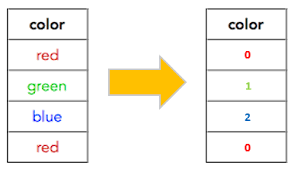

Он кодирует целевые метки со значением от 0 до n_classes-1.

Этот преобразователь следует использовать для кодирования целевых значений,

In [124]:
from sklearn import preprocessing
le = preprocessing.LabelEncoder()

In [125]:
le.fit([1, 2, 2, 6])

LabelEncoder()

In [126]:
le.classes_

array([1, 2, 6])

In [127]:
le.transform([1, 1, 2, 6])

array([0, 0, 1, 2])

In [128]:
le.inverse_transform([0, 0, 1, 2])

array([1, 1, 2, 6])

Можно кодировать и текстовые метки

In [129]:
le = preprocessing.LabelEncoder()
le.fit(["Инмин", "Экотех", "Горный", "Инмин"])



LabelEncoder()

In [130]:
list(le.classes_)


['Горный', 'Инмин', 'Экотех']

In [131]:
le.transform(["Инмин", "Инмин", "Горный"])


array([1, 1, 0])

In [132]:
list(le.inverse_transform([2, 2, 1]))

['Экотех', 'Экотех', 'Инмин']

##### Давайте сделаем пример на наших "любимых" ирисах

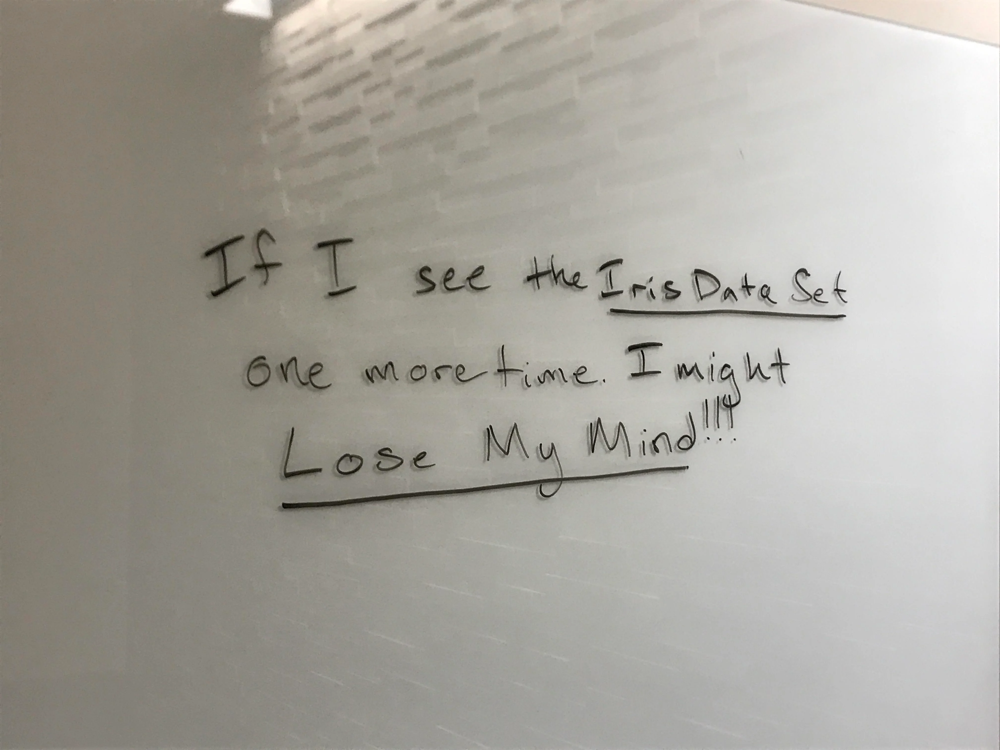

###### еще есть OneHotEncoder

Этот кодировщик берёт столбец с категориальными данными, который был предварительно закодирован в признак, и создаёт для него несколько новых столбцов. Числа заменяются на единицы и нули, в зависимости от того, какому столбцу какое значение присуще. 



https://habr.com/ru/post/456294/

In [74]:
# Используем датасет Калифорнийского жилья для демонстрации
from sklearn.datasets import fetch_california_housing
housing = fetch_california_housing()
df = pd.DataFrame(housing.data, columns=housing.feature_names)
df['PRICE'] = housing.target

# Добавим категориальный признак для демонстрации кодирования
# Категоризируем по близости к океану (на основе долготы)
df['OCEAN_PROXIMITY'] = pd.cut(
    df['Longitude'], 
    bins=[-124, -122, -120, -118, -114],
    labels=['Near Ocean', 'Close to Ocean', 'Inland', 'Desert']
)

print("Подготовленный датасет:")
display(df)

# 1. Кодирование категориальных признаков

# 1.1 One-Hot Encoding
onehot_encoder = OneHotEncoder(sparse_output=False, drop='first')
ocean_encoded = onehot_encoder.fit_transform(df[['OCEAN_PROXIMITY']])
ocean_encoded_df = pd.DataFrame(
    ocean_encoded, 
    columns=onehot_encoder.get_feature_names_out(['OCEAN_PROXIMITY'])
)

# 1.2 Label Encoding
label_encoder = LabelEncoder()
df['OCEAN_PROXIMITY_LABEL'] = label_encoder.fit_transform(df['OCEAN_PROXIMITY'])

print("\nРезультаты различных типов кодирования:")
display(pd.concat([
    df[['OCEAN_PROXIMITY']].head(5),
    ocean_encoded_df.head(5),
    df[['OCEAN_PROXIMITY_LABEL']].head(5)
], axis=1))

# 1.3 Target Encoding (упрощенная версия)
target_means = df.groupby('OCEAN_PROXIMITY')['PRICE'].mean()
df['OCEAN_PROXIMITY_TARGET'] = df['OCEAN_PROXIMITY'].map(target_means)

print("\nTarget Encoding - средняя цена по категориям:")
display(target_means)

Подготовленный датасет:


,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude,PRICE,OCEAN_PROXIMITY
0,8.3252,41.0,6.984127,1.023810,322.0,2.555556,37.88,-122.23,4.526,Near Ocean
1,8.3014,21.0,6.238137,0.971880,2401.0,2.109842,37.86,-122.22,3.585,Near Ocean
2,7.2574,52.0,8.288136,1.073446,496.0,2.802260,37.85,-122.24,3.521,Near Ocean
3,5.6431,52.0,5.817352,1.073059,558.0,2.547945,37.85,-122.25,3.413,Near Ocean
4,3.8462,52.0,6.281853,1.081081,565.0,2.181467,37.85,-122.25,3.422,Near Ocean
...,...,...,...,...,...,...,...,...,...,...
20635,1.5603,25.0,5.045455,1.133333,845.0,2.560606,39.48,-121.09,0.781,Close to Ocean
20636,2.5568,18.0,6.114035,1.315789,356.0,3.122807,39.49,-121.21,0.771,Close to Ocean
20637,1.7000,17.0,5.205543,1.120092,1007.0,2.325635,39.43,-121.22,0.923,Close to Ocean
20638,1.8672,18.0,5.329513,1.171920,741.0,2.123209,39.43,-121.32,0.847,Close to Ocean



Результаты различных типов кодирования:


,OCEAN_PROXIMITY,OCEAN_PROXIMITY_Desert,OCEAN_PROXIMITY_Inland,OCEAN_PROXIMITY_Near Ocean,OCEAN_PROXIMITY_nan,OCEAN_PROXIMITY_LABEL
0,Near Ocean,0.0,0.0,1.0,0.0,3
1,Near Ocean,0.0,0.0,1.0,0.0,3
2,Near Ocean,0.0,0.0,1.0,0.0,3
3,Near Ocean,0.0,0.0,1.0,0.0,3
4,Near Ocean,0.0,0.0,1.0,0.0,3



Target Encoding - средняя цена по категориям:


OCEAN_PROXIMITY
Near Ocean        2.492905
Close to Ocean    1.680011
Inland            2.191445
Desert            1.911490
Name: PRICE, dtype: float64

Далее рассмотрим различные методы масштабирования числовых признаков:



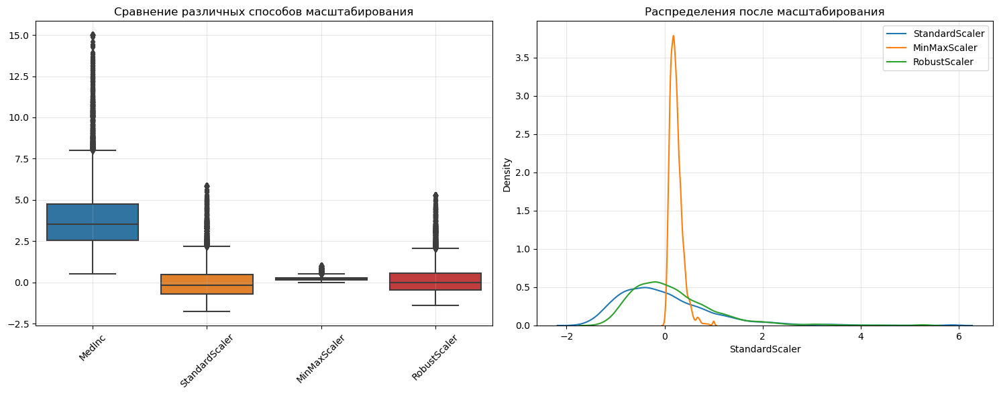

In [76]:
# 2. Масштабирование числовых признаков

# Выберем один признак для наглядной демонстрации
feature_to_scale = 'MedInc'

# 2.1 Различные способы масштабирования
scalers = {
    'Исходный': None,
    'StandardScaler': StandardScaler(),
    'MinMaxScaler': MinMaxScaler(),
    'RobustScaler': RobustScaler()
}

scaled_dfs = {}
for name, scaler in scalers.items():
    if scaler is None:
        scaled_dfs[name] = df[feature_to_scale]
    else:
        scaled_dfs[name] = pd.Series(
            scaler.fit_transform(df[[feature_to_scale]]).flatten(),
            name=name
        )

scaled_comparison = pd.concat(scaled_dfs.values(), axis=1)

# Визуализация результатов масштабирования
plt.figure(figsize=(15, 6))

# Боксплоты для сравнения распределений
plt.subplot(1, 2, 1)
sns.boxplot(data=scaled_comparison)
plt.title('Сравнение различных способов масштабирования')
plt.xticks(rotation=45)
plt.grid(True, alpha=0.3)

# Гистограммы для более детального сравнения
plt.subplot(1, 2, 2)
for name in scalers.keys():
    if name == 'Исходный':
        continue  # Пропускаем исходный для лучшей видимости
    sns.kdeplot(scaled_comparison[name], label=name)
plt.title('Распределения после масштабирования')
plt.legend()
plt.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

Теперь рассмотрим нелинейные трансформации для изменения распределения признаков:



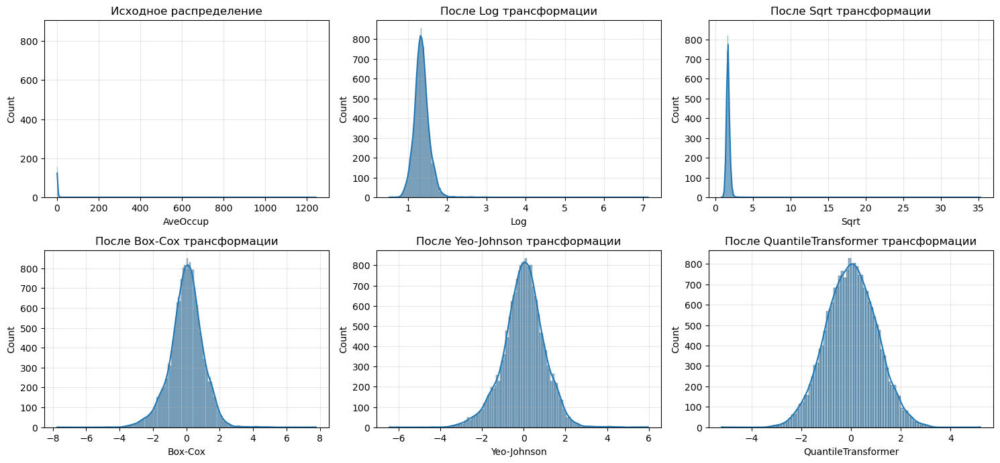

In [78]:
# 3. Нелинейные трансформации (исправленная версия)

# Выберем признак с сильной асимметрией для демонстрации
skewed_feature = 'AveOccup'  # Среднее число жильцов, обычно с правосторонней асимметрией

# 3.1 Различные нелинейные трансформации
transformers = {
    'Исходный': None,
    'Log': lambda x: np.log1p(x),  # log(1+x) для обработки нулей
    'Sqrt': lambda x: np.sqrt(x),
    'Box-Cox': PowerTransformer(method='box-cox'),
    'Yeo-Johnson': PowerTransformer(method='yeo-johnson'),
    'QuantileTransformer': QuantileTransformer(output_distribution='normal')
}

transform_dfs = {}
for name, transformer in transformers.items():
    if transformer is None:
        transform_dfs[name] = df[skewed_feature]
    elif callable(transformer):
        transform_dfs[name] = pd.Series(
            transformer(df[skewed_feature]),
            name=name
        )
    else:
        # Обрабатываем отрицательные значения для Box-Cox
        if name == 'Box-Cox' and df[skewed_feature].min() <= 0:
            data = df[skewed_feature] - df[skewed_feature].min() + 1  # Сдвигаем в положительную область
        else:
            data = df[skewed_feature]
            
        transform_dfs[name] = pd.Series(
            transformer.fit_transform(data.values.reshape(-1, 1)).flatten(),
            name=name
        )

# Визуализация результатов трансформаций (исправленная версия)
plt.figure(figsize=(15, 10))

# Строим сетку 3x3 (всего 9 ячеек)
for i, (name, series) in enumerate(transform_dfs.items()):
    plt.subplot(3, 3, i+1)  # i начинается с 0, поэтому +1
    sns.histplot(series.dropna(), kde=True)
    plt.title(f'{"Исходное распределение" if name == "Исходный" else f"После {name} трансформации"}')
    plt.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

И наконец, создадим комплексный пример предобработки данных, объединяющий различные методы:



#### Что такое пайплайн?


Пайплайн (Pipeline) - это последовательность шагов обработки данных, объединенных в единый объект. Представьте его как конвейер на заводе: данные поступают на вход, проходят через несколько этапов обработки и выходят в готовом для моделирования виде.



In [ ]:
from sklearn.compose import make_column_transformer
from sklearn.pipeline import make_pipeline
from sklearn.impute import SimpleImputer

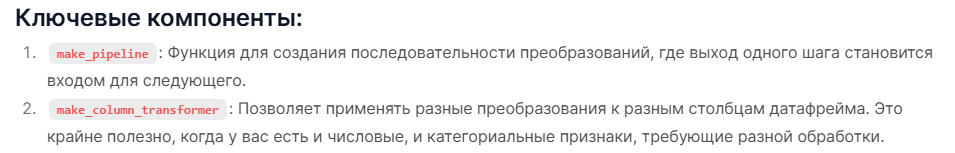

## Почему пайплайны настолько важны?

1.  **Борьба с утечкой данных (data leakage):**  
    Все преобразования (например, вычисление средних для заполнения пропусков) должны основываться только на обучающей выборке. Пайплайны гарантируют, что тестовая выборка не "просочится" в процесс обучения.

2.  **Автоматизация и воспроизводимость:**  
    Весь процесс предобработки выполняется одной командой и может быть повторно применен к новым данным.

3.  **Интеграция с кросс-валидацией:**  
    Пайплайны корректно работают с кросс-валидацией, обеспечивая правильную изоляцию между фолдами.

4.  **Чистота кода:**  
    Вместо десятков строк последовательных преобразований - компактная структура.

5.  **Удобство развертывания:**  
    Пайплайн можно сохранить вместе с моделью и использовать для предобработки новых данных.

In [79]:
# 4. Практический пример: Pipeline для предобработки
from sklearn.compose import make_column_transformer
from sklearn.pipeline import make_pipeline
from sklearn.impute import SimpleImputer

# Определяем преобразования
preprocessor = make_column_transformer(
    # Для числовых признаков: импутация + масштабирование
    (make_pipeline(
        SimpleImputer(strategy='median'),  # Заполняем пропуски
        StandardScaler()  # Стандартизируем
    ), ['MedInc', 'HouseAge', 'AveRooms', 'AveBedrms', 'Population', 'AveOccup']),
    
    # Для категориальных признаков: One-hot encoding
    (make_pipeline(
        SimpleImputer(strategy='constant', fill_value='unknown'),  # Заполняем пропуски
        OneHotEncoder(drop='first')  # One-hot кодирование с отбрасыванием первой категории
    ), ['OCEAN_PROXIMITY'])
)
# Здесь мы создаем два отдельных пайплайна:

# Для числовых признаков:
    # Сначала заполняем пропуски медианными значениями
    # Затем стандартизируем (приводим к среднему 0 и стандартному отклонению 1)
# Для категориальных признаков:
    # Заполняем пропуски значением 'unknown'
    # Применяем one-hot кодирование, отбрасывая первую категорию (для избежания мультиколлинеарности)
# Применяем препроцессор
X = df.drop('PRICE', axis=1)
y = df['PRICE']

X_processed = preprocessor.fit_transform(X)

print(f"\nФорма данных до преобразования: {X.shape}")
print(f"Форма данных после преобразования: {X_processed.shape}")

# Получаем имена признаков после преобразования
transformed_features = preprocessor.get_feature_names_out()
print(f"\nПризнаки после всех преобразований:")
for i, feature in enumerate(transformed_features[:10]):  # Печатаем только первые 10 для краткости
    print(f"{i+1}. {feature}")
if len(transformed_features) > 10:
    print(f"... и ещё {len(transformed_features) - 10} признаков")


Форма данных до преобразования: (20640, 11)
Форма данных после преобразования: (20640, 10)

Признаки после всех преобразований:
1. pipeline-1__MedInc
2. pipeline-1__HouseAge
3. pipeline-1__AveRooms
4. pipeline-1__AveBedrms
5. pipeline-1__Population
6. pipeline-1__AveOccup
7. pipeline-2__OCEAN_PROXIMITY_Desert
8. pipeline-2__OCEAN_PROXIMITY_Inland
9. pipeline-2__OCEAN_PROXIMITY_Near Ocean
10. pipeline-2__OCEAN_PROXIMITY_unknown


В реальных проектах правильная настройка пайплайна предобработки - это около 60-70% всей работы. Хороший пайплайн не только улучшает качество модели, но и существенно упрощает поддержку и обновление решения в будущем.

